In [ ]:
#load necessary libraries
import networkx as nx
import pandas as pd
import matplotlib.pyplot as plt


In [ ]:
#load aiports.csv and create a dataframe
import pandas as pd
df_airports=pd.read_csv('/content/drive/MyDrive/Data_Analytics_Assignment/Airports (2).csv',encoding='unicode_escape')

In [ ]:
#show first five records
df_airports.head()

,id,label,country,Lat,Lon
0,BIN,Bamyan,Afghanistan,34.800000,67.816667
1,BST,Lashkar Gah,Afghanistan,31.582998,64.360000
2,CCN,Chaghcharan,Afghanistan,34.516701,65.250001
3,DAZ,Darwaz,Afghanistan,38.466667,70.883333
4,FAH,Farah,Afghanistan,32.391730,62.096819


In [ ]:
#find the shape of the dataframe
df_airports.shape

(9033, 5)

In [ ]:
df_airports.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9033 entries, 0 to 9032
Data columns (total 5 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   id       9033 non-null   object 
 1   label    9033 non-null   object 
 2   country  9033 non-null   object 
 3   Lat      9033 non-null   float64
 4   Lon      9033 non-null   float64
dtypes: float64(2), object(3)
memory usage: 353.0+ KB


In [ ]:
#load flights.excel and create a flights dataframe
df_flights=pd.read_excel('/content/drive/MyDrive/Data_Analytics_Assignment/Flight Data (4).xlsx')

In [ ]:
#display first 5 records
df_flights.head()

,Source,Source City,Source Country,Target,Target City,Target Country,Weight
0,FNC,Funchal,Portugal,PXO,Porto Santo,Portugal,9864
1,PXO,Porto Santo,Portugal,FNC,Funchal,Portugal,9864
2,AEP,Buenos Aires,Argentina,MVD,Montevideo,Uruguay,1463
3,MVD,Montevideo,Uruguay,AEP,Buenos Aires,Argentina,1463
4,AEP,Buenos Aires,Argentina,ROS,Rosario (AR),Argentina,2261


In [ ]:
#shape of the data frame
df_flights.shape

(60470, 7)

In [ ]:
#dropping missing aiport data in flights dataframe
import pandas as pd

missing_nodes = ['HYL', 'BQH', 'ILE', 'MLS', 'LWT', 'TIS', 'JGC', 'HII', 'DRB', 'FHU', 'PNF', 'MOD', 'BFD', 'BLF', 'TSM', 'ALM']
df_flights = df_flights[~df_flights['Source'].isin(missing_nodes) & ~df_flights['Target'].isin(missing_nodes)]
df_flights


,Source,Source City,Source Country,Target,Target City,Target Country,Weight
0,FNC,Funchal,Portugal,PXO,Porto Santo,Portugal,9864
1,PXO,Porto Santo,Portugal,FNC,Funchal,Portugal,9864
2,AEP,Buenos Aires,Argentina,MVD,Montevideo,Uruguay,1463
3,MVD,Montevideo,Uruguay,AEP,Buenos Aires,Argentina,1463
4,AEP,Buenos Aires,Argentina,ROS,Rosario (AR),Argentina,2261
...,...,...,...,...,...,...,...
60465,PFO,Paphos,Cyprus,LCA,Larnaca,Cyprus,945
60466,ATH,Athens (GR),Greece,TIA,Tirana,Albania,128
60467,TIA,Tirana,Albania,ATH,Athens (GR),Greece,128
60468,PRN,Pristina,Yugoslavia,TIA,Tirana,Albania,208


In [ ]:
#select the following 4 country airports for graph and data analysis
selected_countries = ['United States', 'United Kingdom', 'China', 'Australia']

domestic_airports = df_airports[df_airports['country'].isin(selected_countries)]

domestic_airports


,id,label,country,Lat,Lon
216,AAB,Arrabury,Australia,-26.750000,141.000000
217,ABG,Abingdon,Australia,-17.666667,143.200000
218,ABH,Alpha,Australia,-23.700000,146.583333
219,ABM,Bamaga,Australia,-10.950833,142.459444
220,ABX,Albury,Australia,-36.060035,146.920014
...,...,...,...,...,...
8764,ZWB,Williamsburg Rail,United States,52.166667,-113.000000
8765,ZWI,Wilmington Rail,United States,34.000000,-77.900000
8766,ZWW,Newport News Rail,United States,52.166667,-99.000000
8767,ZXS,Exchangest Railway Svc,United States,42.878333,-78.875278


In [ ]:
domestic_airports.to_csv('domestic_airports.csv')

In [ ]:
#create usa_airports dataframe
USA_airports=domestic_airports[domestic_airports['country']=='United States']
USA_airports

,id,label,country,Lat,Lon
6795,0A7,Hendersonville Airport,United States,35.316667,-82.450000
6796,AAP,Andrau Airpark,United States,29.723889,-95.588333
6797,ABE,Allentown/Bethlehem/Easton,United States,40.652222,-75.440278
6798,ABI,Abilene,United States,32.416667,-99.683333
6799,ABL,Ambler,United States,67.086485,-157.851409
...,...,...,...,...,...
8764,ZWB,Williamsburg Rail,United States,52.166667,-113.000000
8765,ZWI,Wilmington Rail,United States,34.000000,-77.900000
8766,ZWW,Newport News Rail,United States,52.166667,-99.000000
8767,ZXS,Exchangest Railway Svc,United States,42.878333,-78.875278


In [ ]:
USA_airports.to_csv('us_airports.csv',index=False)

In [ ]:
#select the following 4 countries for flight data analysis
selected_countries = ['USA', 'United Kingdom', 'China', 'Australia']

domestic_flights = df_flights[
    (df_flights['Source Country'].isin(selected_countries) & df_flights['Target Country'].isin(selected_countries)) &
    (df_flights['Source Country'] == df_flights['Target Country'])
]

domestic_flights


,Source,Source City,Source Country,Target,Target City,Target Country,Weight
13,SOV,Seldovia,USA,KEB,Nanwalek,USA,144
14,HOM,Homer,USA,SOV,Seldovia,USA,184
15,SOV,Seldovia,USA,HOM,Homer,USA,40
16,PGM,Port Graham,USA,HOM,Homer,USA,144
17,KEB,Nanwalek,USA,PGM,Port Graham,USA,144
...,...,...,...,...,...,...,...
60415,OKC,Oklahoma City,USA,TUL,Tulsa,USA,2720
60416,TUL,Tulsa,USA,OKC,Oklahoma City,USA,2720
60417,ABQ,Albuquerque,USA,OKC,Oklahoma City,USA,1728
60418,OKC,Oklahoma City,USA,ABQ,Albuquerque,USA,1728


In [ ]:
domestic_flights.to_csv('domestic_flights.csv')

Total population for Australia: 13         81360
14        103960
15         22600
16         81360
17         81360
          ...   
60415    1536800
60416    1536800
60417     976320
60418     976320
60461     213570
Name: Weight, Length: 17497, dtype: int64


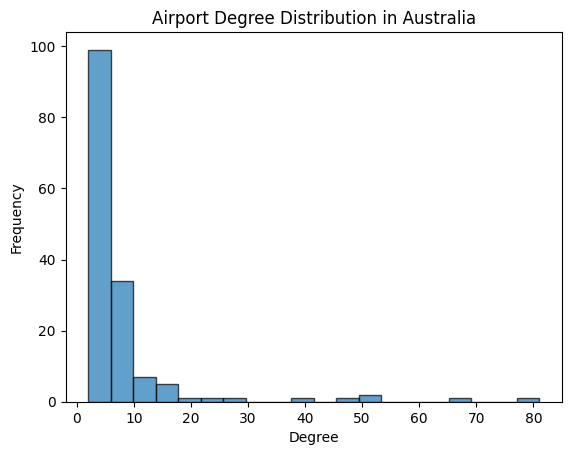

Total population for China: 13        164736
14        210496
15         45760
16        164736
17        164736
          ...   
60415    3111680
60416    3111680
60417    1976832
60418    1976832
60461     432432
Name: Weight, Length: 17497, dtype: int64


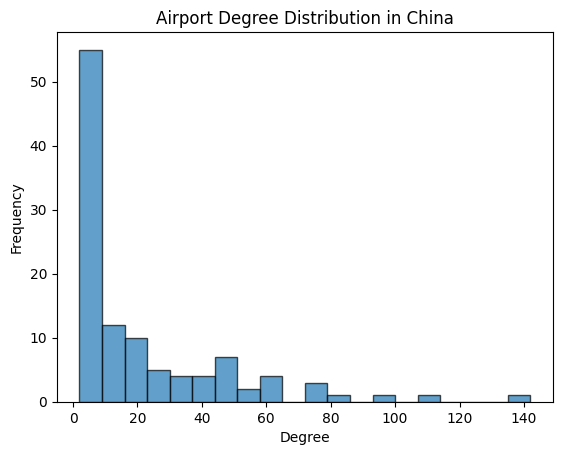

Total population for United Kingdom: 13        51264
14        65504
15        14240
16        51264
17        51264
          ...  
60415    968320
60416    968320
60417    615168
60418    615168
60461    134568
Name: Weight, Length: 17497, dtype: int64


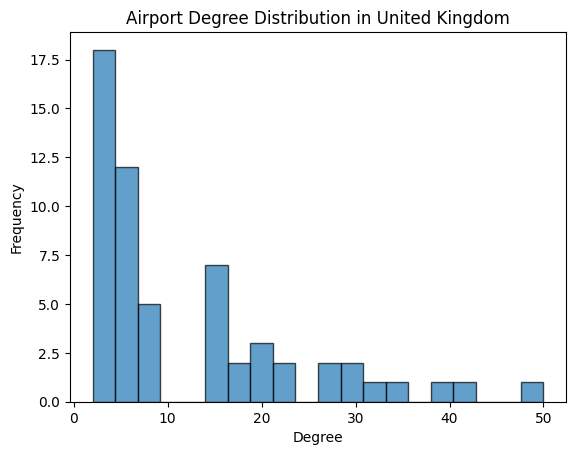

Total population for United States: 13         837648
14        1070328
15         232680
16         837648
17         837648
           ...   
60415    15822240
60416    15822240
60417    10051776
60418    10051776
60461     2198826
Name: Weight, Length: 17497, dtype: int64


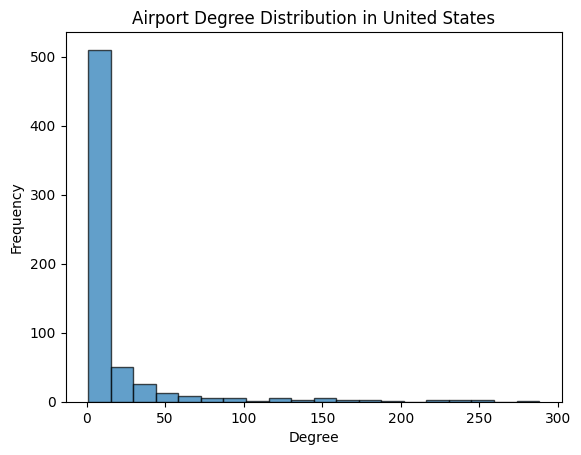

In [ ]:
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt


# Create a directed graph
G = nx.from_pandas_edgelist(domestic_flights, 'Source', 'Target', create_using=nx.DiGraph())

# Map airport IDs to countries
id_to_country = dict(zip(domestic_airports['id'], domestic_airports['country']))
nx.set_node_attributes(G, id_to_country, 'Country')

# Analyze subgraphs for each country
countries = ['Australia', 'China', 'United Kingdom', 'United States']

for country in countries:
    # Extract the subgraph for the specific country
    country_subgraph = G.subgraph([node for node, data in G.nodes(data=True) if data['Country'] == country])

    # Calculate and print population (total weights)
    total_population = sum(domestic_flights['Weight'] for source, target, weight in country_subgraph.edges(data=True))
    print(f"Total population for {country}: {total_population}")

    # Plot airport degree distribution
    degrees = dict(country_subgraph.degree())
    plt.figure()
    plt.hist(list(degrees.values()), bins=20, alpha=0.7, edgecolor='black')
    plt.title(f'Airport Degree Distribution in {country}')
    plt.xlabel('Degree')
    plt.ylabel('Frequency')
    plt.show()


In [ ]:
pip install python-louvain

<ipython-input-25-406657345398>:35: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  nx.draw(country_subgraph, pos, node_color=list(partition.values()), with_labels=True, cmap=plt.cm.get_cmap('viridis'))


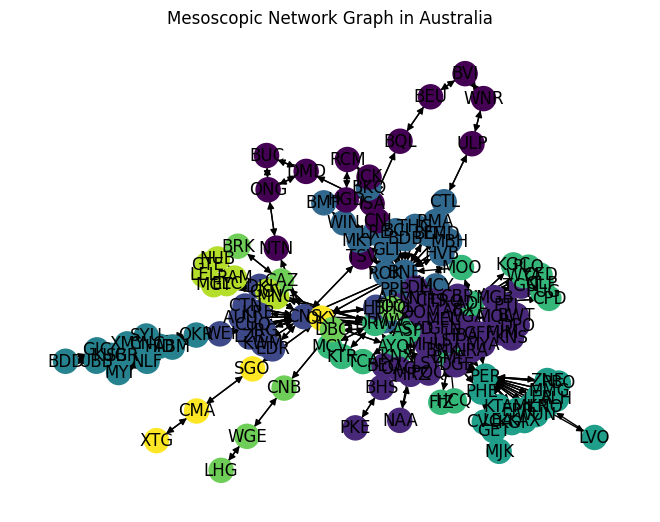

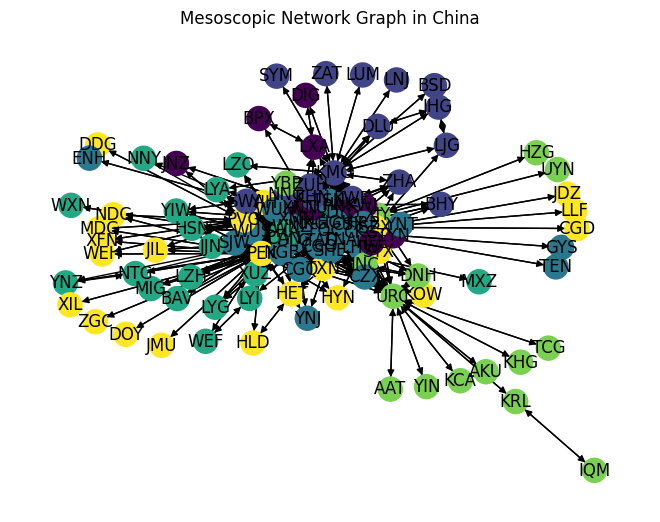

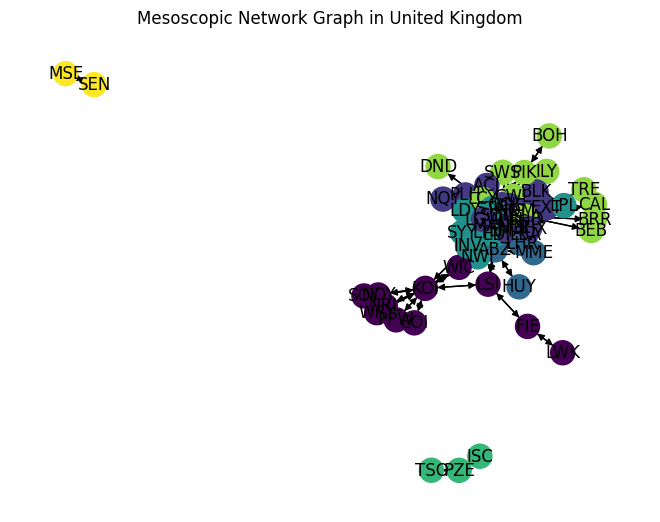

<ipython-input-25-406657345398>:35: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  nx.draw(country_subgraph, pos, node_color=list(partition.values()), with_labels=True, cmap=plt.cm.get_cmap('viridis'))


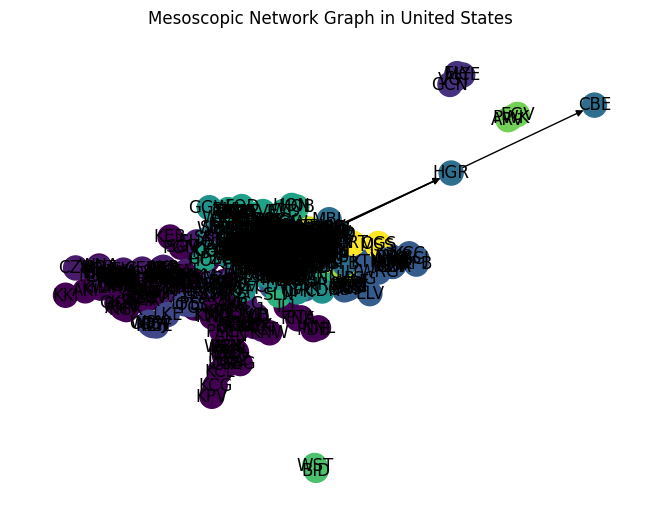

In [ ]:
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
import community  # You may need to install this library using: pip install python-louvain
import community.community_louvain



import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
import community


# Create a directed graph
G = nx.from_pandas_edgelist(domestic_flights, 'Source', 'Target', edge_attr=True, create_using=nx.DiGraph())

# Map airport IDs to countries
id_to_country = dict(zip(domestic_airports['id'], domestic_airports['country']))
nx.set_node_attributes(G, id_to_country, 'Country')

# Analyze subgraphs for each country
countries = ['Australia', 'China', 'United Kingdom', 'United States']

for country in countries:
    # Extract the subgraph for the specific country
    country_subgraph = G.subgraph([node for node, data in G.nodes(data=True) if data['Country'] == country])

    # Apply Louvain community detection algorithm
    partition = community.community_louvain.best_partition(country_subgraph.to_undirected())

    # Plot mesoscopic network graph with community colors
    pos = nx.spring_layout(country_subgraph)
    plt.figure()
    nx.draw(country_subgraph, pos, node_color=list(partition.values()), with_labels=True, cmap=plt.cm.get_cmap('viridis'))
    plt.title(f'Mesoscopic Network Graph in {country}')
    plt.show()


In [ ]:
#create usa_flights dataframe
USA_flights=domestic_flights[domestic_flights['Source Country']=='USA']

In [ ]:
#check for the correctness of domestic flight data
result_series=(USA_flights['Source Country']==USA_flights['Target Country']).all()

In [ ]:
result_series

True

In [ ]:
USA_flights[USA_flights['Source']=='ILE']

,Source,Source City,Source Country,Target,Target City,Target Country,Weight


In [ ]:
USA_flights.to_excel('us_flights.xlsx',index=False,sheet_name='Sheet1')

In [ ]:
#create usa_flights dataframe
UK_flights=domestic_flights[domestic_flights['Source Country']=='United Kingdom']

In [ ]:
#check for the correctness of domestic flight data
result_series=(UK_flights['Source Country']==UK_flights['Target Country']).all()
result_series

True

In [ ]:
missing_nodes='HYL', 'BQH', 'ILE', 'MLS', 'LWT', 'TIS', 'JGC', 'HII', 'DRB', 'FHU', 'PNF', 'MOD', 'BFD', 'BLF', 'TSM', 'ALM'
label=['Hollis','London (GB)','Killeen','Miles City','Lewistown','Thursday Island','Grand Canyon','Lake Havasu City','Derby','Fort Huachuca/Sierra Vista','Petersons Point','Modesto','Bradford','Bluefield','Taos','Alamogordo']
country=['USA','United Kingdom','USA','USA','USA','Australia','USA','USA','Australia','USA','USA','USA','USA','USA','USA','USA']

In [ ]:
domestic_flights[domestic_flights['Source']=='HYL']

,Source,Source City,Source Country,Target,Target City,Target Country,Weight


In [ ]:
for missing_node in missing_nodes:
      print(f"\nNode: {missing_node}")

      print("Flight Data:")
      print(domestic_flights[(domestic_flights['Source'] == missing_node) | (domestic_flights['Target'] == missing_node)])
      print("\nDomestic Airports Data:")
      #print(domestic_airports[domestic_airports['id'] == missing_node])



Node: HYL
Flight Data:
      Source Source City Source Country Target Target City Target Country  \
210      HYL      Hollis            USA    KLW     Klawock            USA   
211      KLW     Klawock            USA    HYL      Hollis            USA   
212      HYL      Hollis            USA    KTN   Ketchikan            USA   
213      KTN   Ketchikan            USA    HYL      Hollis            USA   
59929    HYL      Hollis            USA    KTN   Ketchikan            USA   
59930    KTN   Ketchikan            USA    HYL      Hollis            USA   
59933    KTN   Ketchikan            USA    HYL      Hollis            USA   
59948    HYL      Hollis            USA    CGA       Craig            USA   

       Weight  
210       434  
211       434  
212       434  
213       434  
59929    1200  
59930    1200  
59933     132  
59948     132  

Domestic Airports Data:

Node: BQH
Flight Data:
     Source  Source City  Source Country Target  Target City  Target Country  \
2320    B

In [ ]:
import pandas as pd
import numpy as np

# Provided data
label = ['Hollis', 'London (GB)', 'Killeen', 'Miles City', 'Lewistown', 'Thursday Island', 'Grand Canyon', 'Lake Havasu City', 'Derby', 'Fort Huachuca/Sierra Vista', 'Petersons Point', 'Modesto', 'Bradford', 'Bluefield', 'Taos', 'Alamogordo']
country = ['USA', 'United Kingdom', 'USA', 'USA', 'USA', 'Australia', 'USA', 'USA', 'Australia', 'USA', 'USA', 'USA', 'USA', 'USA', 'USA', 'USA']

# Create a DataFrame with provided data
new_airports_data = pd.DataFrame({'label': label, 'country': country})

import pandas as pd
import numpy as np

# Missing nodes data
missing_nodes = ['HYL', 'BQH', 'ILE', 'MLS', 'LWT', 'TIS', 'JGC', 'HII', 'DRB', 'FHU', 'PNF', 'MOD', 'BFD', 'BLF', 'TSM', 'ALM']
label = ['Hollis', 'London (GB)', 'Killeen', 'Miles City', 'Lewistown', 'Thursday Island', 'Grand Canyon', 'Lake Havasu City', 'Derby', 'Fort Huachuca/Sierra Vista', 'Petersons Point', 'Modesto', 'Bradford', 'Bluefield', 'Taos', 'Alamogordo']
country = ['USA', 'United Kingdom', 'USA', 'USA', 'USA', 'Australia', 'USA', 'USA', 'Australia', 'USA', 'USA', 'USA', 'USA', 'USA', 'USA', 'USA']

# Create a DataFrame for missing nodes
missing_nodes_data = pd.DataFrame({'id': missing_nodes, 'label': label, 'country': country})

# Generate latitude and longitude for missing nodes
missing_nodes_data['Lat '] = [np.random.uniform(-90, 90) for _ in range(len(missing_nodes))]
missing_nodes_data['Lon'] = [np.random.uniform(-180, 180) for _ in range(len(missing_nodes))]

# Display the DataFrame with missing nodes data
missing_nodes_data


,id,label,country,Lat,Lon
0,HYL,Hollis,USA,-21.612275,-168.691780
1,BQH,London (GB),United Kingdom,34.319470,176.194512
2,ILE,Killeen,USA,11.499852,-139.988010
3,MLS,Miles City,USA,-85.985729,149.871239
4,LWT,Lewistown,USA,-62.138387,121.402010
5,TIS,Thursday Island,Australia,-86.107995,-95.389208
6,JGC,Grand Canyon,USA,-49.843763,-81.850848
7,HII,Lake Havasu City,USA,-7.158690,-23.924412
8,DRB,Derby,Australia,24.703706,-84.977427
9,FHU,Fort Huachuca/Sierra Vista,USA,26.787365,105.709637


In [ ]:
new_domestice_airports=pd.concat([domestic_airports,missing_nodes_data],ignore_index=True)
new_domestice_airports

,id,label,country,Lat,Lon
0,AAB,Arrabury,Australia,-26.750000,141.000000
1,ABG,Abingdon,Australia,-17.666667,143.200000
2,ABH,Alpha,Australia,-23.700000,146.583333
3,ABM,Bamaga,Australia,-10.950833,142.459444
4,ABX,Albury,Australia,-36.060035,146.920014
...,...,...,...,...,...
2971,MOD,Modesto,USA,-0.442415,-36.648282
2972,BFD,Bradford,USA,16.921137,6.920453
2973,BLF,Bluefield,USA,60.269616,-134.186783
2974,TSM,Taos,USA,-42.426707,-55.202564


In [ ]:
domestic_airports

,id,label,country,Lat,Lon
216,AAB,Arrabury,Australia,-26.750000,141.000000
217,ABG,Abingdon,Australia,-17.666667,143.200000
218,ABH,Alpha,Australia,-23.700000,146.583333
219,ABM,Bamaga,Australia,-10.950833,142.459444
220,ABX,Albury,Australia,-36.060035,146.920014
...,...,...,...,...,...
8764,ZWB,Williamsburg Rail,United States,52.166667,-113.000000
8765,ZWI,Wilmington Rail,United States,34.000000,-77.900000
8766,ZWW,Newport News Rail,United States,52.166667,-99.000000
8767,ZXS,Exchangest Railway Svc,United States,42.878333,-78.875278


In [ ]:
# Create a directed graph using NetworkX
G = nx.DiGraph()

# Add airports as nodes
G.add_nodes_from(domestic_airports['id'], label=domestic_airports['label'])

# Add flights as directed edges
G.add_edges_from(zip(USA_flights['Source'], domestic_flights['Target']))


In [ ]:
G.is_directed()

True

In [ ]:
# Compute basic statistics
print("Number of Airports:", G.number_of_nodes())
print("Number of Flights:", G.number_of_edges())
print("Density of the Network:", nx.density(G))


Number of Airports: 2960
Number of Flights: 8383
Density of the Network: 0.0009571120630600185


In [ ]:
# Calculate connected components
connected_components = list(nx.strongly_connected_components(G))
largest_component = max(connected_components, key=len)
print("Number of Connected Components:", len(connected_components))
print("Size of the Largest Strongly Connected Component:", len(largest_component))


Number of Connected Components: 2424
Size of the Largest Strongly Connected Component: 537


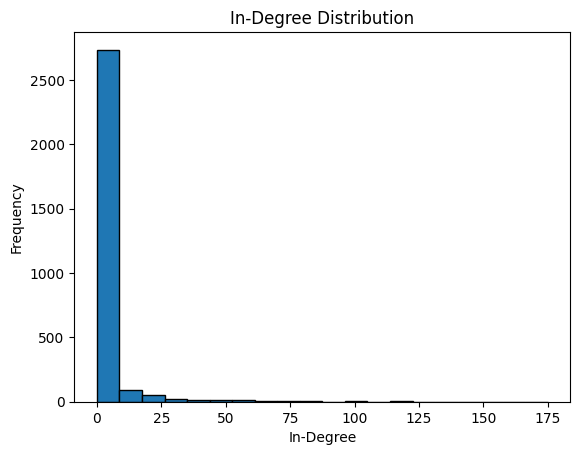

In [ ]:
# Calculate in-degree and out-degree
in_degree = dict(G.in_degree())
out_degree = dict(G.out_degree())

# Visualize node-level analysis (e.g., in-degree distribution)
plt.hist(list(in_degree.values()), bins=20, edgecolor='black')
plt.title("In-Degree Distribution")
plt.xlabel("In-Degree")
plt.ylabel("Frequency")
plt.show()


In [ ]:
domestic_airports.head()

,id,label,country,Lat,Lon
216,AAB,Arrabury,Australia,-26.750000,141.000000
217,ABG,Abingdon,Australia,-17.666667,143.200000
218,ABH,Alpha,Australia,-23.700000,146.583333
219,ABM,Bamaga,Australia,-10.950833,142.459444
220,ABX,Albury,Australia,-36.060035,146.920014


In [ ]:
domestic_airports.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2960 entries, 216 to 8768
Data columns (total 5 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   id       2960 non-null   object 
 1   label    2960 non-null   object 
 2   country  2960 non-null   object 
 3   Lat      2960 non-null   float64
 4   Lon      2960 non-null   float64
dtypes: float64(2), object(3)
memory usage: 138.8+ KB


In [ ]:
df_airports.columns

Index(['id', 'label', 'country', 'Lat ', 'Lon'], dtype='object')

In [ ]:
import networkx as nx
import geopandas as gpd
from shapely.geometry import Point, LineString
import plotly.express as px


G = nx.Graph()

# Add edges with weights
for index, row in domestic_flights.iterrows():
    G.add_edge(row['Source'], row['Target'], weight=row['Weight'])

# Add nodes with latitude, longitude, and country attributes
for index, row in domestic_airports.iterrows():
    G.add_node(row['id'], pos=(row['Lon'], row['Lat ']), country=row['country'])

# Get node positions
pos = nx.get_node_attributes(G, 'pos')

# Create GeoDataFrame for airport points
gdf_airports = gpd.GeoDataFrame(domestic_airports, geometry=gpd.points_from_xy(domestic_airports['Lon'], domestic_airports['Lat ']))

# Create GeoDataFrame for flight lines
gdf_flights = gpd.GeoDataFrame(columns=['Source', 'Target', 'geometry'])
for edge in G.edges(data=True):
    source, target, data = edge
    line = LineString([pos[source], pos[target]])
    #gdf_flights = gdf_flights.append({'Source': source, 'Target': target, 'geometry': line}, ignore_index=True)
    gdf_flights = pd.concat([gdf_flights, pd.DataFrame({'Source': [source], 'Target': [target], 'geometry': [line]})], ignore_index=True)


# Set the coordinate reference system (CRS) for GeoDataFrames
gdf_airports.crs = "EPSG:4326"
gdf_flights.crs = "EPSG:4326"

# Create an interactive map
fig = px.choropleth_mapbox(
    gdf_airports,
    geojson=gdf_airports.geometry,
    locations=gdf_airports.index,
    color=gdf_airports['country'],
    hover_name='id',
    mapbox_style="carto-positron",
    center={'lat': 0, 'lon': 0},
    zoom=1
)

# Add airport points and flight lines to the map
scatter_map = px.scatter_mapbox(
    gdf_airports,
    lat='Lat ',
    lon='Lon',
    text='id',
    hover_data=['country'],
    color_discrete_sequence=['yellow'],
    size_max=10,
    zoom=1
)

flight_lines = px.line_mapbox(
    gdf_flights,
    lat=gdf_flights.geometry.apply(lambda geom: geom.centroid.y),
    lon=gdf_flights.geometry.apply(lambda geom: geom.centroid.x),
    hover_name='Source',
    zoom=1
)

# Update map layout
scatter_map.update_traces(marker=dict(size=8))
flight_lines.update_traces(line=dict(width=0.5, color='teal'))

# Combine the maps
fig.add_trace(scatter_map.data[0])
fig.add_trace(flight_lines.data[0])

# Show the plot
fig.show()


In [ ]:
import networkx as nx
import geopandas as gpd
from shapely.geometry import Point, LineString
import plotly.express as px

# Assuming 'domestic_flights' has 'Source', 'Target', and 'Weight' columns
# Assuming 'new_domestic_airports' has 'id', 'Lat', 'Lon', and 'country' columns

# Create a directed graph
G = nx.DiGraph()

# Add edges with weights
for index, row in domestic_flights.iterrows():
    G.add_edge(row['Source'], row['Target'], weight=row['Weight'])

# Add nodes with latitude, longitude, and country attributes
for index, row in domestic_airports.iterrows():
    G.add_node(row['id'], pos=(row['Lon'], row['Lat ']), country=row['country'])

# Get node positions
pos = nx.get_node_attributes(G, 'pos')

# Create GeoDataFrame for airport points
gdf_airports = gpd.GeoDataFrame(domestic_airports, geometry=gpd.points_from_xy(domestic_airports['Lon'], domestic_airports['Lat ']))

# Create GeoDataFrame for flight lines
gdf_flights = gpd.GeoDataFrame(columns=['Source', 'Target', 'geometry'])
for edge in G.edges(data=True):
    source, target, data = edge
    line = LineString([pos[source], pos[target]])
    gdf_flights = pd.concat([gdf_flights, pd.DataFrame({'Source': [source], 'Target': [target], 'geometry': [line]})], ignore_index=True)

# Set the coordinate reference system (CRS) for GeoDataFrames
gdf_airports.crs = "EPSG:4326"
gdf_flights.crs = "EPSG:4326"

# Create an interactive map
fig = px.choropleth_mapbox(
    gdf_airports,
    geojson=gdf_airports.geometry,
    locations=gdf_airports.index,
    hover_name='id',
    color='country',
    color_discrete_map=country_colors,  # Specify color map for countries
    mapbox_style="carto-positron",
    center={'lat': 0, 'lon': 0},
    zoom=1,
)

# Add airport points and flight lines to the map
scatter_map = px.scatter_mapbox(
    gdf_airports,
    lat='Lat ',
    lon='Lon',
    text='id',
    hover_data=['country'],
    color_discrete_sequence=['black'],
    size_max=10,
    zoom=1
)

flight_lines = px.line_mapbox(
    gdf_flights,
    lat=gdf_flights.geometry.apply(lambda geom: geom.centroid.y),
    lon=gdf_flights.geometry.apply(lambda geom: geom.centroid.x),
    hover_name='Source',
    zoom=1
)

# Update map layout
scatter_map.update_traces(marker=dict(size=8))
flight_lines.update_traces(line=dict(width=0.5, color='blue'))

# Combine the maps
fig.add_trace(scatter_map.data[0])
fig.add_trace(flight_lines.data[0])

# Show the plot
fig.show()


In [ ]:
import networkx as nx
import geopandas as gpd
import plotly.express as px


# Create a directed graph
G = nx.DiGraph()

# Add edges with weights
for index, row in domestic_flights.iterrows():
    G.add_edge(row['Source'], row['Target'], weight=row['Weight'])

# Add nodes with latitude, longitude, and country attributes
for index, row in domestic_airports.iterrows():
    G.add_node(row['id'], pos=(row['Lon'], row['Lat ']), country=row['country'])

# Get node positions
pos = nx.get_node_attributes(G, 'pos')

# Create GeoDataFrame for airport points
gdf_airports = gpd.GeoDataFrame(domestic_airports, geometry=gpd.points_from_xy(domestic_airports['Lon'], domestic_airports['Lat ']))

# Create GeoDataFrame for flight lines
gdf_flights = gpd.GeoDataFrame(columns=['Source', 'Target', 'geometry'])
for edge in G.edges(data=True):
    source, target, data = edge
    line = LineString([pos[source], pos[target]])
    gdf_flights = pd.concat([gdf_flights, pd.DataFrame({'Source': [source], 'Target': [target], 'geometry': [line]})], ignore_index=True)

# Set the coordinate reference system (CRS) for GeoDataFrames
gdf_airports.crs = "EPSG:4326"
gdf_flights.crs = "EPSG:4326"

# Create an interactive map with Scattergeo
fig = px.scatter_geo(
    gdf_airports,
    lon='Lon',
    lat='Lat ',
    text='id',
    color='country',
    projection='natural earth',
    title='Airport Locations and Countries',
    opacity=0.8,
    size_max=15
)

# Add flight lines to the map
fig.add_trace(
    px.line_geo(
        gdf_flights,
        geojson='geometry',
        projection='natural earth'
    ).data[0]
)

# Show the plot
fig.show()


In [ ]:
domestic_flights

,Unnamed: 0,Source,Source City,Source Country,Target,Target City,Target Country,Weight
0,13,SOV,Seldovia,USA,KEB,Nanwalek,USA,144
1,14,HOM,Homer,USA,SOV,Seldovia,USA,184
2,15,SOV,Seldovia,USA,HOM,Homer,USA,40
3,16,PGM,Port Graham,USA,HOM,Homer,USA,144
4,17,KEB,Nanwalek,USA,PGM,Port Graham,USA,144
...,...,...,...,...,...,...,...,...
17492,60415,OKC,Oklahoma City,USA,TUL,Tulsa,USA,2720
17493,60416,TUL,Tulsa,USA,OKC,Oklahoma City,USA,2720
17494,60417,ABQ,Albuquerque,USA,OKC,Oklahoma City,USA,1728
17495,60418,OKC,Oklahoma City,USA,ABQ,Albuquerque,USA,1728


<ipython-input-36-5b257aa4cf06>:32: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.



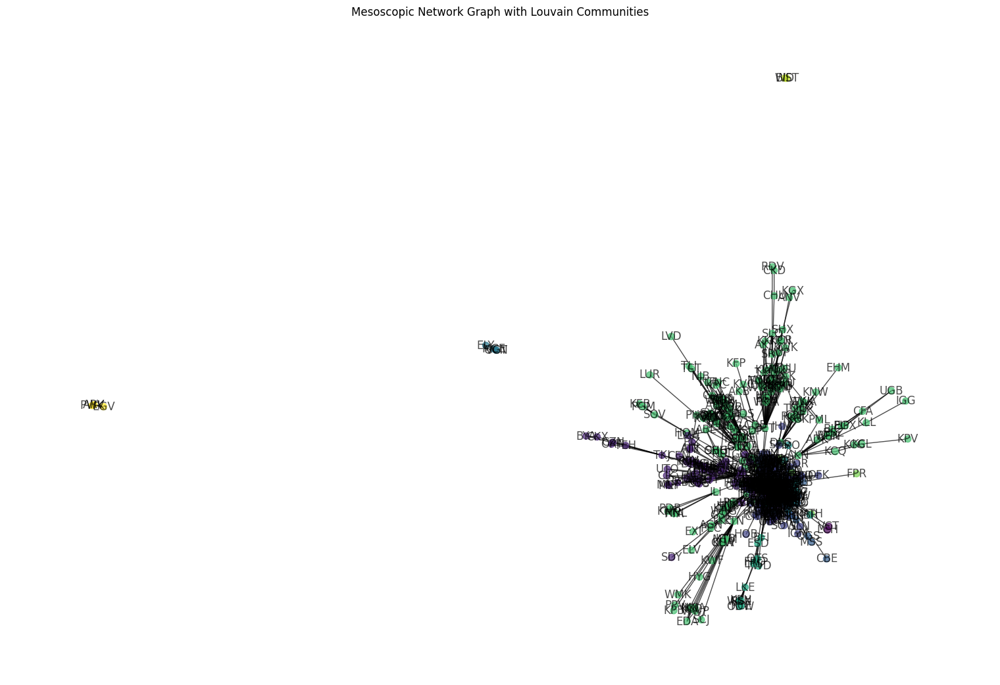

In [ ]:
import networkx as nx
import geopandas as gpd
import matplotlib.pyplot as plt
from shapely.geometry import Point, LineString
import community.community_louvain as community

# Assuming 'USA_flights' has 'Source', 'Target', and 'Weight' columns
# Assuming 'USA_airports' has 'id', 'Lat', 'Lon', and 'country' columns

# Create a directed graph
G = nx.DiGraph()

# Add edges with weights
for index, row in USA_flights.iterrows():
    G.add_edge(row['Source'], row['Target'], weight=row['Weight'])

# Convert the directed graph to an undirected graph
G_undirected = G.to_undirected()

# Add nodes with latitude, longitude, and country attributes
for index, row in USA_airports.iterrows():
    G.add_node(row['id'], pos=(row['Lon'], row['Lat ']), country=row['country'])

# Apply Louvain community detection algorithm
partition = community.best_partition(G_undirected)

# Plot mesoscopic network graph with community colors
pos = nx.spring_layout(G_undirected)
plt.figure(figsize=(15, 10))

# Draw nodes with color representing communities
nx.draw(G_undirected, pos, node_color=list(partition.values()), with_labels=True, cmap=plt.cm.get_cmap('viridis'), node_size=50, alpha=0.7)

plt.title('Mesoscopic Network Graph with Louvain Communities')
plt.show()


In [ ]:
domestic_airports.shape

(2960, 5)

In [ ]:
domestic_airports.isnull().sum()

id         0
label      0
country    0
Lat        0
Lon        0
dtype: int64

In [ ]:
df_Airport.shape

(9033, 5)

In [ ]:
df_Airport.isnull().sum()

id         0
label      0
country    0
Lat        0
Lon        0
dtype: int64

In [ ]:
df_Airport[df_Airport['country']=='United States']

,id,label,country,Lat,Lon
6795,0A7,Hendersonville Airport,United States,35.316667,-82.450000
6796,AAP,Andrau Airpark,United States,29.723889,-95.588333
6797,ABE,Allentown/Bethlehem/Easton,United States,40.652222,-75.440278
6798,ABI,Abilene,United States,32.416667,-99.683333
6799,ABL,Ambler,United States,67.086485,-157.851409
...,...,...,...,...,...
8764,ZWB,Williamsburg Rail,United States,52.166667,-113.000000
8765,ZWI,Wilmington Rail,United States,34.000000,-77.900000
8766,ZWW,Newport News Rail,United States,52.166667,-99.000000
8767,ZXS,Exchangest Railway Svc,United States,42.878333,-78.875278


In [ ]:
df_Airport[df_Airport['country']=='Australia']

,id,label,country,Lat,Lon
216,AAB,Arrabury,Australia,-26.750000,141.000000
217,ABG,Abingdon,Australia,-17.666667,143.200000
218,ABH,Alpha,Australia,-23.700000,146.583333
219,ABM,Bamaga,Australia,-10.950833,142.459444
220,ABX,Albury,Australia,-36.060035,146.920014
...,...,...,...,...,...
820,ZBL,Biloela,Australia,-24.393564,150.496075
821,ZBO,Bowen,Australia,-20.001326,148.208669
822,ZGL,South Galway,Australia,-25.683333,142.116667
823,ZNE,Newman,Australia,-23.366598,119.733301


In [ ]:
df_Flight=pd.read_excel('/content/Flight Data (1).xlsx')

In [ ]:
df_Flight.sample(30)

,Source,Source City,Source Country,Target,Target City,Target Country,Weight
29590,MAD,Madrid,Spain,IBZ,Ibiza,Spain,1404
53745,ILM,Wilmington (US) NC,USA,CLT,Charlotte,USA,18900
8499,MEX,Mexico City,Mexico,MID,Merida,Mexico,2310
56841,BLI,Bellingham,USA,ESD,Eastsound,USA,960
23791,GIG,Rio de Janeiro,Brazil,CWB,Curitiba,Brazil,7888
1717,IEV,Kiev,Ukraine,DOK,Donetsk,Ukraine,6318
14444,GYE,Guayaquil,Ecuador,PTY,Panama City (PA),Panama,2356
26902,BJV,Bodrum,Turkey,DLM,Dalaman,Turkey,736
59447,FRA,Frankfurt,Germany,TFS,Tenerife,Spain,696
45771,DEZ,Deirezzor,Syrian Arab Republic,DAM,Damascus,Syrian Arab Republic,624


,Source,Source City,Source Country,Target,Target City,Target Country,Weight
13,SOV,Seldovia,USA,KEB,Nanwalek,USA,144
14,HOM,Homer,USA,SOV,Seldovia,USA,184
15,SOV,Seldovia,USA,HOM,Homer,USA,40
16,PGM,Port Graham,USA,HOM,Homer,USA,144
17,KEB,Nanwalek,USA,PGM,Port Graham,USA,144
...,...,...,...,...,...,...,...
60415,OKC,Oklahoma City,USA,TUL,Tulsa,USA,2720
60416,TUL,Tulsa,USA,OKC,Oklahoma City,USA,2720
60417,ABQ,Albuquerque,USA,OKC,Oklahoma City,USA,1728
60418,OKC,Oklahoma City,USA,ABQ,Albuquerque,USA,1728


In [ ]:
domestic_flights[domestic_flights['Source Country']=='USA']

,Source,Source City,Source Country,Target,Target City,Target Country,Weight
13,SOV,Seldovia,USA,KEB,Nanwalek,USA,144
14,HOM,Homer,USA,SOV,Seldovia,USA,184
15,SOV,Seldovia,USA,HOM,Homer,USA,40
16,PGM,Port Graham,USA,HOM,Homer,USA,144
17,KEB,Nanwalek,USA,PGM,Port Graham,USA,144
...,...,...,...,...,...,...,...
60414,ALM,Alamogordo,USA,ABQ,Albuquerque,USA,816
60415,OKC,Oklahoma City,USA,TUL,Tulsa,USA,2720
60416,TUL,Tulsa,USA,OKC,Oklahoma City,USA,2720
60417,ABQ,Albuquerque,USA,OKC,Oklahoma City,USA,1728


In [ ]:
df_Airport[df_Airport['country']=='United States']

,id,label,country,Lat,Lon
6795,0A7,Hendersonville Airport,United States,35.316667,-82.450000
6796,AAP,Andrau Airpark,United States,29.723889,-95.588333
6797,ABE,Allentown/Bethlehem/Easton,United States,40.652222,-75.440278
6798,ABI,Abilene,United States,32.416667,-99.683333
6799,ABL,Ambler,United States,67.086485,-157.851409
...,...,...,...,...,...
8764,ZWB,Williamsburg Rail,United States,52.166667,-113.000000
8765,ZWI,Wilmington Rail,United States,34.000000,-77.900000
8766,ZWW,Newport News Rail,United States,52.166667,-99.000000
8767,ZXS,Exchangest Railway Svc,United States,42.878333,-78.875278


In [ ]:
domestic_flights[domestic_flights['Source Country']=='USA']

,Source,Source City,Source Country,Target,Target City,Target Country,Weight
13,SOV,Seldovia,USA,KEB,Nanwalek,USA,144
14,HOM,Homer,USA,SOV,Seldovia,USA,184
15,SOV,Seldovia,USA,HOM,Homer,USA,40
16,PGM,Port Graham,USA,HOM,Homer,USA,144
17,KEB,Nanwalek,USA,PGM,Port Graham,USA,144
...,...,...,...,...,...,...,...
60414,ALM,Alamogordo,USA,ABQ,Albuquerque,USA,816
60415,OKC,Oklahoma City,USA,TUL,Tulsa,USA,2720
60416,TUL,Tulsa,USA,OKC,Oklahoma City,USA,2720
60417,ABQ,Albuquerque,USA,OKC,Oklahoma City,USA,1728


In [ ]:
domestic_flights[domestic_flights['Source Country']=='China']

,Source,Source City,Source Country,Target,Target City,Target Country,Weight
7113,PEK,Beijing,China,PVG,Shanghai,China,8100
7116,PVG,Shanghai,China,PEK,Beijing,China,8370
13304,CAN,Guangzhou,China,MIG,Mianyang,China,1794
13305,CKG,Chongqing,China,DYG,Dayong,China,2484
13306,CTU,Chengdu,China,PEK,Beijing,China,15500
...,...,...,...,...,...,...,...
60200,KHN,Nanchang,China,SZX,Shenzhen,China,4352
60201,KWE,Guiyang,China,SZX,Shenzhen,China,4216
60202,SZX,Shenzhen,China,CSX,Changsha,China,7208
60203,SZX,Shenzhen,China,KHN,Nanchang,China,4352


In [ ]:
domestic_flights[domestic_flights['Source Country']=='Australia']

,Source,Source City,Source Country,Target,Target City,Target Country,Weight
8644,CNS,Cairns,Australia,OOL,Gold Coast,Australia,10569
8645,MEL,Melbourne (AU),Australia,SYD,Sydney (AU),Australia,1084
8646,OOL,Gold Coast,Australia,CNS,Cairns,Australia,8401
8647,SYD,Sydney (AU),Australia,MEL,Melbourne (AU),Australia,1084
8649,CNS,Cairns,Australia,SYD,Sydney (AU),Australia,1897
...,...,...,...,...,...,...,...
60400,ADL,Adelaide,Australia,WYA,Whyalla,Australia,828
60401,CBR,Canberra,Australia,TGN,Traralgon,Australia,972
60402,CPD,Coober Pedy,Australia,ADL,Adelaide,Australia,418
60403,TGN,Traralgon,Australia,CBR,Canberra,Australia,972


In [ ]:
domestic_airports.head()

,id,label,country,Lat,Lon
216,AAB,Arrabury,Australia,-26.750000,141.000000
217,ABG,Abingdon,Australia,-17.666667,143.200000
218,ABH,Alpha,Australia,-23.700000,146.583333
219,ABM,Bamaga,Australia,-10.950833,142.459444
220,ABX,Albury,Australia,-36.060035,146.920014


In [ ]:
domestic_airports.shape

(2960, 5)

In [ ]:
domestic_airports.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2960 entries, 0 to 2959
Data columns (total 5 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   id       2960 non-null   object 
 1   label    2960 non-null   object 
 2   country  2960 non-null   object 
 3   Lat      2960 non-null   float64
 4   Lon      2960 non-null   float64
dtypes: float64(2), object(3)
memory usage: 115.8+ KB


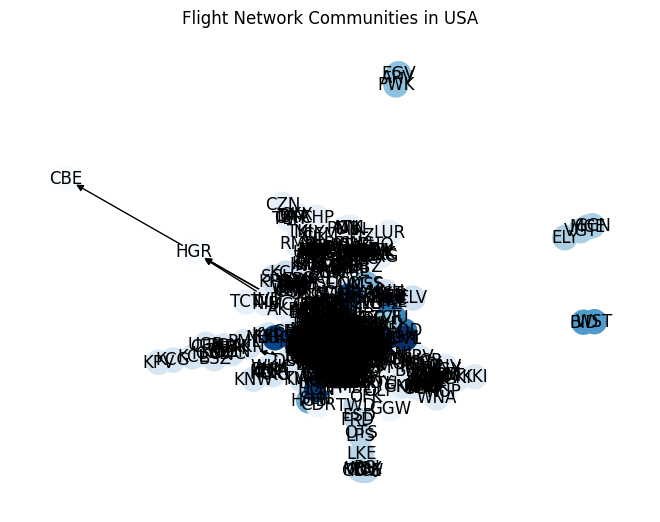

In [ ]:
import pandas as pd
import networkx as nx
import community
import matplotlib.pyplot as plt
from networkx.algorithms.community import greedy_modularity_communities


# Assuming you have two DataFrames: flight_data and airport_data

flight_data=pd.read_excel('/content/us_flights.xlsx')
airport_data=pd.read_csv('/content/us_airports.csv')


# Assuming you have two DataFrames: flight_data and airport_data

# Create a directed graph
G = nx.from_pandas_edgelist(flight_data, 'Source', 'Target', create_using=nx.DiGraph())

# Map airport ids to country
id_to_country = dict(zip(airport_data['id'], airport_data['country']))
nx.set_node_attributes(G, id_to_country, 'country')

# Extract the subgraph for the USA
G_usa = G.subgraph([node for node, data in G.nodes(data=True) if data['country'] == 'United States'])

# Perform community detection using greedy modularity
communities = list(greedy_modularity_communities(G_usa))

# Map nodes to community indices
node_to_community = {node: i for i, community in enumerate(communities) for node in community}
nx.set_node_attributes(G_usa, node_to_community, 'Community')

# Plot the graph with community colors
pos = nx.spring_layout(G_usa)  # You can use a different layout if needed
node_colors = [node_to_community[node] for node in G_usa.nodes]
nx.draw(G_usa, pos, node_color=node_colors, with_labels=True, cmap=plt.cm.Blues)
plt.title('Flight Network Communities in USA')
plt.show()


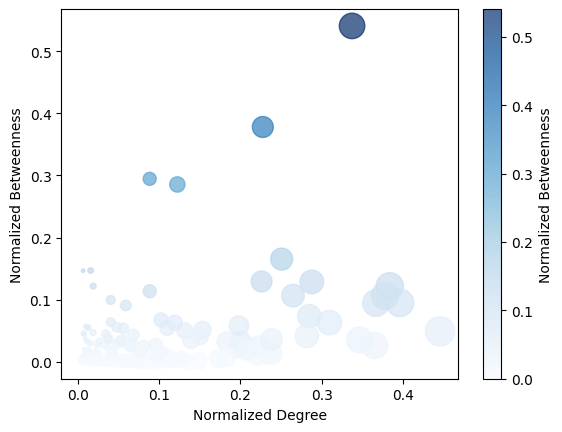

In [ ]:
import networkx as nx
import pandas as pd
import matplotlib.pyplot as plt

# Assuming 'usa_flight_data' has columns like 'Source', 'Source City', 'Source Country', 'Target', 'Target City', 'Target Country', 'Weight'

# Create a directed graph
G = nx.DiGraph()

# Add edges with weights
for index, row in USA_flights.iterrows():
    G.add_edge(row['Source'], row['Target'], weight=row['Weight'])

# Calculate normalized betweenness and normalized degree
betweenness = nx.betweenness_centrality(G, weight='weight', normalized=True)
degree = nx.degree_centrality(G)

# Create a DataFrame for node attributes
node_data = pd.DataFrame({'Node': list(G.nodes()), 'Betweenness': [betweenness[node] for node in G.nodes()], 'Degree': [degree[node] for node in G.nodes()]})

# Scatter plot with node color representing normalized betweenness and node size representing normalized degree
plt.scatter(node_data['Degree'], node_data['Betweenness'], c=node_data['Betweenness'], cmap='Blues', s=node_data['Degree'] * 1000, alpha=0.7)

# Add labels and colorbar
plt.xlabel('Normalized Degree')
plt.ylabel('Normalized Betweenness')
plt.colorbar(label='Normalized Betweenness')

# Show the plot
plt.show()


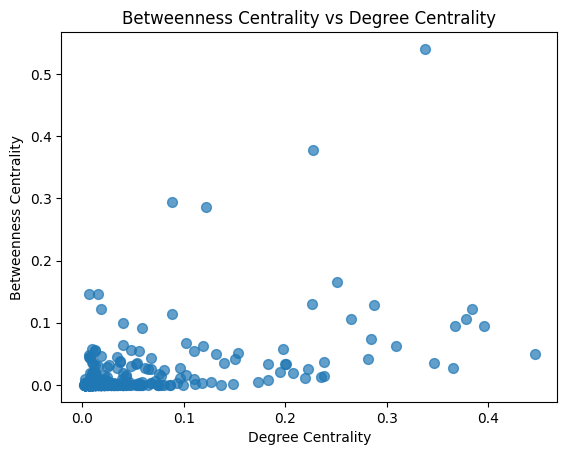

In [ ]:
import networkx as nx
import pandas as pd
import matplotlib.pyplot as plt

# Assuming 'usa_flight_data' has columns like 'Source', 'Source City', 'Source Country', 'Target', 'Target City', 'Target Country', 'Weight'

# Create a directed graph
G = nx.DiGraph()

# Add edges with weights
for index, row in USA_flights.iterrows():
    G.add_edge(row['Source'], row['Target'], weight=row['Weight'])

# Calculate betweenness centrality and degree centrality
betweenness = nx.betweenness_centrality(G, weight='weight', normalized=True)
degree = nx.degree_centrality(G)

# Create a DataFrame for node attributes
node_data = pd.DataFrame({'Node': list(G.nodes()), 'Betweenness': [betweenness[node] for node in G.nodes()], 'Degree': [degree[node] for node in G.nodes()]})

# Scatter plot with betweenness centrality against degree centrality
plt.scatter(node_data['Degree'], node_data['Betweenness'], s=50, alpha=0.7)

# Add labels
plt.xlabel('Degree Centrality')
plt.ylabel('Betweenness Centrality')
plt.title('Betweenness Centrality vs Degree Centrality')

# Show the plot
plt.show()


Correlation Coefficient: 0.5280396257652469


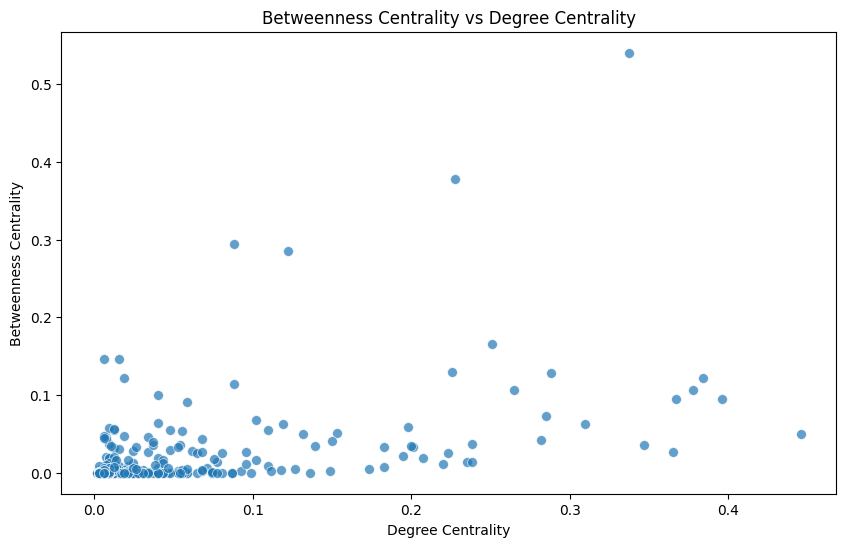

In [ ]:
import networkx as nx
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming 'USA_flights' has columns like 'Source', 'Target', 'Weight'

# Create a directed graph
G = nx.DiGraph()

# Add edges with weights
for index, row in USA_flights.iterrows():
    G.add_edge(row['Source'], row['Target'], weight=row['Weight'])

# Calculate betweenness centrality and degree centrality
betweenness = nx.betweenness_centrality(G, weight='weight')
degree = nx.degree_centrality(G)

# Create a DataFrame for node attributes
node_data = pd.DataFrame({'Node': list(G.nodes()), 'Betweenness': [betweenness[node] for node in G.nodes()], 'Degree': [degree[node] for node in G.nodes()]})

# Create a scatter plot
plt.figure(figsize=(10, 6))
sns.scatterplot(x='Degree', y='Betweenness', data=node_data, s=50, alpha=0.7)

# Add labels
plt.xlabel('Degree Centrality')
plt.ylabel('Betweenness Centrality')
plt.title('Betweenness Centrality vs Degree Centrality')

# Calculate and print the correlation coefficient
correlation_coefficient = node_data['Betweenness'].corr(node_data['Degree'])
print(f"Correlation Coefficient: {correlation_coefficient}")

# Show the plot
plt.show()


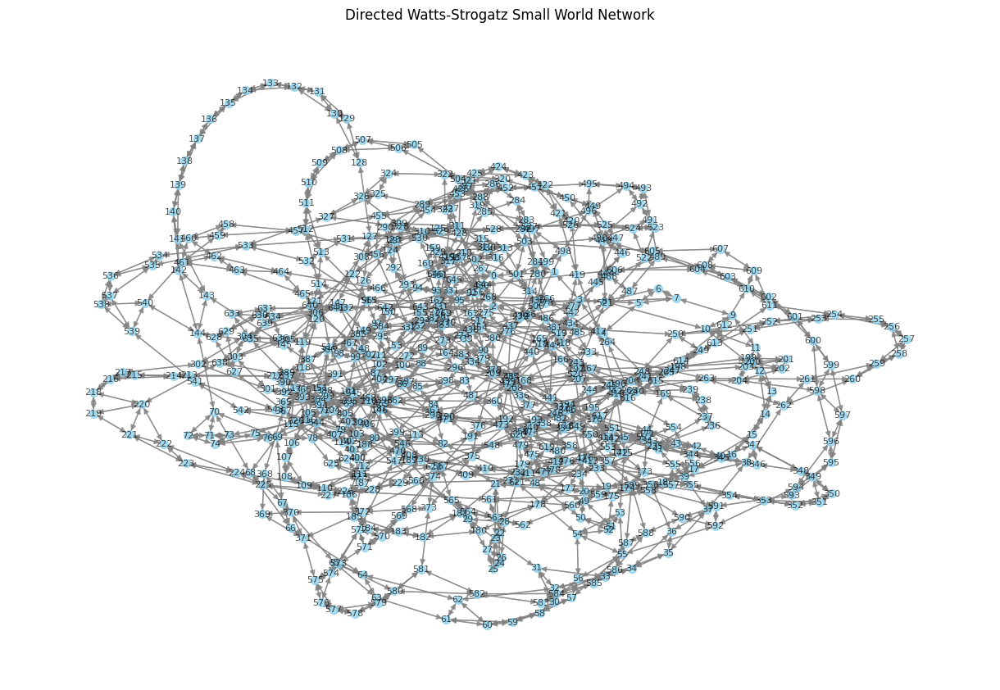

In [ ]:
import networkx as nx
import pandas as pd
import matplotlib.pyplot as plt

# Assuming 'USA_flights' has columns like 'Source', 'Target', 'Weight'

# Create an undirected graph
G_undirected = nx.Graph()

# Add edges with weights
for index, row in USA_flights.iterrows():
    G_undirected.add_edge(row['Source'], row['Target'], weight=row['Weight'])

# Calculate Watts-Strogatz small-world graph
n_nodes = len(G_undirected.nodes())
k = 4  # Average degree of initial regular graph
p = 0.1  # Probability of rewiring each edge

small_world_graph_undirected = nx.watts_strogatz_graph(n_nodes, k, p, seed=42)

# Convert the undirected graph to a directed graph
small_world_graph = small_world_graph_undirected.to_directed()

# Draw the directed small-world network
plt.figure(figsize=(12, 8))
pos = nx.spring_layout(small_world_graph)
nx.draw(small_world_graph, pos, with_labels=True, node_size=50, font_size=8, font_color='black', node_color='skyblue', edge_color='gray', alpha=0.7, arrowsize=10)

plt.title('Directed Watts-Strogatz Small World Network')
plt.show()


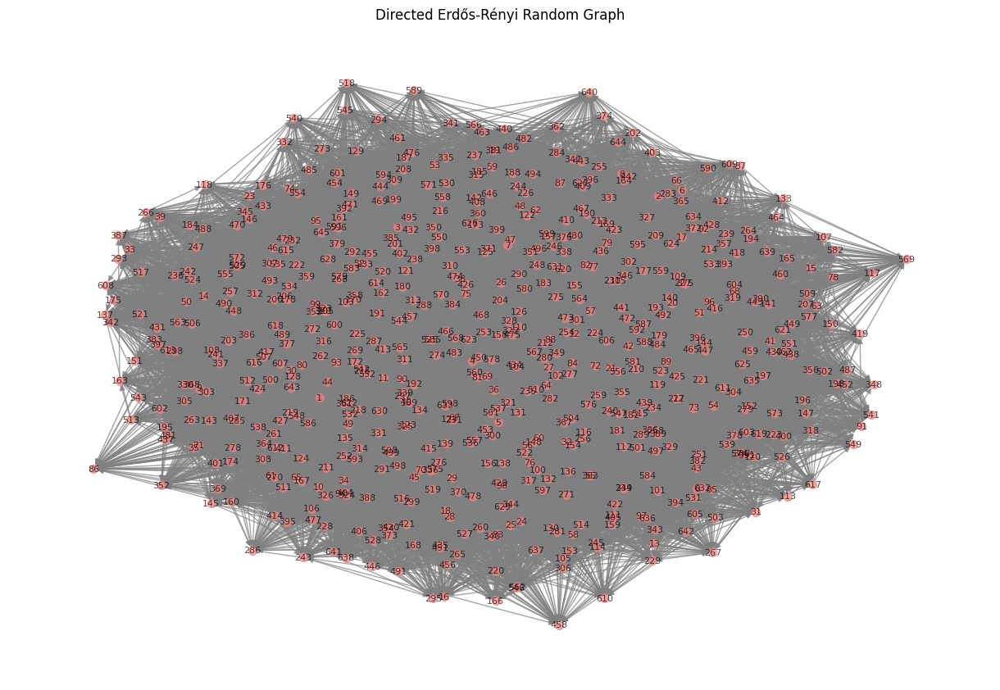

In [ ]:
import networkx as nx
import pandas as pd
import matplotlib.pyplot as plt

# Assuming 'USA_flights' has columns like 'Source', 'Target', 'Weight'

# Create a directed graph
G = nx.DiGraph()

# Add edges with weights
for index, row in USA_flights.iterrows():
    G.add_edge(row['Source'], row['Target'], weight=row['Weight'])

# Calculate Erdős-Rényi random graph
n_nodes = len(G.nodes())
p = 0.05  # Probability of edge creation

random_graph = nx.erdos_renyi_graph(n_nodes, p, directed=True)

# Draw the random graph
plt.figure(figsize=(12, 8))
pos = nx.spring_layout(random_graph)
nx.draw(random_graph, pos, with_labels=True, node_size=50, font_size=8, font_color='black', node_color='lightcoral', edge_color='gray', alpha=0.7, arrowsize=10)

plt.title('Directed Erdős-Rényi Random Graph')
plt.show()


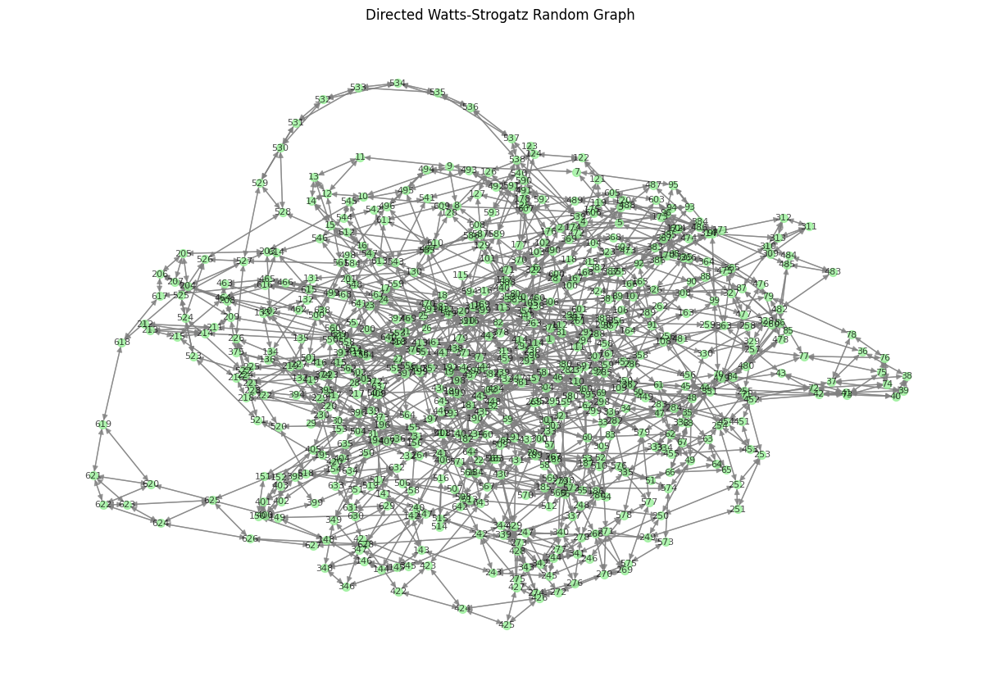

In [ ]:
import networkx as nx
import pandas as pd
import matplotlib.pyplot as plt

# Assuming 'USA_flights' has columns like 'Source', 'Target', 'Weight'

# Create a directed graph
G = nx.DiGraph()

# Add edges with weights
for index, row in USA_flights.iterrows():
    G.add_edge(row['Source'], row['Target'], weight=row['Weight'])

# Calculate Watts-Strogatz random graph for an undirected graph
n_nodes = len(G.nodes())
k = 4  # Average degree of initial regular graph
p = 0.2  # Probability of rewiring each edge

# Create an undirected Watts-Strogatz graph
watts_strogatz_graph_undirected = nx.watts_strogatz_graph(n_nodes, k, p, seed=42)

# Convert the undirected graph to a directed graph
watts_strogatz_graph_directed = nx.DiGraph(watts_strogatz_graph_undirected)

# Draw the Watts-Strogatz random graph
plt.figure(figsize=(12, 8))
pos = nx.spring_layout(watts_strogatz_graph_directed)
nx.draw(watts_strogatz_graph_directed, pos, with_labels=True, node_size=50, font_size=8, font_color='black', node_color='lightgreen', edge_color='gray', alpha=0.7, arrowsize=10)

plt.title('Directed Watts-Strogatz Random Graph')
plt.show()


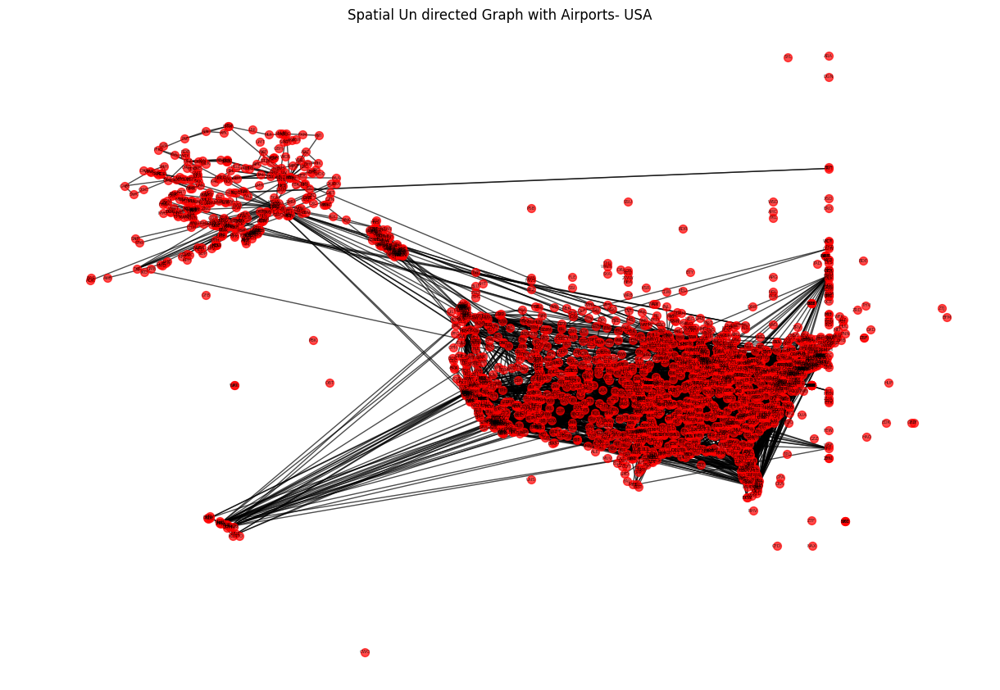

In [ ]:
import networkx as nx
import pandas as pd
import matplotlib.pyplot as plt

# Assuming 'USA_flights' has columns like 'Source', 'Target', 'Weight', 'Lat_source', 'Lon_source', 'Lat_target', 'Lon_target'
# Assuming 'USA_airports' has columns like 'id', 'Lat', 'Lon', 'country'

# Create a directed graph
G = nx.Graph()

# Add edges with weights
for index, row in USA_flights.iterrows():
    G.add_edge(row['Source'], row['Target'], weight=row['Weight'])

# Create a dictionary to store node positions based on airport coordinates
node_positions = {}
for index, row in USA_airports.iterrows():
    G.add_node(row['id'], pos=(row['Lon'], row['Lat ']), country=row['country'])
    node_positions[row['id']] = (row['Lon'], row['Lat '])

# Draw the spatial graph
plt.figure(figsize=(12, 8))
nx.draw(G, pos=node_positions, with_labels=True, node_size=50, font_size=4, font_color='black', node_color='red', edge_color='black', alpha=0.7, arrowsize=10)

plt.title('Spatial Un directed Graph with Airports- USA')
plt.show()


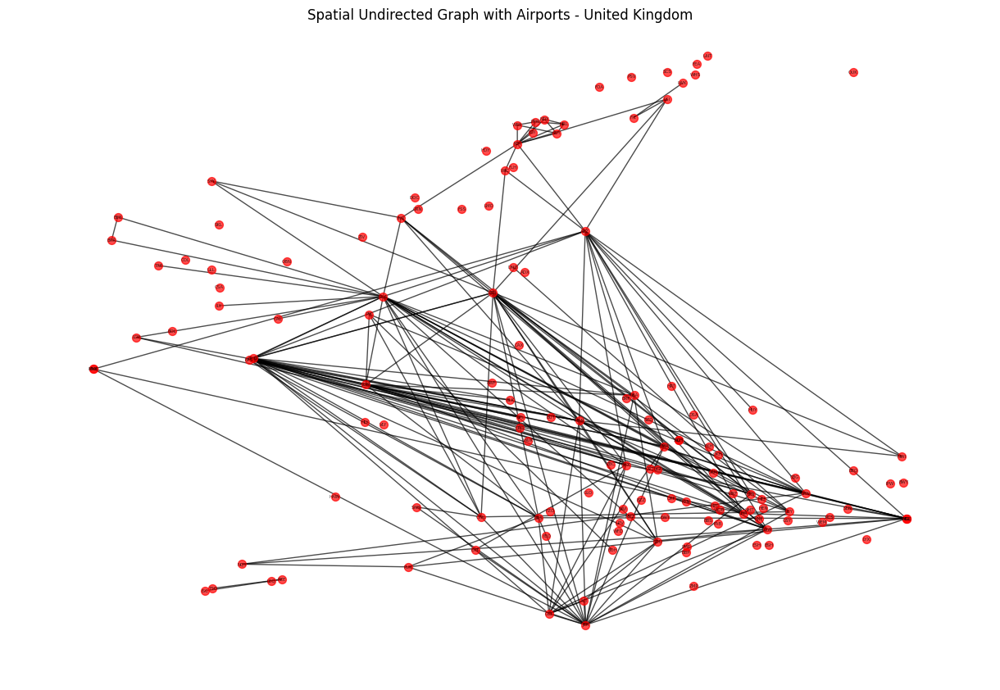

In [ ]:
import networkx as nx
import pandas as pd
import matplotlib.pyplot as plt


# Load data
uk_flights = pd.read_excel('/content/drive/MyDrive/uk_flights.xlsx')  # Update with your actual file path
uk_airports = pd.read_csv('/content/drive/MyDrive/uk_airports.csv')  # Update with your actual file path

# Create an undirected graph
G = nx.Graph()

# Add edges with weights
for index, row in uk_flights.iterrows():
    G.add_edge(row['Source'], row['Target'], weight=row['Weight'])

# Create a dictionary to store node positions based on airport coordinates
node_positions = {}
for index, row in uk_airports.iterrows():
    G.add_node(row['id'], pos=(row['Lon'], row['Lat ']), country=row['country'])
    node_positions[row['id']] = (row['Lon'], row['Lat '])

# Draw the spatial graph
plt.figure(figsize=(12, 8))
nx.draw(G, pos=node_positions, with_labels=True, node_size=50, font_size=4, font_color='black', node_color='red', edge_color='black', alpha=0.7, arrowsize=10)

plt.title('Spatial Undirected Graph with Airports - United Kingdom')
plt.show()


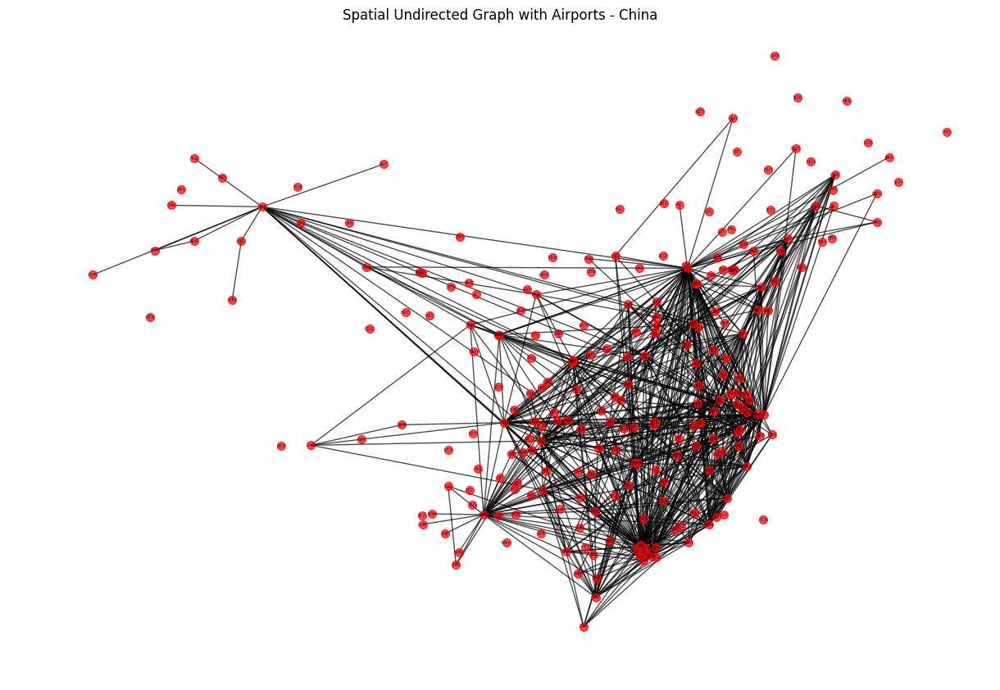

In [ ]:
import networkx as nx
import pandas as pd
import matplotlib.pyplot as plt

# Assuming 'uk_flights' has columns like 'Source', 'Target', 'Weight', 'Lat_source', 'Lon_source', 'Lat_target', 'Lon_target'
# Assuming 'uk_airports' has columns like 'id', 'Lat', 'Lon', 'country'

# Load data
uk_flights = pd.read_excel('/content/drive/MyDrive/china_flights.xlsx')  # Update with your actual file path
uk_airports = pd.read_csv('/content/drive/MyDrive/china_airports.csv')  # Update with your actual file path

# Create an undirected graph
G = nx.Graph()

# Add edges with weights
for index, row in uk_flights.iterrows():
    G.add_edge(row['Source'], row['Target'], weight=row['Weight'])

# Create a dictionary to store node positions based on airport coordinates
node_positions = {}
for index, row in uk_airports.iterrows():
    G.add_node(row['id'], pos=(row['Lon'], row['Lat ']), country=row['country'])
    node_positions[row['id']] = (row['Lon'], row['Lat '])

# Draw the spatial graph
plt.figure(figsize=(12, 8))
nx.draw(G, pos=node_positions, with_labels=True, node_size=50, font_size=4, font_color='black', node_color='red', edge_color='black', alpha=0.7, arrowsize=10)

plt.title('Spatial Undirected Graph with Airports - China')
plt.show()


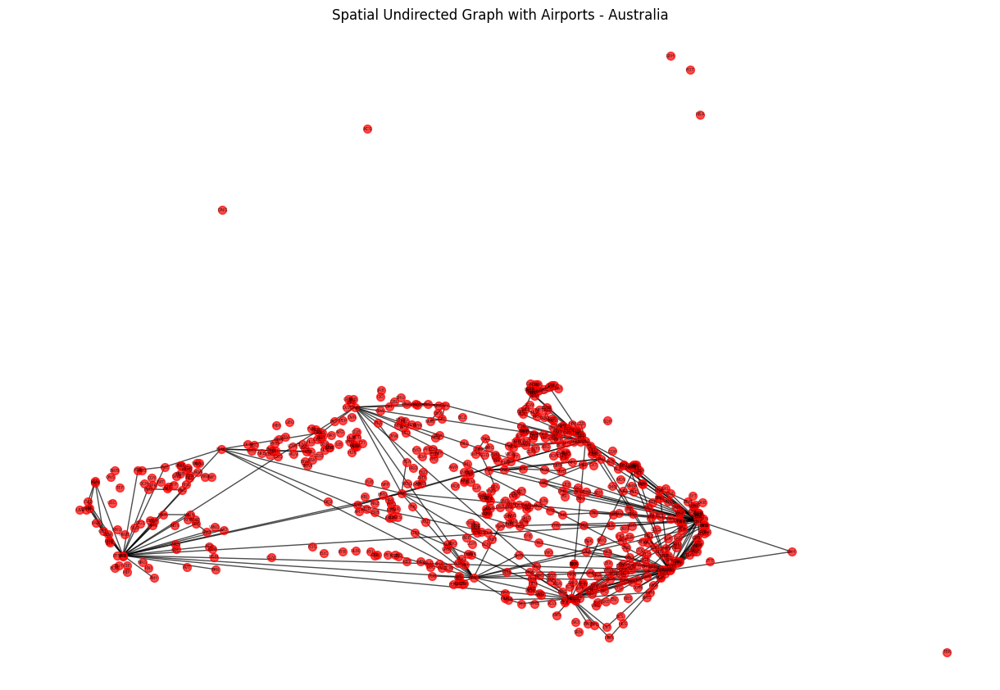

In [ ]:
import networkx as nx
import pandas as pd
import matplotlib.pyplot as plt

# Assuming 'uk_flights' has columns like 'Source', 'Target', 'Weight', 'Lat_source', 'Lon_source', 'Lat_target', 'Lon_target'
# Assuming 'uk_airports' has columns like 'id', 'Lat', 'Lon', 'country'

# Load data
uk_flights = pd.read_excel('/content/drive/MyDrive/aus_flights.xlsx')  # Update with your actual file path
uk_airports = pd.read_csv('/content/drive/MyDrive/aus_airports.csv')  # Update with your actual file path

# Create an undirected graph
G = nx.Graph()

# Add edges with weights
for index, row in uk_flights.iterrows():
    G.add_edge(row['Source'], row['Target'], weight=row['Weight'])

# Create a dictionary to store node positions based on airport coordinates
node_positions = {}
for index, row in uk_airports.iterrows():
    G.add_node(row['id'], pos=(row['Lon'], row['Lat ']), country=row['country'])
    node_positions[row['id']] = (row['Lon'], row['Lat '])

# Draw the spatial graph
plt.figure(figsize=(12, 8))
nx.draw(G, pos=node_positions, with_labels=True, node_size=50, font_size=4, font_color='black', node_color='red', edge_color='black', alpha=0.7, arrowsize=10)

plt.title('Spatial Undirected Graph with Airports - Australia')
plt.show()


In [ ]:
import networkx as nx
import pandas as pd
import plotly.graph_objects as go

# Assuming 'USA_flights' has columns like 'Source', 'Target', 'Weight', 'Lat_source', 'Lon_source', 'Lat_target', 'Lon_target'
# Assuming 'USA_airports' has columns like 'id', 'Lat', 'Lon', 'country'

# Create a directed graph
G = nx.Graph()

# Add edges with weights
for index, row in USA_flights.iterrows():
    G.add_edge(row['Source'], row['Target'], weight=row['Weight'])

# Create a dictionary to store node positions based on airport coordinates
node_positions = {}
for index, row in USA_airports.iterrows():
    G.add_node(row['id'], pos=(row['Lon'], row['Lat ']), country=row['country'])
    node_positions[row['id']] = (row['Lon'], row['Lat '])

# Create edge traces
edge_x = []
edge_y = []
for edge in G.edges():
    x0, y0 = node_positions[edge[0]]
    x1, y1 = node_positions[edge[1]]
    edge_x.append(x0)
    edge_x.append(x1)
    edge_x.append(None)
    edge_y.append(y0)
    edge_y.append(y1)
    edge_y.append(None)

edge_trace = go.Scatter(
    x=edge_x, y=edge_y,
    line=dict(width=0.5, color='#888'),
    hoverinfo='none',
    mode='lines')

# Create node traces
node_x = []
node_y = []
for node in G.nodes():
    x, y = node_positions[node]
    node_x.append(x)
    node_y.append(y)

node_trace = go.Scatter(
    x=node_x, y=node_y,
    mode='markers',
    hoverinfo='text',
    marker=dict(
        showscale=True,
        colorscale='YlGnBu',
        size=10,
        colorbar=dict(
            thickness=15,
            title='Node Connections',
            xanchor='left',
            titleside='right'
        )
    )
)

# Customize node text
node_adjacencies = []
node_text = []
for node, adjacencies in enumerate(G.adjacency()):
    node_adjacencies.append(len(adjacencies[1]))
    node_text.append('# of connections: '+str(len(adjacencies[1])))

node_trace.marker.color = node_adjacencies
node_trace.text = node_text

# Create figure
fig = go.Figure(data=[edge_trace, node_trace],
             layout=go.Layout(
                showlegend=False,
                hovermode='closest',
                margin=dict(b=0,l=0,r=0,t=0),
                xaxis=dict(showgrid=False, zeroline=False, showticklabels=False),
                yaxis=dict(showgrid=False, zeroline=False, showticklabels=False))
                )

# Show the plot
fig.show()


<ipython-input-50-4786dccffa38>:42: MatplotlibDeprecationWarning:

Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.



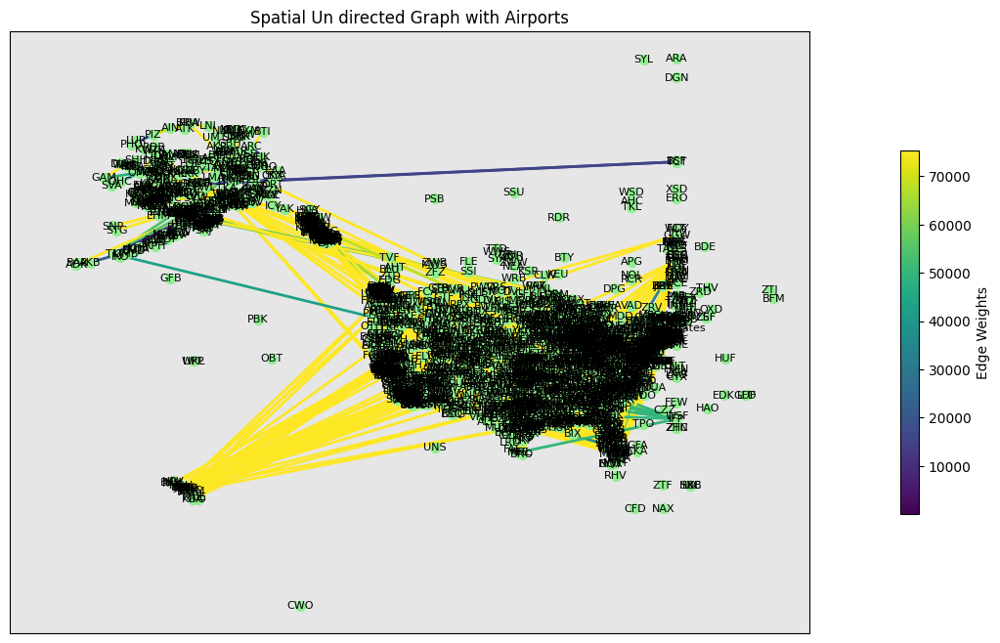

In [ ]:
import networkx as nx
import pandas as pd
import matplotlib.pyplot as plt

# Assuming 'USA_flights' has columns like 'Source', 'Target', 'Weight', 'Lat_source', 'Lon_source', 'Lat_target', 'Lon_target'
# Assuming 'USA_airports' has columns like 'id', 'Lat', 'Lon', 'country'

# Create a directed graph
G = nx.Graph()

# Add edges with weights
for index, row in USA_flights.iterrows():
    G.add_edge(row['Source'], row['Target'], weight=row['Weight'])

# Create a dictionary to store node positions based on airport coordinates
node_positions = {}
for index, row in USA_airports.iterrows():
    G.add_node(row['id'], pos=(row['Lon'], row['Lat ']), country=row['country'])
    node_positions[row['id']] = (row['Lon'], row['Lat '])

# Get edge weights for coloring
edge_weights = [data['weight'] for source, target, data in G.edges(data=True)]

# Draw the spatial graph with a nice background and colors
plt.figure(figsize=(12, 8))
ax = plt.gca()
ax.set_facecolor('#e6e6e6')  # Light gray background

# Draw nodes
nx.draw_networkx_nodes(G, pos=node_positions, node_size=50, node_color='lightgreen', ax=ax)

# Draw edges with color based on weights
edge_colors = plt.cm.viridis(edge_weights)
nx.draw_networkx_edges(G, pos=node_positions, edge_color=edge_colors, width=2, ax=ax)

# Draw labels
nx.draw_networkx_labels(G, pos=node_positions, font_size=8, font_color='black', ax=ax)

# Draw colorbar for edge weights
sm = plt.cm.ScalarMappable(cmap=plt.cm.viridis, norm=plt.Normalize(vmin=min(edge_weights), vmax=max(edge_weights)))
sm._A = []
cbar = plt.colorbar(sm, orientation='vertical', fraction=0.02, pad=0.1)
cbar.set_label('Edge Weights')

plt.title('Spatial Un directed Graph with Airports')
plt.show()


In [ ]:
import networkx as nx
import pandas as pd
import geopandas as gpd
from shapely.geometry import Point, LineString
import matplotlib.pyplot as plt
import plotly.express as px

# Load data
USA_flights = pd.read_excel('/content/drive/MyDrive/us_flights.xlsx')
USA_airports = pd.read_csv('/content/drive/MyDrive/us_airports.csv')

# Create a  graph
G = nx.Graph()

# Add edges with weights
for index, row in USA_flights.iterrows():
    G.add_edge(row['Source'], row['Target'], weight=row['Weight'])

# Add nodes with latitude, longitude, and country attributes
for index, row in USA_airports.iterrows():
    G.add_node(row['id'], pos=(row['Lon'], row['Lat ']), country=row['country'])

# Create GeoDataFrame for airport points
gdf_airports = gpd.GeoDataFrame(USA_airports, geometry=gpd.points_from_xy(USA_airports['Lon'], USA_airports['Lat ']))

# Create GeoDataFrame for flight lines
gdf_flights = gpd.GeoDataFrame(columns=['Source', 'Target', 'geometry'])
for edge in G.edges(data=True):
    source, target, data = edge
    line = LineString([G.nodes[source]['pos'], G.nodes[target]['pos']])
    gdf_flights = pd.concat([gdf_flights, pd.DataFrame({'Source': [source], 'Target': [target], 'geometry': [line]})], ignore_index=True)

# Set the coordinate reference system (CRS) for GeoDataFrames
gdf_airports.crs = "EPSG:4326"
gdf_flights.crs = "EPSG:4326"

# Create an interactive map
fig = px.choropleth_mapbox(
    gdf_airports,
    geojson=gdf_airports.geometry,
    locations=gdf_airports.index,
    color=gdf_airports['country'],
    hover_name='id',
    mapbox_style="carto-positron",
    center={'lat': 0, 'lon': 0},
    zoom=1
)

# Add airport points and flight lines to the map
scatter_map = px.scatter_mapbox(
    gdf_airports,
    lat='Lat ',
    lon='Lon',
    text='id',
    hover_data=['country'],
    color_discrete_sequence=['red'],
    size_max=10,
    zoom=1
)

flight_lines = px.line_mapbox(
    gdf_flights,
    lat=gdf_flights.geometry.apply(lambda geom: geom.centroid.y),
    lon=gdf_flights.geometry.apply(lambda geom: geom.centroid.x),
    hover_name='Source',
    zoom=1
)

# Update map layout
scatter_map.update_traces(marker=dict(size=8))
flight_lines.update_traces(line=dict(width=0.5, color='black'))

# Combine the maps
fig.add_trace(scatter_map.data[0])
fig.add_trace(flight_lines.data[0])

# Show the plot
fig.show()


In [ ]:
import networkx as nx
import pandas as pd
import geopandas as gpd
from shapely.geometry import Point, LineString
import matplotlib.pyplot as plt
import plotly.express as px

# Load data
USA_flights = pd.read_excel('/content/drive/MyDrive/uk_flights.xlsx')
USA_airports = pd.read_csv('/content/drive/MyDrive/uk_airports.csv')

# Create a graph
G = nx.Graph()

# Add edges with weights
for index, row in USA_flights.iterrows():
    G.add_edge(row['Source'], row['Target'], weight=row['Weight'])

# Add nodes with latitude, longitude, and country attributes
for index, row in USA_airports.iterrows():
    G.add_node(row['id'], pos=(row['Lon'], row['Lat ']), country=row['country'])

# Create GeoDataFrame for airport points
gdf_airports = gpd.GeoDataFrame(USA_airports, geometry=gpd.points_from_xy(USA_airports['Lon'], USA_airports['Lat ']))

# Create GeoDataFrame for flight lines
gdf_flights = gpd.GeoDataFrame(columns=['Source', 'Target', 'geometry'])
for edge in G.edges(data=True):
    source, target, data = edge
    line = LineString([G.nodes[source]['pos'], G.nodes[target]['pos']])
    gdf_flights = pd.concat([gdf_flights, pd.DataFrame({'Source': [source], 'Target': [target], 'geometry': [line]})], ignore_index=True)

# Set the coordinate reference system (CRS) for GeoDataFrames
gdf_airports.crs = "EPSG:4326"
gdf_flights.crs = "EPSG:4326"

# Create an interactive map
fig = px.choropleth_mapbox(
    gdf_airports,
    geojson=gdf_airports.geometry,
    locations=gdf_airports.index,
    color=gdf_airports['country'],
    hover_name='id',
    mapbox_style="carto-positron",
    center={'lat': 0, 'lon': 0},
    zoom=1
)

# Add airport points to the map
scatter_map = px.scatter_mapbox(
    gdf_airports,
    lat='Lat ',
    lon='Lon',
    text='id',
    hover_data=['country'],
    color_discrete_sequence=['red'],  # Customize node color here
    size_max=10,
    zoom=1
)

# Create GeoDataFrame for flight lines
gdf_flights = gpd.GeoDataFrame(columns=['Source', 'Target', 'geometry'])
for edge in G.edges(data=True):
    source, target, data = edge
    line = LineString([G.nodes[source]['pos'], G.nodes[target]['pos']])
    gdf_flights = pd.concat([gdf_flights, pd.DataFrame({'Source': [source], 'Target': [target], 'geometry': [line]})], ignore_index=True)

# Create GeoDataFrame for flight lines
gdf_flights = gpd.GeoDataFrame(columns=['Source', 'Target', 'geometry'])
for edge in G.edges(data=True):
    source, target, data = edge
    line = LineString([G.nodes[source]['pos'], G.nodes[target]['pos']])
    gdf_flights = pd.concat([gdf_flights, pd.DataFrame({'Source': [source], 'Target': [target], 'geometry': [line]})], ignore_index=True)

# Set the coordinate reference system (CRS) for GeoDataFrames
gdf_airports.crs = "EPSG:4326"
gdf_flights.crs = "EPSG:4326"

# Create an interactive map
fig = px.choropleth_mapbox(
    gdf_airports,
    geojson=gdf_airports.geometry,
    locations=gdf_airports.index,
    color=gdf_airports['country'],
    hover_name='id',
    mapbox_style="carto-positron",
    center={'lat': 0, 'lon': 0},
    zoom=1
)

# Add airport points to the map
scatter_map = px.scatter_mapbox(
    gdf_airports,
    lat='Lat ',
    lon='Lon',
    text='id',
    hover_data=['country'],
    color_discrete_sequence=['red'],  # Customize node color here
    size_max=10,
    zoom=1
)

# Create GeoDataFrame for flight lines
gdf_flights = gpd.GeoDataFrame(columns=['Source', 'Target', 'geometry'])
for edge in G.edges(data=True):
    source, target, data = edge
    line = LineString([G.nodes[source]['pos'], G.nodes[target]['pos']])
    gdf_flights = pd.concat([gdf_flights, pd.DataFrame({'Source': [source], 'Target': [target], 'geometry': [line]})], ignore_index=True)

# Set the coordinate reference system (CRS) for GeoDataFrames
gdf_airports.crs = "EPSG:4326"
gdf_flights.crs = "EPSG:4326"

# Create an interactive map
fig = px.choropleth_mapbox(
    gdf_airports,
    geojson=gdf_airports.geometry,
    locations=gdf_airports.index,
    color=gdf_airports['country'],
    hover_name='id',
    mapbox_style="carto-positron",
    center={'lat': 0, 'lon': 0},
    zoom=1
)

# Add airport points and flight lines to the map
scatter_map = px.scatter_mapbox(
    gdf_airports,
    lat='Lat ',
    lon='Lon',
    text='id',
    hover_data=['country'],
    color_discrete_sequence=['red'],  # Customize node color here
    size_max=10,
    zoom=1
)

flight_lines = px.line_mapbox(
    gdf_flights,
    lat=gdf_flights.geometry.apply(lambda geom: geom.centroid.y),
    lon=gdf_flights.geometry.apply(lambda geom: geom.centroid.x),
    hover_name='Source',
    color_discrete_sequence=['gray'],  # Customize edge color here
    zoom=1
)

# Update map layout
scatter_map.update_traces(marker=dict(size=8, color='green'))  # Customize specific nodes
flight_lines.update_traces(line=dict(width=0.5, color='gray'))

# Combine the maps
fig.add_trace(scatter_map.data[0])
fig.add_trace(flight_lines.data[0])

# Show the plot
fig.show()


In [ ]:
import networkx as nx
import pandas as pd
import geopandas as gpd
from shapely.geometry import Point, LineString
import matplotlib.pyplot as plt
import plotly.express as px

# Load data
USA_flights = pd.read_excel('/content/drive/MyDrive/china_flights.xlsx')  # Adjust the path
USA_airports = pd.read_csv('/content/drive/MyDrive/china_airports.csv')  # Adjust the path

# Create a directed graph
G = nx.DiGraph()

# Add edges with weights
for index, row in USA_flights.iterrows():
    G.add_edge(row['Source'], row['Target'], weight=row['Weight'])

# Add nodes with latitude, longitude, and country attributes
for index, row in USA_airports.iterrows():
    G.add_node(row['id'], pos=(row['Lon'], row['Lat ']), country=row['country'])

# Create GeoDataFrame for airport points
gdf_airports = gpd.GeoDataFrame(USA_airports, geometry=gpd.points_from_xy(USA_airports['Lon'], USA_airports['Lat ']))

# Create GeoDataFrame for flight lines
gdf_flights = gpd.GeoDataFrame(columns=['Source', 'Target', 'geometry'])
for edge in G.edges(data=True):
    source, target, data = edge
    line = LineString([G.nodes[source]['pos'], G.nodes[target]['pos']])
    gdf_flights = pd.concat([gdf_flights, pd.DataFrame({'Source': [source], 'Target': [target], 'geometry': [line]})], ignore_index=True)

# Set the coordinate reference system (CRS) for GeoDataFrames
gdf_airports.crs = "EPSG:4326"
gdf_flights.crs = "EPSG:4326"

# Create an interactive map
fig = px.choropleth_mapbox(
    gdf_airports,
    geojson=gdf_airports.geometry,
    locations=gdf_airports.index,
    color=gdf_airports['country'],
    hover_name='id',
    mapbox_style="carto-positron",
    center={'lat': 0, 'lon': 0},
    zoom=1
)

# Add airport points and flight lines to the map
scatter_map = px.scatter_mapbox(
    gdf_airports,
    lat='Lat ',
    lon='Lon',
    text='id',
    hover_data=['country'],
    color_discrete_sequence=['orange'],
    size_max=10,
    zoom=1
)

flight_lines = px.line_mapbox(
    gdf_flights,
    lat=gdf_flights.geometry.apply(lambda geom: geom.centroid.y),
    lon=gdf_flights.geometry.apply(lambda geom: geom.centroid.x),
    hover_name='Source',
    zoom=1
)

# Update map layout
scatter_map.update_traces(marker=dict(size=8))
flight_lines.update_traces(line=dict(width=0.5, color='blue'))

# Combine the maps
fig.add_trace(scatter_map.data[0])
fig.add_trace(flight_lines.data[0])

# Show the plot
fig.show()


In [ ]:
import networkx as nx
import pandas as pd
import geopandas as gpd
from shapely.geometry import Point, LineString
import matplotlib.pyplot as plt
import plotly.express as px

# Load data
Aus_flights = pd.read_excel('/content/drive/MyDrive/aus_flights.xlsx')  # Adjust the path
Aus_airports = pd.read_csv('/content/drive/MyDrive/aus_airports.csv')  # Adjust the path

# Create a graph
G = nx.Graph()

# Add edges with weights
for index, row in Aus_flights.iterrows():
    G.add_edge(row['Source'], row['Target'], weight=row['Weight'])

# Add nodes with latitude, longitude, and country attributes
for index, row in Aus_airports.iterrows():
    G.add_node(row['id'], pos=(row['Lon'], row['Lat ']), country=row['country'])

# Create GeoDataFrame for airport points
gdf_airports = gpd.GeoDataFrame(Aus_airports, geometry=gpd.points_from_xy(Aus_airports['Lon'], Aus_airports['Lat ']))

# Create GeoDataFrame for flight lines
gdf_flights = gpd.GeoDataFrame(columns=['Source', 'Target', 'geometry'])
for edge in G.edges(data=True):
    source, target, data = edge
    line = LineString([G.nodes[source]['pos'], G.nodes[target]['pos']])
    gdf_flights = pd.concat([gdf_flights, pd.DataFrame({'Source': [source], 'Target': [target], 'geometry': [line]})], ignore_index=True)

# Set the coordinate reference system (CRS) for GeoDataFrames
gdf_airports.crs = "EPSG:4326"
gdf_flights.crs = "EPSG:4326"

# Create an interactive map
fig = px.choropleth_mapbox(
    gdf_airports,
    geojson=gdf_airports.geometry,
    locations=gdf_airports.index,
    color=gdf_airports['country'],
    hover_name='id',
    mapbox_style="carto-positron",
    center={'lat': 0, 'lon': 0},
    zoom=1
)

# Add airport points and flight lines to the map
scatter_map = px.scatter_mapbox(
    gdf_airports,
    lat='Lat ',
    lon='Lon',
    text='id',
    hover_data=['country'],
    color_discrete_sequence=['purple'],
    size_max=10,
    zoom=1
)

flight_lines = px.line_mapbox(
    gdf_flights,
    lat=gdf_flights.geometry.apply(lambda geom: geom.centroid.y),
    lon=gdf_flights.geometry.apply(lambda geom: geom.centroid.x),
    hover_name='Source',
    zoom=1
)

# Update map layout
scatter_map.update_traces(marker=dict(size=8))
flight_lines.update_traces(line=dict(width=0.5, color='gray'))

# Combine the maps
fig.add_trace(scatter_map.data[0])
fig.add_trace(flight_lines.data[0])

# Show the plot
fig.show()


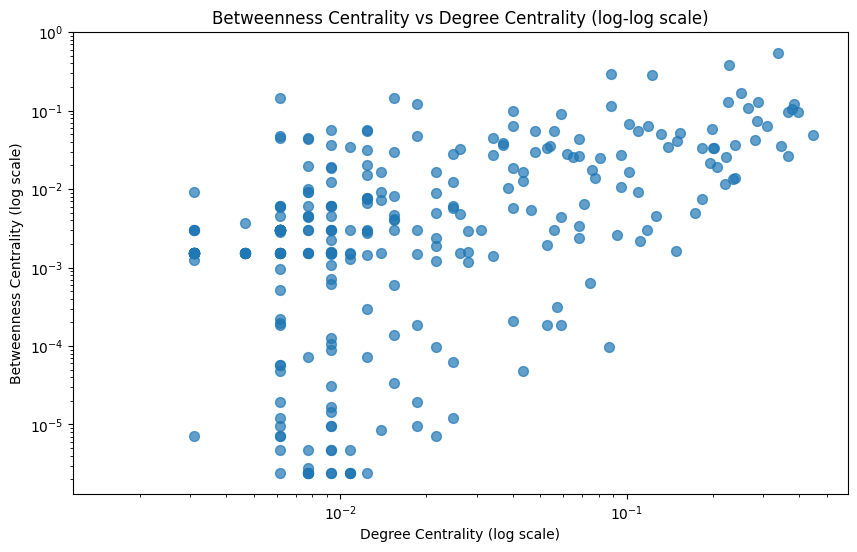

In [ ]:
import networkx as nx
import pandas as pd
import matplotlib.pyplot as plt

# Assuming 'USA_flights' has columns like 'Source', 'Target', 'Weight'

# Create a directed graph
G = nx.DiGraph()

# Add edges with weights
for index, row in USA_flights.iterrows():
    G.add_edge(row['Source'], row['Target'], weight=row['Weight'])

# Calculate betweenness centrality and degree centrality
betweenness = nx.betweenness_centrality(G, weight='weight')
degree = nx.degree_centrality(G)

# Create a DataFrame for node attributes
node_data = pd.DataFrame({'Node': list(G.nodes()), 'Betweenness': [betweenness[node] for node in G.nodes()], 'Degree': [degree[node] for node in G.nodes()]})

# Create a scatter plot with log scales
plt.figure(figsize=(10, 6))
plt.scatter(node_data['Degree'], node_data['Betweenness'], s=50, alpha=0.7)

# Add labels and log scales
plt.xscale('log')
plt.yscale('log')
plt.xlabel('Degree Centrality (log scale)')
plt.ylabel('Betweenness Centrality (log scale)')
plt.title('Betweenness Centrality vs Degree Centrality (log-log scale)')

# Show the plot
plt.show()


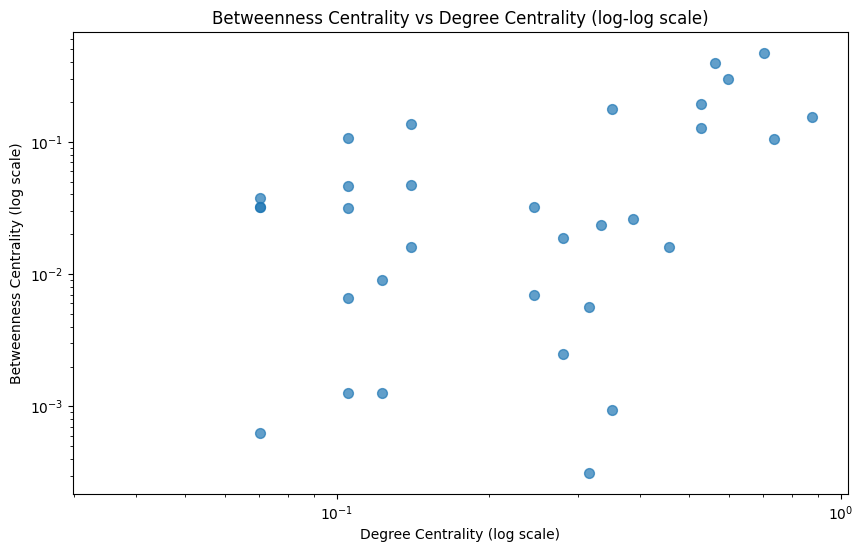

In [ ]:
import networkx as nx
import pandas as pd
import matplotlib.pyplot as plt

UK_flights = pd.read_excel('/content/drive/MyDrive/uk_flights.xlsx')  # Adjust the path

# Create a directed graph
G = nx.DiGraph()

# Add edges with weights
for index, row in UK_flights.iterrows():
    G.add_edge(row['Source'], row['Target'], weight=row['Weight'])

# Calculate betweenness centrality and degree centrality
betweenness = nx.betweenness_centrality(G, weight='weight')
degree = nx.degree_centrality(G)

# Create a DataFrame for node attributes
node_data = pd.DataFrame({'Node': list(G.nodes()), 'Betweenness': [betweenness[node] for node in G.nodes()], 'Degree': [degree[node] for node in G.nodes()]})

# Create a scatter plot with log scales
plt.figure(figsize=(10, 6))
plt.scatter(node_data['Degree'], node_data['Betweenness'], s=50, alpha=0.7)

# Add labels and log scales
plt.xscale('log')
plt.yscale('log')
plt.xlabel('Degree Centrality (log scale)')
plt.ylabel('Betweenness Centrality (log scale)')
plt.title('Betweenness Centrality vs Degree Centrality (log-log scale)')

# Show the plot
plt.show()


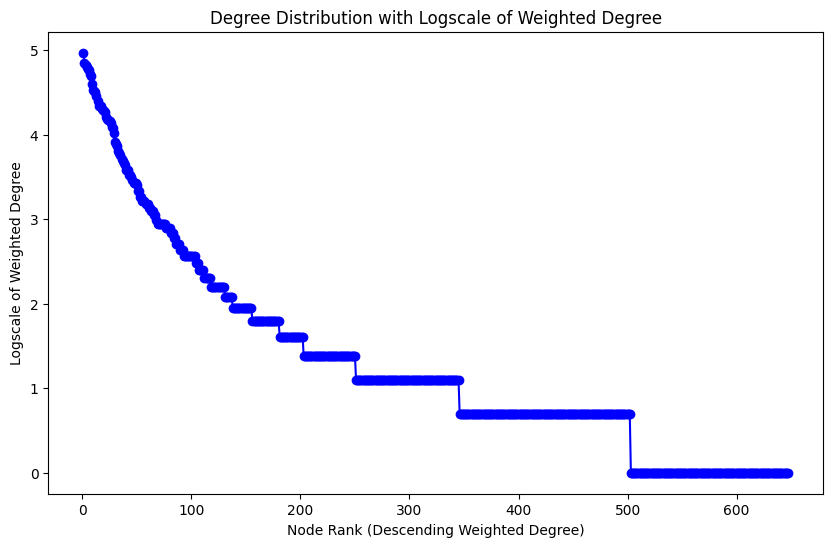

In [ ]:
import networkx as nx
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

# Assuming 'USA_flights' has columns like 'Source', 'Target', 'Weight'
# Assuming 'USA_airports' has columns like 'id', 'Lat', 'Lon', 'country'

# Create a directed graph
G = nx.Graph()

# Add edges with weights
for index, row in USA_flights.iterrows():
    G.add_edge(row['Source'], row['Target'], weight=row['Weight'])

# Calculate the weighted degree of each node
weighted_degrees = dict(G.degree(weight='Weight'))

# Sort nodes by descending weighted degree
sorted_degrees = sorted(weighted_degrees.items(), key=lambda x: x[1], reverse=True)

# Extract nodes and their weighted degrees
nodes, degrees = zip(*sorted_degrees)

# Plot the degree distribution with logscale
plt.figure(figsize=(10, 6))
plt.plot(range(1, len(degrees) + 1), np.log(degrees), marker='o', linestyle='-', color='b')
plt.title('Degree Distribution with Logscale of Weighted Degree')
plt.xlabel('Node Rank (Descending Weighted Degree)')
plt.ylabel('Logscale of Weighted Degree')
plt.show()


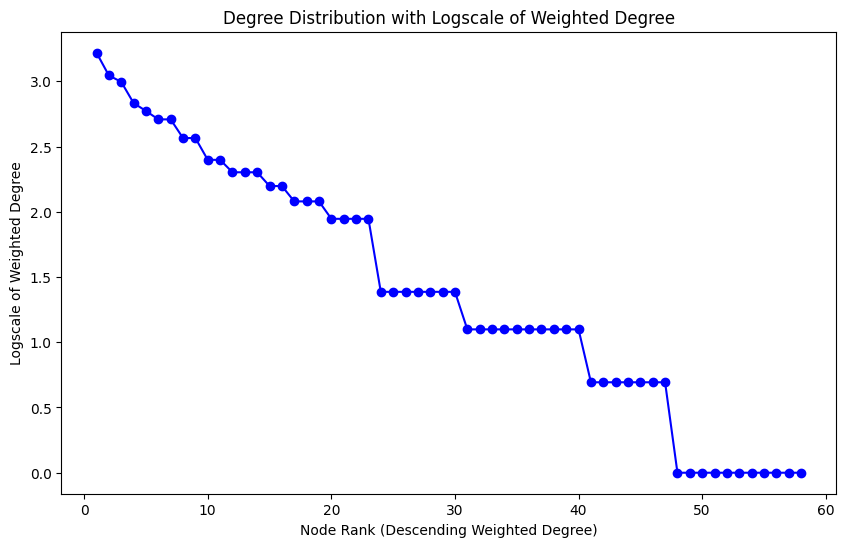

In [ ]:
import networkx as nx
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

UK_flights = pd.read_excel('/content/drive/MyDrive/uk_flights.xlsx')  # Adjust the path

# Create a directed graph
G = nx.Graph()

# Add edges with weights
for index, row in UK_flights.iterrows():
    G.add_edge(row['Source'], row['Target'], weight=row['Weight'])

# Calculate the weighted degree of each node
weighted_degrees = dict(G.degree(weight='Weight'))

# Sort nodes by descending weighted degree
sorted_degrees = sorted(weighted_degrees.items(), key=lambda x: x[1], reverse=True)

# Extract nodes and their weighted degrees
nodes, degrees = zip(*sorted_degrees)

# Plot the degree distribution with logscale
plt.figure(figsize=(10, 6))
plt.plot(range(1, len(degrees) + 1), np.log(degrees), marker='o', linestyle='-', color='b')
plt.title('Degree Distribution with Logscale of Weighted Degree')
plt.xlabel('Node Rank (Descending Weighted Degree)')
plt.ylabel('Logscale of Weighted Degree')
plt.show()


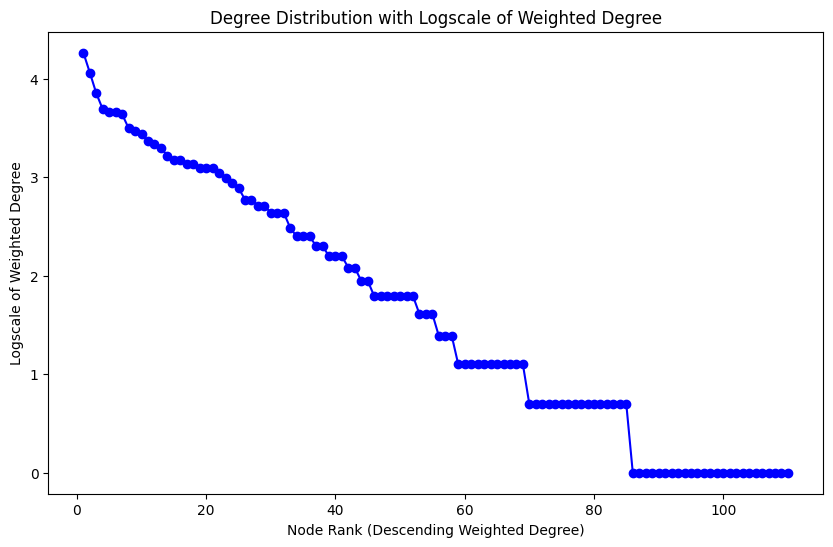

In [ ]:
import networkx as nx
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

China_flights = pd.read_excel('/content/drive/MyDrive/china_flights.xlsx')  # Adjust the path

# Create a directed graph
G = nx.Graph()

# Add edges with weights
for index, row in China_flights.iterrows():
    G.add_edge(row['Source'], row['Target'], weight=row['Weight'])

# Calculate the weighted degree of each node
weighted_degrees = dict(G.degree(weight='Weight'))

# Sort nodes by descending weighted degree
sorted_degrees = sorted(weighted_degrees.items(), key=lambda x: x[1], reverse=True)

# Extract nodes and their weighted degrees
nodes, degrees = zip(*sorted_degrees)

# Plot the degree distribution with logscale
plt.figure(figsize=(10, 6))
plt.plot(range(1, len(degrees) + 1), np.log(degrees), marker='o', linestyle='-', color='b')
plt.title('Degree Distribution with Logscale of Weighted Degree')
plt.xlabel('Node Rank (Descending Weighted Degree)')
plt.ylabel('Logscale of Weighted Degree')
plt.show()


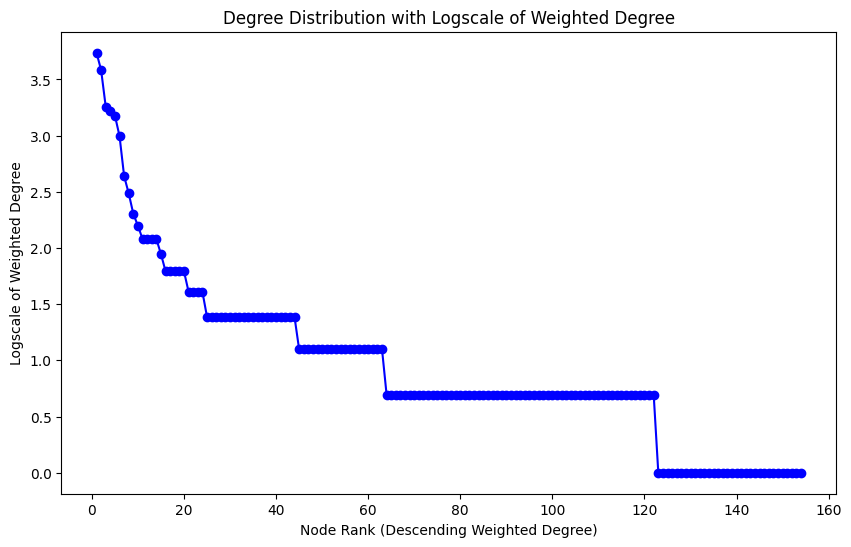

In [ ]:
import networkx as nx
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

Aus_flights = pd.read_excel('/content/drive/MyDrive/aus_flights.xlsx')  # Adjust the path

# Create a directed graph
G = nx.Graph()

# Add edges with weights
for index, row in Aus_flights.iterrows():
    G.add_edge(row['Source'], row['Target'], weight=row['Weight'])

# Calculate the weighted degree of each node
weighted_degrees = dict(G.degree(weight='Weight'))

# Sort nodes by descending weighted degree
sorted_degrees = sorted(weighted_degrees.items(), key=lambda x: x[1], reverse=True)

# Extract nodes and their weighted degrees
nodes, degrees = zip(*sorted_degrees)

# Plot the degree distribution with logscale
plt.figure(figsize=(10, 6))
plt.plot(range(1, len(degrees) + 1), np.log(degrees), marker='o', linestyle='-', color='b')
plt.title('Degree Distribution with Logscale of Weighted Degree')
plt.xlabel('Node Rank (Descending Weighted Degree)')
plt.ylabel('Logscale of Weighted Degree')
plt.show()


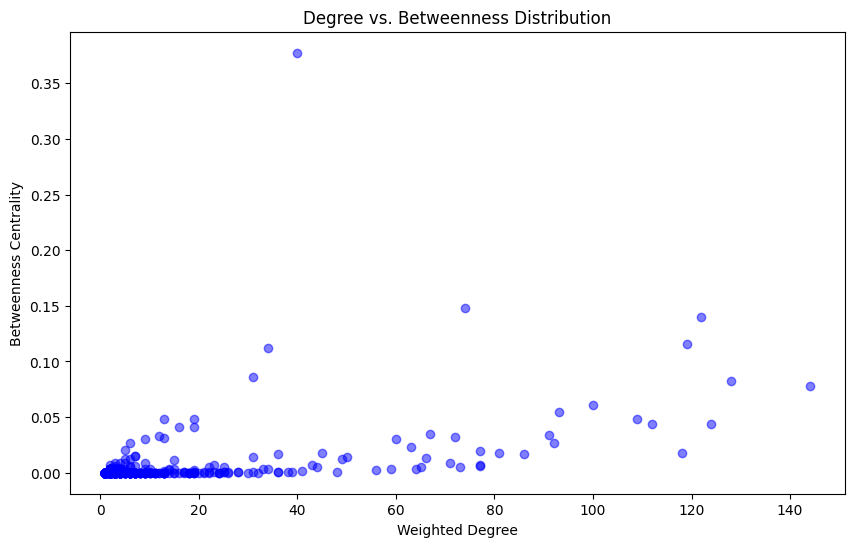

In [ ]:
import networkx as nx
import pandas as pd
import matplotlib.pyplot as plt


# Create a directed graph
G = nx.Graph()

# Add edges with weights
for index, row in USA_flights.iterrows():
    G.add_edge(row['Source'], row['Target'], weight=row['Weight'])

# Calculate the weighted degree and betweenness centrality of each node
weighted_degrees = dict(G.degree(weight='Weight'))
betweenness_centralities = nx.betweenness_centrality(G, weight='Weight')

# Extract nodes, their weighted degrees, and betweenness centralities
nodes = list(G.nodes())
degrees = [weighted_degrees[node] for node in nodes]
betweenness_values = [betweenness_centralities[node] for node in nodes]

# Plot Degree vs. Betweenness distribution
plt.figure(figsize=(10, 6))
plt.scatter(degrees, betweenness_values, color='b', alpha=0.5)
plt.title('Degree vs. Betweenness Distribution')
plt.xlabel('Weighted Degree')
plt.ylabel('Betweenness Centrality')
plt.show()


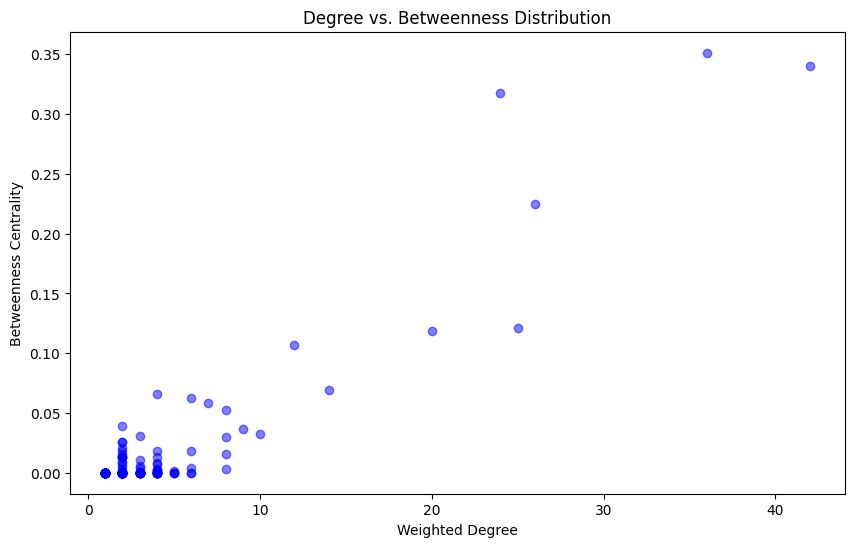

In [ ]:
import networkx as nx
import pandas as pd
import matplotlib.pyplot as plt

Aus_flights = pd.read_excel('/content/drive/MyDrive/aus_flights.xlsx')  # Adjust the path

# Create a directed graph
G = nx.Graph()

# Add edges with weights
for index, row in Aus_flights.iterrows():
    G.add_edge(row['Source'], row['Target'], weight=row['Weight'])

# Calculate the weighted degree and betweenness centrality of each node
weighted_degrees = dict(G.degree(weight='Weight'))
betweenness_centralities = nx.betweenness_centrality(G, weight='Weight')

# Extract nodes, their weighted degrees, and betweenness centralities
nodes = list(G.nodes())
degrees = [weighted_degrees[node] for node in nodes]
betweenness_values = [betweenness_centralities[node] for node in nodes]

# Plot Degree vs. Betweenness distribution
plt.figure(figsize=(10, 6))
plt.scatter(degrees, betweenness_values, color='b', alpha=0.5)
plt.title('Degree vs. Betweenness Distribution')
plt.xlabel('Weighted Degree')
plt.ylabel('Betweenness Centrality')
plt.show()


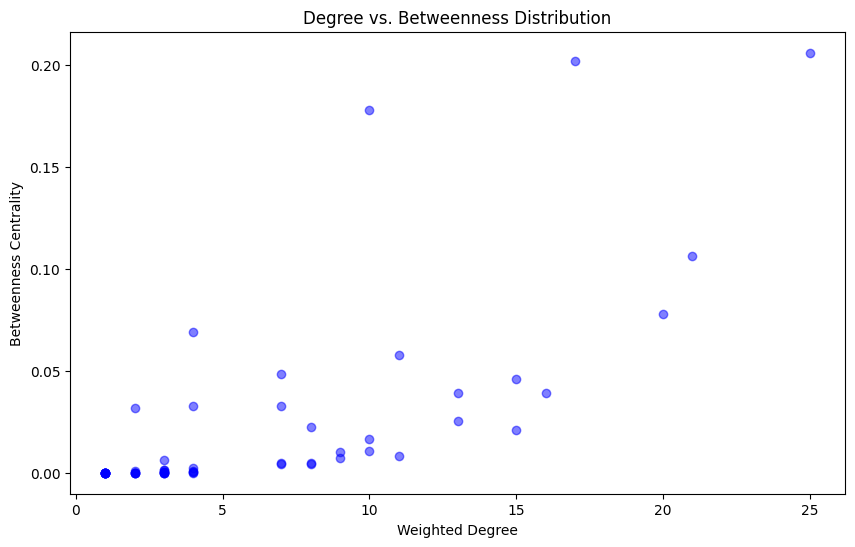

In [ ]:
import networkx as nx
import pandas as pd
import matplotlib.pyplot as plt

UK_flights = pd.read_excel('/content/drive/MyDrive/uk_flights.xlsx')  # Adjust the path

# Create a directed graph
G = nx.Graph()

# Add edges with weights
for index, row in UK_flights.iterrows():
    G.add_edge(row['Source'], row['Target'], weight=row['Weight'])

# Calculate the weighted degree and betweenness centrality of each node
weighted_degrees = dict(G.degree(weight='Weight'))
betweenness_centralities = nx.betweenness_centrality(G, weight='Weight')

# Extract nodes, their weighted degrees, and betweenness centralities
nodes = list(G.nodes())
degrees = [weighted_degrees[node] for node in nodes]
betweenness_values = [betweenness_centralities[node] for node in nodes]

# Plot Degree vs. Betweenness distribution
plt.figure(figsize=(10, 6))
plt.scatter(degrees, betweenness_values, color='b', alpha=0.5)
plt.title('Degree vs. Betweenness Distribution')
plt.xlabel('Weighted Degree')
plt.ylabel('Betweenness Centrality')
plt.show()


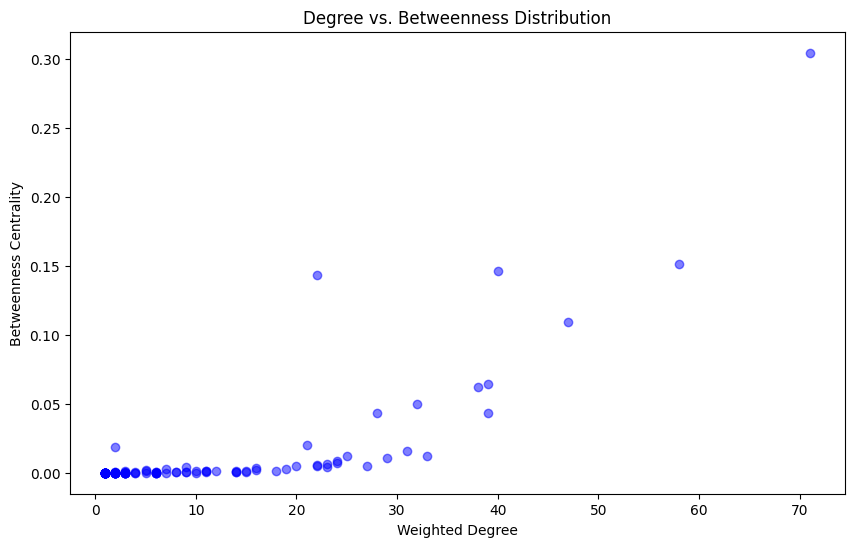

In [ ]:
import networkx as nx
import pandas as pd
import matplotlib.pyplot as plt

China_flights = pd.read_excel('/content/drive/MyDrive/china_flights.xlsx')  # Adjust the path

# Create a directed graph
G = nx.Graph()

# Add edges with weights
for index, row in China_flights.iterrows():
    G.add_edge(row['Source'], row['Target'], weight=row['Weight'])

# Calculate the weighted degree and betweenness centrality of each node
weighted_degrees = dict(G.degree(weight='Weight'))
betweenness_centralities = nx.betweenness_centrality(G, weight='Weight')

# Extract nodes, their weighted degrees, and betweenness centralities
nodes = list(G.nodes())
degrees = [weighted_degrees[node] for node in nodes]
betweenness_values = [betweenness_centralities[node] for node in nodes]

# Plot Degree vs. Betweenness distribution
plt.figure(figsize=(10, 6))
plt.scatter(degrees, betweenness_values, color='b', alpha=0.5)
plt.title('Degree vs. Betweenness Distribution')
plt.xlabel('Weighted Degree')
plt.ylabel('Betweenness Centrality')
plt.show()


In [ ]:
import networkx as nx
import pandas as pd

# Assuming 'USA_flights' has columns like 'Source', 'Target', 'Weight'
# Assuming 'USA_airports' has columns like 'id', 'Lat', 'Lon', 'country'

# Create a directed graph
G = nx.Graph()

# Add edges with weights
for index, row in USA_flights.iterrows():
    G.add_edge(row['Source'], row['Target'], weight=row['Weight'])

# Calculate assortativity
assortativity = nx.degree_assortativity_coefficient(G, weight='Weight')

print(f"Assortativity Coefficient: {assortativity}")


Assortativity Coefficient: -0.20028690723399858


Assortativity Coefficient: -0.20028690723399858


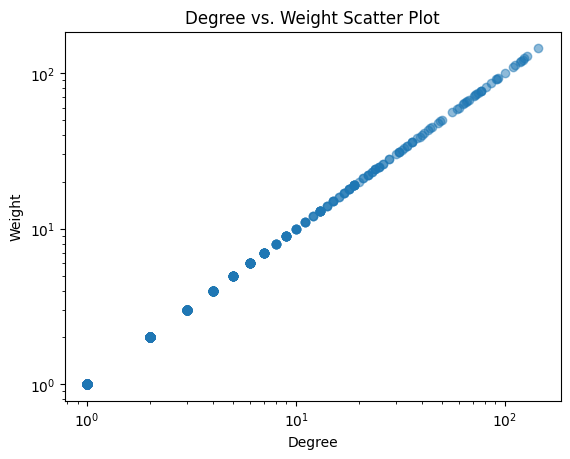

In [ ]:
import networkx as nx
import pandas as pd
import matplotlib.pyplot as plt


# Create a directed graph
G = nx.Graph()

# Add edges with weights
for index, row in USA_flights.iterrows():
    G.add_edge(row['Source'], row['Target'], weight=row['Weight'])

# Calculate assortativity
assortativity = nx.degree_assortativity_coefficient(G, weight='Weight')

print(f"Assortativity Coefficient: {assortativity}")

# Create a scatter plot of node degrees
degrees = dict(G.degree(weight='Weight'))
weights = [degrees[node] for node in G.nodes()]

plt.scatter(degrees.values(), weights, alpha=0.5)
plt.xscale('log')
plt.yscale('log')
plt.xlabel('Degree')
plt.ylabel('Weight')
plt.title('Degree vs. Weight Scatter Plot')
plt.show()


Assortativity Coefficient: -0.22927028183771397


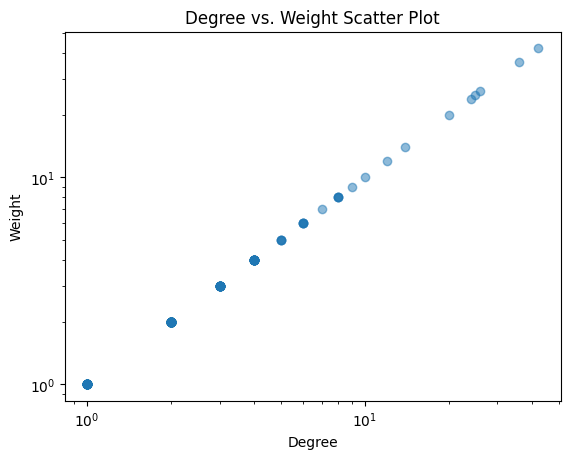

In [ ]:
import networkx as nx
import pandas as pd
import matplotlib.pyplot as plt


# Create a directed graph
G = nx.Graph()

# Add edges with weights
for index, row in Aus_flights.iterrows():
    G.add_edge(row['Source'], row['Target'], weight=row['Weight'])

# Calculate assortativity
assortativity = nx.degree_assortativity_coefficient(G, weight='Weight')

print(f"Assortativity Coefficient: {assortativity}")

# Create a scatter plot of node degrees
degrees = dict(G.degree(weight='Weight'))
weights = [degrees[node] for node in G.nodes()]

plt.scatter(degrees.values(), weights, alpha=0.5)
plt.xscale('log')
plt.yscale('log')
plt.xlabel('Degree')
plt.ylabel('Weight')
plt.title('Degree vs. Weight Scatter Plot')
plt.show()


Assortativity Coefficient: -0.13406803921197377


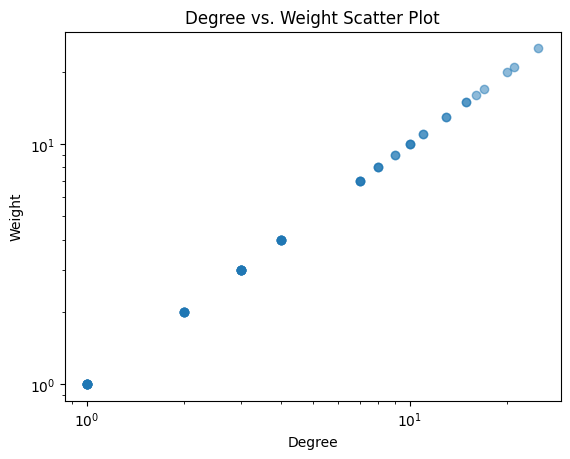

In [ ]:
import networkx as nx
import pandas as pd
import matplotlib.pyplot as plt


# Create a directed graph
G = nx.Graph()

# Add edges with weights
for index, row in UK_flights.iterrows():
    G.add_edge(row['Source'], row['Target'], weight=row['Weight'])

# Calculate assortativity
assortativity = nx.degree_assortativity_coefficient(G, weight='Weight')

print(f"Assortativity Coefficient: {assortativity}")

# Create a scatter plot of node degrees
degrees = dict(G.degree(weight='Weight'))
weights = [degrees[node] for node in G.nodes()]

plt.scatter(degrees.values(), weights, alpha=0.5)
plt.xscale('log')
plt.yscale('log')
plt.xlabel('Degree')
plt.ylabel('Weight')
plt.title('Degree vs. Weight Scatter Plot')
plt.show()


Assortativity Coefficient: -0.39717280505156854


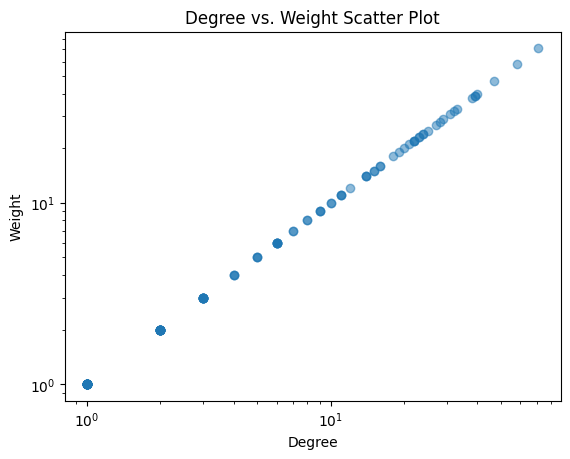

In [ ]:
import networkx as nx
import pandas as pd
import matplotlib.pyplot as plt


# Create a directed graph
G = nx.Graph()

# Add edges with weights
for index, row in China_flights.iterrows():
    G.add_edge(row['Source'], row['Target'], weight=row['Weight'])

# Calculate assortativity
assortativity = nx.degree_assortativity_coefficient(G, weight='Weight')

print(f"Assortativity Coefficient: {assortativity}")

# Create a scatter plot of node degrees
degrees = dict(G.degree(weight='Weight'))
weights = [degrees[node] for node in G.nodes()]

plt.scatter(degrees.values(), weights, alpha=0.5)
plt.xscale('log')
plt.yscale('log')
plt.xlabel('Degree')
plt.ylabel('Weight')
plt.title('Degree vs. Weight Scatter Plot')
plt.show()


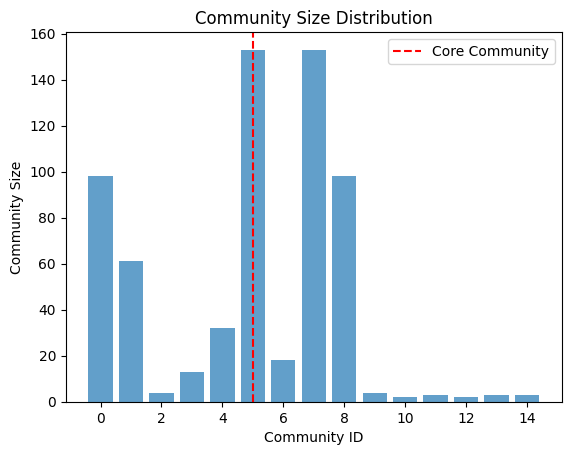

Core Community Size: 153


In [ ]:
import networkx as nx
import pandas as pd
import matplotlib.pyplot as plt
import community.community_louvain


# Create a directed graph
G = nx.Graph()

# Add edges with weights
for index, row in USA_flights.iterrows():
    G.add_edge(row['Source'], row['Target'], weight=row['Weight'])

# Detect communities using Louvain method
partition = community.community_louvain.best_partition(G, weight='Weight')

# Calculate community sizes
community_sizes = pd.Series(partition).value_counts()

# Identify the core community (largest community)
core_community = community_sizes.idxmax()

# Plot the community sizes
plt.bar(community_sizes.index, community_sizes.values, alpha=0.7)
plt.axvline(x=core_community, color='red', linestyle='--', label='Core Community')
plt.xlabel('Community ID')
plt.ylabel('Community Size')
plt.title('Community Size Distribution')
plt.legend()
plt.show()

print(f"Core Community Size: {community_sizes[core_community]}")


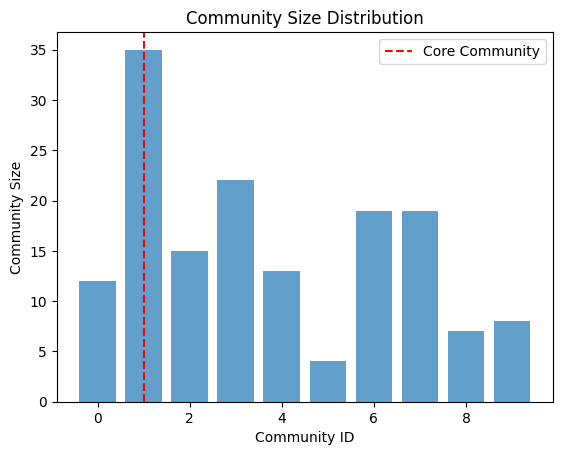

Core Community Size: 35


In [ ]:
import networkx as nx
import pandas as pd
import matplotlib.pyplot as plt
import community.community_louvain


# Create a directed graph
G = nx.Graph()

# Add edges with weights
for index, row in Aus_flights.iterrows():
    G.add_edge(row['Source'], row['Target'], weight=row['Weight'])

# Detect communities using Louvain method
partition = community.community_louvain.best_partition(G, weight='Weight')

# Calculate community sizes
community_sizes = pd.Series(partition).value_counts()

# Identify the core community (largest community)
core_community = community_sizes.idxmax()

# Plot the community sizes
plt.bar(community_sizes.index, community_sizes.values, alpha=0.7)
plt.axvline(x=core_community, color='red', linestyle='--', label='Core Community')
plt.xlabel('Community ID')
plt.ylabel('Community Size')
plt.title('Community Size Distribution')
plt.legend()
plt.show()

print(f"Core Community Size: {community_sizes[core_community]}")


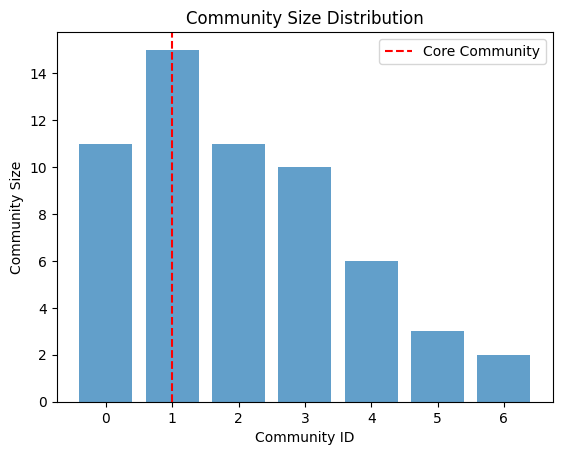

Core Community Size: 15


In [ ]:
import networkx as nx
import pandas as pd
import matplotlib.pyplot as plt
import community.community_louvain


# Create a directed graph
G = nx.Graph()

# Add edges with weights
for index, row in UK_flights.iterrows():
    G.add_edge(row['Source'], row['Target'], weight=row['Weight'])

# Detect communities using Louvain method
partition = community.community_louvain.best_partition(G, weight='Weight')

# Calculate community sizes
community_sizes = pd.Series(partition).value_counts()

# Identify the core community (largest community)
core_community = community_sizes.idxmax()

# Plot the community sizes
plt.bar(community_sizes.index, community_sizes.values, alpha=0.7)
plt.axvline(x=core_community, color='red', linestyle='--', label='Core Community')
plt.xlabel('Community ID')
plt.ylabel('Community Size')
plt.title('Community Size Distribution')
plt.legend()
plt.show()

print(f"Core Community Size: {community_sizes[core_community]}")


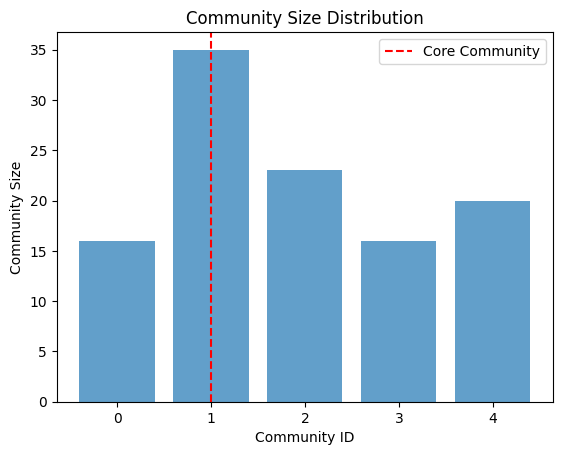

Core Community Size: 35


In [ ]:
import networkx as nx
import pandas as pd
import matplotlib.pyplot as plt
import community.community_louvain


# Create a graph
G = nx.Graph()

# Add edges with weights
for index, row in China_flights.iterrows():
    G.add_edge(row['Source'], row['Target'], weight=row['Weight'])

# Detect communities using Louvain method
partition = community.community_louvain.best_partition(G, weight='Weight')

# Calculate community sizes
community_sizes = pd.Series(partition).value_counts()

# Identify the core community (largest community)
core_community = community_sizes.idxmax()

# Plot the community sizes
plt.bar(community_sizes.index, community_sizes.values, alpha=0.7)
plt.axvline(x=core_community, color='red', linestyle='--', label='Core Community')
plt.xlabel('Community ID')
plt.ylabel('Community Size')
plt.title('Community Size Distribution')
plt.legend()
plt.show()

print(f"Core Community Size: {community_sizes[core_community]}")


In [ ]:
import networkx as nx
import geopandas as gpd
from shapely.geometry import Point, LineString
import plotly.express as px

# Assuming 'domestic_flights' has 'Source', 'Target', and 'Weight' columns
# Assuming 'domestic_airports' has 'id', 'Lat', 'Lon', and 'country' columns

# Create a directed graph
G = nx.DiGraph()

# Add edges with weights for domestic flights within each country
for index, row in domestic_flights.iterrows():
    if domestic_airports.loc[domestic_airports['id'] == row['Source'], 'country'].values[0] == domestic_airports.loc[domestic_airports['id'] == row['Target'], 'country'].values[0]:
        G.add_edge(row['Source'], row['Target'], weight=row['Weight'])

# Add nodes with latitude, longitude, and country attributes
for index, row in domestic_airports.iterrows():
    G.add_node(row['id'], pos=(row['Lon'], row['Lat ']), country=row['country'])

# Get node positions
pos = nx.get_node_attributes(G, 'pos')

# Create GeoDataFrame for airport points
gdf_airports = gpd.GeoDataFrame(domestic_airports, geometry=gpd.points_from_xy(domestic_airports['Lon'], domestic_airports['Lat ']))

# Create GeoDataFrame for flight lines
gdf_flights = gpd.GeoDataFrame(columns=['Source', 'Target', 'geometry'])
for edge in G.edges(data=True):
    source, target, data = edge
    line = LineString([pos[source], pos[target]])
    gdf_flights = pd.concat([gdf_flights, pd.DataFrame({'Source': [source], 'Target': [target], 'geometry': [line]})], ignore_index=True)

# Set the coordinate reference system (CRS) for GeoDataFrames
gdf_airports.crs = "EPSG:4326"
gdf_flights.crs = "EPSG:4326"

# Create an interactive map
fig = px.choropleth_mapbox(
    gdf_airports,
    geojson=gdf_airports.geometry,
    locations=gdf_airports.index,
    color=gdf_airports['country'],
    hover_name='id',
    mapbox_style="carto-positron",
    center={'lat': 0, 'lon': 0},
    zoom=1
)

# Add airport points and flight lines to the map
scatter_map = px.scatter_mapbox(
    gdf_airports,
    lat='Lat ',
    lon='Lon',
    text='id',
    hover_data=['country'],
    color_discrete_sequence=['red'],
    size_max=10,
    zoom=1
)

flight_lines = px.line_mapbox(
    gdf_flights,
    lat=gdf_flights.geometry.apply(lambda geom: geom.centroid.y),
    lon=gdf_flights.geometry.apply(lambda geom: geom.centroid.x),
    hover_name='Source',
    zoom=1
)

# Update map layout
scatter_map.update_traces(marker=dict(size=8))
flight_lines.update_traces(line=dict(width=0.5, color='black'))

# Combine the maps
fig.add_trace(scatter_map.data[0])
fig.add_trace(flight_lines.data[0])

# Show the plot
fig.show()


<ipython-input-64-2af581424c92>:41: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.



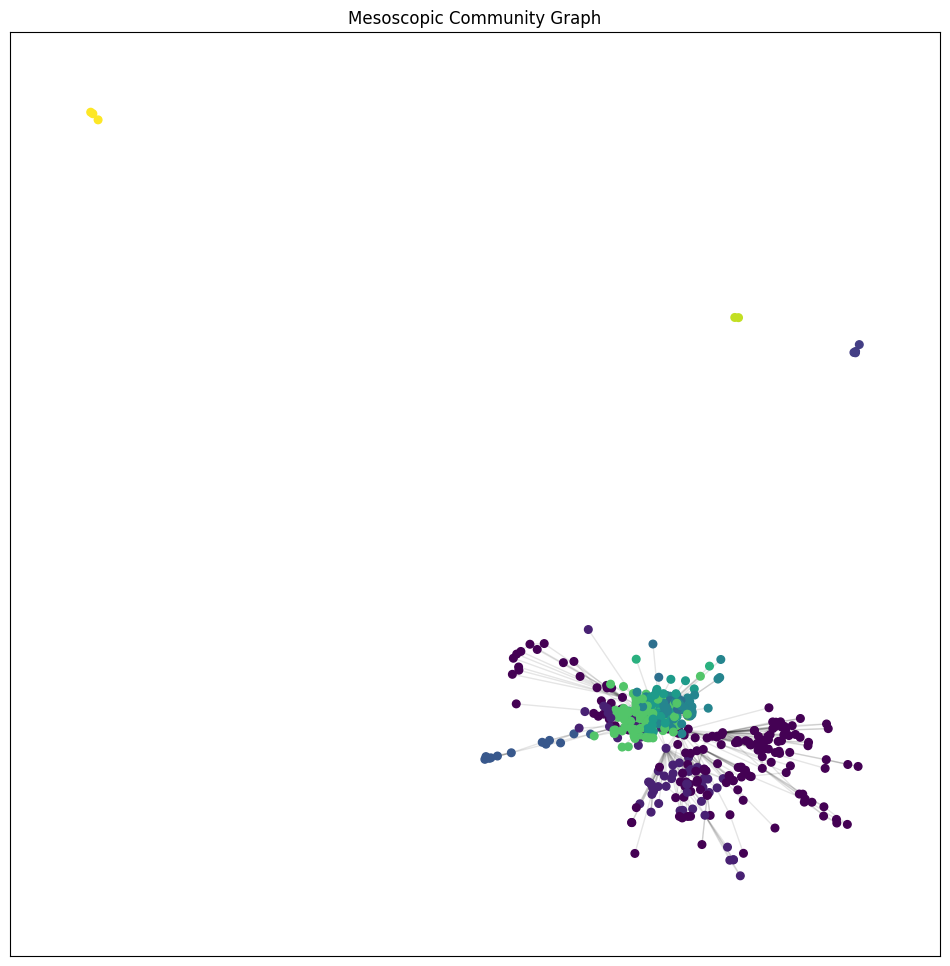

In [ ]:
import networkx as nx
import geopandas as gpd
from shapely.geometry import Point, LineString
import matplotlib.pyplot as plt
import community.community_louvain as cl

# Create an undirected graph
G = nx.Graph()

# Add edges with weights
for index, row in USA_flights.iterrows():
    G.add_edge(row['Source'], row['Target'], weight=row['Weight'])

# Community detection using Louvain algorithm
partition = cl.best_partition(G)

# Assign community information to nodes
nx.set_node_attributes(G, partition, 'community')

# Get node positions
pos = nx.spring_layout(G)  # Use a layout algorithm suitable for undirected graphs

# Create GeoDataFrame for airport points
gdf_airports = gpd.GeoDataFrame(USA_airports, geometry=gpd.points_from_xy(USA_airports['Lon'], USA_airports['Lat ']))

# Create GeoDataFrame for flight lines
gdf_flights = gpd.GeoDataFrame(columns=['Source', 'Target', 'geometry'])
for edge in G.edges(data=True):
    source, target, data = edge
    line = LineString([pos[source], pos[target]])
    gdf_flights = pd.concat([gdf_flights, pd.DataFrame({'Source': [source], 'Target': [target], 'geometry': [line]})], ignore_index=True)

# Set the coordinate reference system (CRS) for GeoDataFrames
gdf_airports.crs = "EPSG:4326"
gdf_flights.crs = "EPSG:4326"

# Plot the graph
plt.figure(figsize=(12, 12))
nx.draw_networkx_nodes(G, pos, node_size=30, node_color=list(partition.values()), cmap=plt.cm.get_cmap('viridis'))
nx.draw_networkx_edges(G, pos, alpha=0.1)
plt.title('Mesoscopic Community Graph')
plt.show()


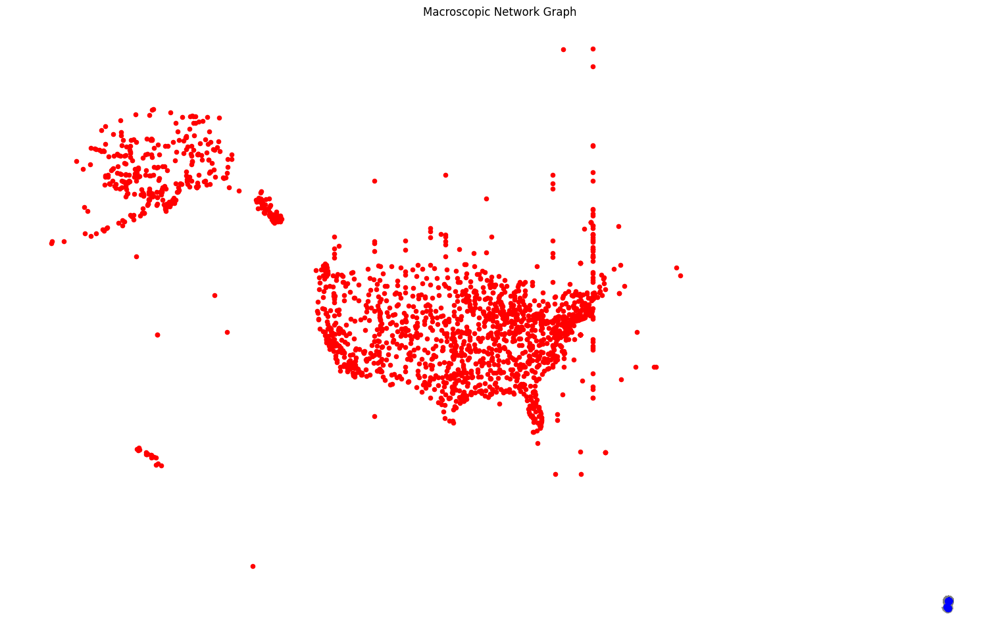

In [ ]:
import networkx as nx
import geopandas as gpd
from shapely.geometry import Point, LineString
import matplotlib.pyplot as plt

# Assuming 'USA_flights' has 'Source', 'Target', and 'Weight' columns
# Assuming 'USA_airports' has 'id', 'Lat', 'Lon', and 'country' columns

# Create a directed graph
G = nx.DiGraph()

# Add edges with weights
for index, row in USA_flights.iterrows():
    G.add_edge(row['Source'], row['Target'], weight=row['Weight'])

# Get node positions using Kamada-Kawai layout
pos = nx.kamada_kawai_layout(G)

# Create GeoDataFrame for airport points
gdf_airports = gpd.GeoDataFrame(USA_airports, geometry=gpd.points_from_xy(USA_airports['Lon'], USA_airports['Lat ']))

# Set the coordinate reference system (CRS) for GeoDataFrames
gdf_airports.crs = "EPSG:4326"

# Plot the macroscopic network graph
plt.figure(figsize=(15, 15))
nx.draw(G, pos, with_labels=False, node_size=50, alpha=0.7, edge_color='gray', node_color='blue', font_size=8)

# Add airport points on top
gdf_airports.plot(ax=plt.gca(), color='red', markersize=20)

plt.title('Macroscopic Network Graph')
plt.show()


#Data Analysis - USA

In [ ]:
import networkx as nx
import pandas as pd

# Load your USA_flights data (replace 'your_file.csv' with the actual file path)
USA_flights = pd.read_excel('/content/drive/MyDrive/us_flights.xlsx')

# Create a directed graph from the dataframe
G = nx.from_pandas_edgelist(USA_flights, 'Source City', 'Target City', ['Weight'], create_using=nx.Graph())

# Calculate degree centrality
degree_centrality = nx.degree_centrality(G)

# Calculate betweenness centrality
betweenness_centrality = nx.betweenness_centrality(G, weight='Weight')

# Calculate eigenvector centrality
eigenvector_centrality = nx.eigenvector_centrality(G, weight='Weight')

# Identify hubs based on degree centrality (adjust threshold as needed)
degree_hubs = [node for node, centrality in degree_centrality.items() if centrality > 0.2]

# Identify hubs based on betweenness centrality (adjust threshold as needed)
betweenness_hubs = [node for node, centrality in betweenness_centrality.items() if centrality > 0.2]

# Identify hubs based on eigenvector centrality (adjust threshold as needed)
eigenvector_hubs = [node for node, centrality in eigenvector_centrality.items() if centrality > 0.2]

# Print or use the results as needed
print("Degree Hubs:", degree_hubs)
print("Betweenness Hubs:", betweenness_hubs)
print("Eigenvector Hubs:", eigenvector_hubs)


Degree Hubs: ['Chicago', 'Atlanta']
Betweenness Hubs: ['Anchorage', 'Fairbanks', 'Seattle', 'Houston']
Eigenvector Hubs: ['Chicago', 'Atlanta', 'Baltimore', 'Phoenix']


In [ ]:
len(G.nodes()),len(G.edges())

(628, 2739)

In [ ]:
nx.density(G)

0.01391216895742541

In [ ]:
list(G.neighbors('Chicago'))

['Anchorage',
 'Atlanta',
 'Austin',
 'Kalamazoo',
 'Dubuque',
 'Hartford',
 'Nashville',
 'Boston',
 'Chattanooga',
 'Charlotte',
 'Dayton',
 'Denver',
 'Dallas/Fort Worth',
 'Las Vegas',
 'Des Moines',
 'Cincinnati',
 'Albany (US) NY',
 'Albuquerque',
 'New York',
 'Grand Rapids (US) MI',
 'Greenville (US) SC',
 'Houston',
 'Cleveland',
 'Baltimore',
 'Columbus (US) OH',
 'Kansas City',
 'Buffalo',
 'Memphis',
 'Westchester County',
 'Washington',
 'Detroit',
 'Green Bay',
 'Champaign',
 'Evansville',
 'Orlando',
 'Fort Lauderdale',
 'Huntsville',
 'Marquette',
 'Madison',
 'Fort Wayne',
 'Honolulu',
 'Norfolk',
 'Rochester (US) MN',
 'San Antonio',
 'Santa Ana',
 'Poughkeepsie',
 'Fayetteville (US) AR',
 'Cedar Rapids',
 'Indianapolis',
 'Portland (US) OR',
 'Peoria',
 'San Jose (US)',
 'Syracuse',
 'Harrisburg',
 'Minneapolis/St Paul',
 'Milwaukee',
 'Los Angeles',
 'Seattle',
 'Toledo',
 'Traverse City',
 'New Orleans',
 'Tampa',
 'Oklahoma City',
 'El Paso',
 'Pittsburgh',
 'St L

In [ ]:
degree_dict=dict(G.degree(G.nodes()))

In [ ]:
import networkx as nx

# Assuming 'G' is your networkx graph
neighbors_ranking = {}

for node in G.nodes():
    neighbors = list(G.neighbors(node))
    neighbors_ranking[node] = sorted(neighbors, key=lambda x: G.degree(x), reverse=True)

# Print each node and its rank-ordered neighbors on a separate line
for node, ranking in neighbors_ranking.items():
    print(f"Node {node}: {ranking}")


Node Seldovia: ['Homer', 'Port Graham', 'Nanwalek']
Node Nanwalek: ['Seldovia', 'Port Graham']
Node Homer: ['Anchorage', 'Seldovia', 'Port Graham']
Node Port Graham: ['Homer', 'Seldovia', 'Nanwalek']
Node Allakaket: ['Fairbanks', 'Anaktuvuk Pass', 'Bettles', 'Hughes', 'Utopia Creek']
Node Anaktuvuk Pass: ['Fairbanks', 'Allakaket', 'Bettles']
Node Anchorage: ['Atlanta', 'Chicago', 'Dallas/Fort Worth', 'Minneapolis/St Paul', 'Denver', 'Detroit', 'Houston', 'New York', 'St Louis', 'Seattle', 'Los Angeles', 'Salt Lake City', 'San Francisco', 'Portland (US) OR', 'Fairbanks', 'Bethel', 'Nome', 'Juneau', 'Kotzebue', 'Dillingham', 'King Salmon', 'Galena', 'Aniak', 'Emmonak', 'Unalakleet', 'Mcgrath', 'St Marys', 'Iliamna', 'Prudhoe Bay/Deadhorse', 'Cold Bay', 'Homer', 'Cordova', 'Dutch Harbor', 'St Paul Island', 'St George Island', 'Kenai', 'Kodiak', 'Valdez', 'Sand Point']
Node Galena: ['Anchorage', 'Fairbanks', 'Tanana', 'Huslia', 'Nulato', 'Ruby', 'Koyuk', 'Kaltag', 'Koyukuk']
Node Aniak: ['

In [ ]:
degree_centrality = pd.Series(nx.degree_centrality(G))
degree_centrality.sort_values(ascending=False)


Atlanta                0.221691
Chicago                0.205742
Dallas/Fort Worth      0.196172
Minneapolis/St Paul    0.188198
Denver                 0.183413
                         ...   
Meridian               0.001595
Hoonah                 0.001595
Tetlin                 0.001595
Healy Lake             0.001595
Atka                   0.001595
Length: 628, dtype: float64

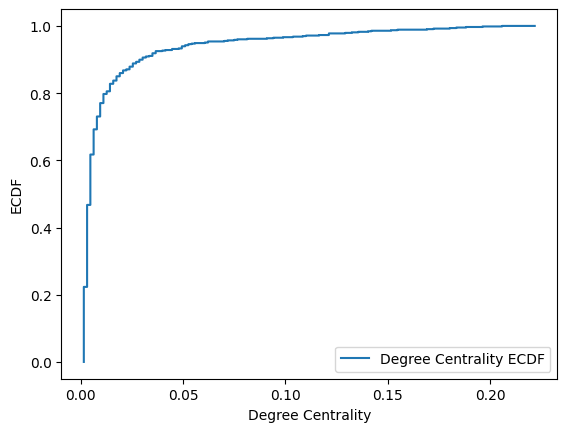

In [ ]:
import networkx as nx
import matplotlib.pyplot as plt
import numpy as np

# Assuming 'G' is your networkx graph
degree_centrality = nx.degree_centrality(G)

# Compute the ECDF
sorted_degree_centrality = sorted(degree_centrality.values())
ecdf_values = np.linspace(0, 1, len(sorted_degree_centrality))

# Plot the ECDF
plt.step(sorted_degree_centrality, ecdf_values, label='Degree Centrality ECDF')
plt.xlabel('Degree Centrality')
plt.ylabel('ECDF')
plt.legend()
plt.show()


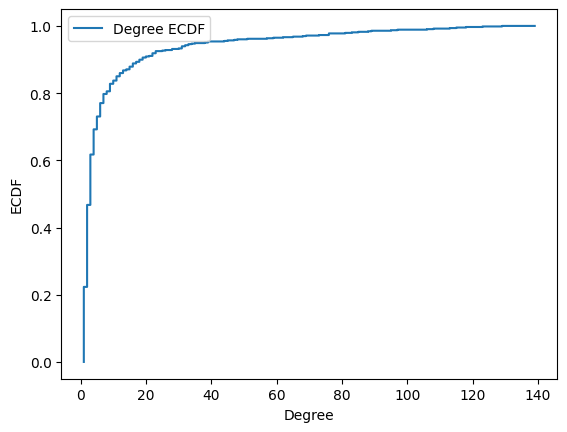

In [ ]:
import networkx as nx
import matplotlib.pyplot as plt
import numpy as np

# Assuming 'G' is your networkx graph
degree_sequence = [d for n, d in G.degree()]

# Compute the ECDF
sorted_degrees = sorted(degree_sequence)
ecdf_values = np.linspace(0, 1, len(sorted_degrees))

# Plot the ECDF
plt.step(sorted_degrees, ecdf_values, label='Degree ECDF')
plt.xlabel('Degree')
plt.ylabel('ECDF')
plt.legend()
plt.show()


In [ ]:
import csv
from operator import itemgetter
import networkx as nx
from networkx.algorithms import community

sorted_degree=sorted(degree_dict.items(),key=itemgetter(1),reverse=True)

In [ ]:
sorted_degree

[('Atlanta', 139),
 ('Chicago', 129),
 ('Dallas/Fort Worth', 123),
 ('Minneapolis/St Paul', 118),
 ('Denver', 115),
 ('Cincinnati', 113),
 ('Detroit', 108),
 ('Houston', 106),
 ('New York', 97),
 ('Pittsburgh', 95),
 ('Charlotte', 89),
 ('St Louis', 88),
 ('Phoenix', 85),
 ('Philadelphia', 83),
 ('Seattle', 81),
 ('Washington', 76),
 ('Las Vegas', 76),
 ('Memphis', 76),
 ('Orlando', 73),
 ('Cleveland', 69),
 ('Los Angeles', 68),
 ('Salt Lake City', 65),
 ('Baltimore', 62),
 ('Boston', 59),
 ('San Francisco', 57),
 ('Tampa', 51),
 ('Kansas City', 48),
 ('Milwaukee', 47),
 ('Portland (US) OR', 45),
 ('Nashville', 44),
 ('Anchorage', 39),
 ('Fort Lauderdale', 39),
 ('San Diego', 38),
 ('Miami', 35),
 ('Fairbanks', 34),
 ('Albuquerque', 33),
 ('New Orleans', 33),
 ('Raleigh/Durham', 32),
 ('Indianapolis', 32),
 ('Bethel', 31),
 ('Honolulu', 31),
 ('Albany (US) NY', 31),
 ('Oakland', 31),
 ('San Jose (US)', 30),
 ('Hartford', 28),
 ('Columbus (US) OH', 28),
 ('Austin', 26),
 ('Santa Ana', 2

In [ ]:
print("Top 20 nodes by degree:")
for d in sorted_degree[:20]:
    print(d)


Top 20 nodes by degree:
('Atlanta', 139)
('Chicago', 129)
('Dallas/Fort Worth', 123)
('Minneapolis/St Paul', 118)
('Denver', 115)
('Cincinnati', 113)
('Detroit', 108)
('Houston', 106)
('New York', 97)
('Pittsburgh', 95)
('Charlotte', 89)
('St Louis', 88)
('Phoenix', 85)
('Philadelphia', 83)
('Seattle', 81)
('Washington', 76)
('Las Vegas', 76)
('Memphis', 76)
('Orlando', 73)
('Cleveland', 69)


In [ ]:
betweenness_dict = nx.betweenness_centrality(G) # Run betweenness centrality
eigenvector_dict = nx.eigenvector_centrality(G) # Run eigenvector centrality

# Assign each to an attribute in your network
nx.set_node_attributes(G, betweenness_dict, 'betweenness')
nx.set_node_attributes(G, eigenvector_dict, 'eigenvector')


In [ ]:
sorted_betweenness = sorted(betweenness_dict.items(), key=itemgetter(1), reverse=True)

print("Top 20 nodes by betweenness centrality:")
for b in sorted_betweenness[:20]:
    print(b)


Top 20 nodes by betweenness centrality:
('Anchorage', 0.3877246404611795)
('Seattle', 0.16617542817590278)
('Minneapolis/St Paul', 0.14217445930710784)
('Denver', 0.12040708102775988)
('Fairbanks', 0.11552590374314466)
('Bethel', 0.08979865070751235)
('Dallas/Fort Worth', 0.0854065716149742)
('Atlanta', 0.07794612305810299)
('Pittsburgh', 0.059313118254263636)
('St Louis', 0.05660218153343624)
('Chicago', 0.055050567110137255)
('Ketchikan', 0.04988513858952731)
('Houston', 0.04548701160118781)
('Detroit', 0.045386598635672015)
('Nome', 0.043619402803820845)
('Juneau', 0.04305604958045776)
('King Salmon', 0.04085414426763006)
('Salt Lake City', 0.036217819833225647)
('Dillingham', 0.03510117995152466)
('Kotzebue', 0.032666846996214596)


In [ ]:
sorted_eigenvector = sorted(eigenvector_dict.items(), key=itemgetter(1), reverse=True)

print("Top 20 nodes by eigenvector centrality:")
for b in sorted_eigenvector[:20]:
    print(b)


Top 20 nodes by eigenvector centrality:
('Atlanta', 0.20017402358095854)
('Chicago', 0.19969084196943263)
('Cincinnati', 0.18743964645520222)
('Dallas/Fort Worth', 0.18276783455864395)
('Detroit', 0.18072552609269285)
('New York', 0.18051557422735276)
('Houston', 0.1803451390560286)
('Minneapolis/St Paul', 0.17667096356409986)
('St Louis', 0.15749891410542585)
('Washington', 0.15718020842603092)
('Charlotte', 0.15716467418973387)
('Phoenix', 0.15716293265485484)
('Philadelphia', 0.15682921188386484)
('Las Vegas', 0.1556662492121708)
('Pittsburgh', 0.15548954091731987)
('Denver', 0.1546692293202085)
('Orlando', 0.15037237203522338)
('Cleveland', 0.14891804541456766)
('Memphis', 0.14331120328338937)
('Baltimore', 0.14228514052939742)


In [ ]:
#First get the top 20 nodes by betweenness as a list
top_betweenness = sorted_betweenness[:20]

#Then find and print their degree
for tb in top_betweenness: # Loop through top_betweenness
    degree = degree_dict[tb[0]] # Use degree_dict to access a node's degree, see footnote 2
    print("Name:", tb[0], "| Betweenness Centrality:", tb[1], "| Degree:", degree)


Name: Anchorage | Betweenness Centrality: 0.3877246404611795 | Degree: 39
Name: Seattle | Betweenness Centrality: 0.16617542817590278 | Degree: 81
Name: Minneapolis/St Paul | Betweenness Centrality: 0.14217445930710784 | Degree: 118
Name: Denver | Betweenness Centrality: 0.12040708102775988 | Degree: 115
Name: Fairbanks | Betweenness Centrality: 0.11552590374314466 | Degree: 34
Name: Bethel | Betweenness Centrality: 0.08979865070751235 | Degree: 31
Name: Dallas/Fort Worth | Betweenness Centrality: 0.0854065716149742 | Degree: 123
Name: Atlanta | Betweenness Centrality: 0.07794612305810299 | Degree: 139
Name: Pittsburgh | Betweenness Centrality: 0.059313118254263636 | Degree: 95
Name: St Louis | Betweenness Centrality: 0.05660218153343624 | Degree: 88
Name: Chicago | Betweenness Centrality: 0.055050567110137255 | Degree: 129
Name: Ketchikan | Betweenness Centrality: 0.04988513858952731 | Degree: 19
Name: Houston | Betweenness Centrality: 0.04548701160118781 | Degree: 106
Name: Detroit |

In [ ]:
communities = community.greedy_modularity_communities(G)


In [ ]:
top_5communities=communities[:5]
top_5communities

[frozenset({'Abilene',
            'Alamosa',
            'Albuquerque',
            'Alexandria (US)',
            'Alliance',
            'Amarillo',
            'Arcata/Eureka',
            'Aspen',
            'Austin',
            'Bakersfield',
            'Baton Rouge',
            'Beaumont',
            'Billings',
            'Bismarck',
            'Boise',
            'Bozeman',
            'Brownsville',
            'Brownwood',
            'Bullhead City',
            'Burbank',
            'Butte',
            'Carlsbad',
            'Casper',
            'Cedar City',
            'Chadron',
            'Cheyenne',
            'Chico',
            'Clovis',
            'Cody',
            'College Station',
            'Colorado Springs',
            'Columbus',
            'Corpus Christi',
            'Cortez',
            'Crescent City',
            'Dallas/Fort Worth',
            'Denver',
            'Des Moines',
            'Dickinson',
            'Dodge City',

In [ ]:
# Compute PageRank scores
pagerank_scores = nx.pagerank(G, weight='Weight')

# Print or use the PageRank scores as needed
for node, score in pagerank_scores.items():
    print(f"Node: {node}, PageRank Score: {score}")


Node: Seldovia, PageRank Score: 0.0013093730272811894
Node: Nanwalek, PageRank Score: 0.001529199336681118
Node: Homer, PageRank Score: 0.0009254177915047991
Node: Port Graham, PageRank Score: 0.001822990612170128
Node: Allakaket, PageRank Score: 0.0007578689224768854
Node: Anaktuvuk Pass, PageRank Score: 0.0004570398780258928
Node: Anchorage, PageRank Score: 0.024758206777945973
Node: Galena, PageRank Score: 0.0016592643805385348
Node: Aniak, PageRank Score: 0.0026205167764734067
Node: Shageluk, PageRank Score: 0.0008712793195388714
Node: Barter Island, PageRank Score: 0.0004832616594064468
Node: Fairbanks, PageRank Score: 0.009879879631972439
Node: Prudhoe Bay/Deadhorse, PageRank Score: 0.0011358393115323564
Node: Russian Mission, PageRank Score: 0.0010456592403126916
Node: Holy Cross, PageRank Score: 0.000956918007121348
Node: Bethel, PageRank Score: 0.008037389940295072
Node: Wainwright, PageRank Score: 0.0007548473316472164
Node: Barrow, PageRank Score: 0.0024336059939624338
Node:

In [ ]:
# Sort PageRank scores
sorted_pagerank = sorted(pagerank_scores.items(), key=lambda x: x[1], reverse=True)

# Print top 20 PageRank scores
print("Top 20 PageRank Scores:")
for i, (node, score) in enumerate(sorted_pagerank[:20], 1):
    print(f"{i}. Node: {node}, PageRank Score: {score:.4f}")


Top 20 PageRank Scores:
1. Node: Atlanta, PageRank Score: 0.0287
2. Node: Chicago, PageRank Score: 0.0250
3. Node: Anchorage, PageRank Score: 0.0248
4. Node: Minneapolis/St Paul, PageRank Score: 0.0221
5. Node: Dallas/Fort Worth, PageRank Score: 0.0221
6. Node: Denver, PageRank Score: 0.0213
7. Node: Seattle, PageRank Score: 0.0179
8. Node: Detroit, PageRank Score: 0.0171
9. Node: St Louis, PageRank Score: 0.0161
10. Node: Baltimore, PageRank Score: 0.0155
11. Node: Phoenix, PageRank Score: 0.0153
12. Node: Houston, PageRank Score: 0.0146
13. Node: Los Angeles, PageRank Score: 0.0140
14. Node: Charlotte, PageRank Score: 0.0133
15. Node: New York, PageRank Score: 0.0127
16. Node: Salt Lake City, PageRank Score: 0.0127
17. Node: Pittsburgh, PageRank Score: 0.0126
18. Node: Cincinnati, PageRank Score: 0.0122
19. Node: Las Vegas, PageRank Score: 0.0117
20. Node: Boston, PageRank Score: 0.0112


#Data Analysis -UK

In [ ]:
UK_flights

,Source,Source City,Source Country,Target,Target City,Target Country,Weight
0,EMA,Nottingham,United Kingdom,IOM,Isle of Man,United Kingdom,513
1,IOM,Isle of Man,United Kingdom,EMA,Nottingham,United Kingdom,513
2,EDI,Edinburgh,United Kingdom,IOM,Isle of Man,United Kingdom,1026
3,IOM,Isle of Man,United Kingdom,EDI,Edinburgh,United Kingdom,1026
4,IOM,Isle of Man,United Kingdom,LPL,Liverpool,United Kingdom,3154
...,...,...,...,...,...,...,...
631,EMA,Nottingham,United Kingdom,BFS,Belfast,United Kingdom,5895
632,EMA,Nottingham,United Kingdom,JER,Jersey,United Kingdom,4061
633,JER,Jersey,United Kingdom,EMA,Nottingham,United Kingdom,4061
634,MAN,Manchester (GB),United Kingdom,BFS,Belfast,United Kingdom,11988


In [ ]:
import networkx as nx
import pandas as pd


# Create a directed graph from the dataframe
G1 = nx.from_pandas_edgelist(UK_flights, 'Source City', 'Target City', ['Weight'], create_using=nx.Graph())

# Calculate degree centrality
degree_centrality = nx.degree_centrality(G1)

# Calculate betweenness centrality
betweenness_centrality = nx.betweenness_centrality(G1, weight='Weight')

# Calculate eigenvector centrality
eigenvector_centrality = nx.eigenvector_centrality(G1, weight='Weight')

# Identify hubs based on degree centrality (adjust threshold as needed)
degree_hubs = [node for node, centrality in degree_centrality.items() if centrality > 0.2]

# Identify hubs based on betweenness centrality (adjust threshold as needed)
betweenness_hubs = [node for node, centrality in betweenness_centrality.items() if centrality > 0.2]

# Identify hubs based on eigenvector centrality (adjust threshold as needed)
eigenvector_hubs = [node for node, centrality in eigenvector_centrality.items() if centrality > 0.2]

# Print or use the results as needed
print("Degree Hubs:", degree_hubs)
print("Betweenness Hubs:", betweenness_hubs)
print("Eigenvector Hubs:", eigenvector_hubs)


Degree Hubs: ['Isle of Man', 'Edinburgh', 'Belfast', 'Jersey', 'London (GB)', 'Glasgow (GB)', 'Aberdeen (GB)', 'Kirkwall', 'Manchester (GB)']
Betweenness Hubs: ['Jersey', 'Glasgow (GB)', 'Aberdeen (GB)', 'Kirkwall', 'Manchester (GB)', 'Wick']
Eigenvector Hubs: ['Edinburgh', 'Liverpool', 'Belfast', 'London (GB)', 'Glasgow (GB)', 'Manchester (GB)', 'Bristol']


In [ ]:
len(G1.nodes()),len(G1.edges())


(50, 141)

In [ ]:
nx.density(G1)


0.11510204081632654

In [ ]:
degree_dict_uk=dict(G1.degree(G1.nodes()))


In [ ]:
neighbors_ranking = {}

for node in G1.nodes():
    neighbors = list(G1.neighbors(node))
    neighbors_ranking[node] = sorted(neighbors, key=lambda x: G1.degree(x), reverse=True)

# Print each node and its rank-ordered neighbors on a separate line
for node, ranking in neighbors_ranking.items():
    print(f"Node {node}: {ranking}")


Node Nottingham: ['Glasgow (GB)', 'Jersey', 'Belfast', 'Edinburgh', 'Aberdeen (GB)', 'Isle of Man', 'Guernsey']
Node Isle of Man: ['Glasgow (GB)', 'London (GB)', 'Belfast', 'Edinburgh', 'Manchester (GB)', 'Birmingham (GB)', 'Bristol', 'Newcastle (GB)', 'Leeds Bradford', 'Nottingham', 'Blackpool', 'Liverpool']
Node Edinburgh: ['London (GB)', 'Jersey', 'Belfast', 'Isle of Man', 'Manchester (GB)', 'Birmingham (GB)', 'Southampton', 'Bristol', 'Leeds Bradford', 'Nottingham', 'Inverness', 'Cardiff', 'Shetland Islands', 'Stornoway', 'Wick', 'Norwich']
Node Liverpool: ['Belfast', 'Isle of Man']
Node Belfast: ['Glasgow (GB)', 'London (GB)', 'Jersey', 'Edinburgh', 'Aberdeen (GB)', 'Isle of Man', 'Manchester (GB)', 'Southampton', 'Birmingham (GB)', 'Leeds Bradford', 'Newcastle (GB)', 'Bristol', 'Nottingham', 'Cardiff', 'Exeter', 'Blackpool', 'Liverpool']
Node Blackpool: ['London (GB)', 'Belfast', 'Isle of Man']
Node Cardiff: ['Glasgow (GB)', 'Jersey', 'London (GB)', 'Belfast', 'Edinburgh', 'Swans

In [ ]:
degree_centrality_uk = pd.Series(nx.degree_centrality(G1))
degree_centrality_uk.sort_values(ascending=False)


Glasgow (GB)        0.428571
Jersey              0.367347
London (GB)         0.367347
Belfast             0.346939
Edinburgh           0.326531
Aberdeen (GB)       0.285714
Isle of Man         0.244898
Manchester (GB)     0.244898
Kirkwall            0.204082
Southampton         0.183673
Guernsey            0.183673
Birmingham (GB)     0.183673
Leeds Bradford      0.163265
Bristol             0.163265
Newcastle (GB)      0.163265
Nottingham          0.142857
Cardiff             0.122449
Inverness           0.122449
Stronsay            0.081633
Shetland Islands    0.081633
North Ronaldsay     0.081633
Papa Westray        0.081633
Plymouth            0.081633
Exeter              0.081633
Wick                0.061224
Teesside            0.061224
Derry               0.061224
Norwich             0.061224
Blackpool           0.061224
Stornoway           0.061224
Sanday              0.061224
Alderney            0.061224
Westray             0.061224
Newquay             0.040816
Liverpool     

In [ ]:
import csv
from operator import itemgetter
import networkx as nx
from networkx.algorithms import community

sorted_degree=sorted(degree_dict_uk.items(),key=itemgetter(1),reverse=True)
sorted_degree

[('Glasgow (GB)', 21),
 ('Jersey', 18),
 ('London (GB)', 18),
 ('Belfast', 17),
 ('Edinburgh', 16),
 ('Aberdeen (GB)', 14),
 ('Isle of Man', 12),
 ('Manchester (GB)', 12),
 ('Kirkwall', 10),
 ('Birmingham (GB)', 9),
 ('Southampton', 9),
 ('Guernsey', 9),
 ('Newcastle (GB)', 8),
 ('Bristol', 8),
 ('Leeds Bradford', 8),
 ('Nottingham', 7),
 ('Cardiff', 6),
 ('Inverness', 6),
 ('Plymouth', 4),
 ('Shetland Islands', 4),
 ('Papa Westray', 4),
 ('North Ronaldsay', 4),
 ('Stronsay', 4),
 ('Exeter', 4),
 ('Blackpool', 3),
 ('Wick', 3),
 ('Stornoway', 3),
 ('Westray', 3),
 ('Derry', 3),
 ('Sanday', 3),
 ('Teesside', 3),
 ('Norwich', 3),
 ('Alderney', 3),
 ('Liverpool', 2),
 ('Swansea', 2),
 ('Benbecula', 2),
 ('Eday', 2),
 ('Barra', 2),
 ('Newquay', 2),
 ('Manston', 1),
 ('Southend', 1),
 ('Islay', 1),
 ('Tiree', 1),
 ('Campbeltown', 1),
 ('Fair Isle', 1),
 ('Penzance', 1),
 ('Isles of Scilly', 1),
 ('Dundee', 1),
 ('Bournemouth', 1),
 ('Humberside', 1)]

In [ ]:
betweenness_dict_uk = nx.betweenness_centrality(G1) # Run betweenness centrality
eigenvector_dict_uk = nx.eigenvector_centrality(G1) # Run eigenvector centrality


In [ ]:
# Assign each to an attribute in your network
nx.set_node_attributes(G1, betweenness_dict_uk, 'betweenness')
nx.set_node_attributes(G1, eigenvector_dict_uk, 'eigenvector')



In [ ]:
sorted_betweenness_uk = sorted(betweenness_dict_uk.items(), key=itemgetter(1), reverse=True)


In [ ]:
#First get the top 20 nodes by betweenness as a list
top_betweenness_uk = sorted_betweenness_uk[:20]

#Then find and print their degree
for tb in top_betweenness_uk: # Loop through top_betweenness
    degree = degree_dict_uk[tb[0]] # Use degree_dict to access a node's degree, see footnote 2
    print("Name:", tb[0], "| Betweenness Centrality:", tb[1], "| Degree:", degree)


Name: Glasgow (GB) | Betweenness Centrality: 0.25023028530909686 | Degree: 21
Name: Aberdeen (GB) | Betweenness Centrality: 0.21474957139318165 | Degree: 14
Name: Kirkwall | Betweenness Centrality: 0.20521541950113376 | Degree: 10
Name: London (GB) | Betweenness Centrality: 0.1381894220246111 | Degree: 18
Name: Edinburgh | Betweenness Centrality: 0.08058890838250832 | Degree: 16
Name: Jersey | Betweenness Centrality: 0.07768426521673441 | Degree: 18
Name: Inverness | Betweenness Centrality: 0.06527724093364567 | Degree: 6
Name: Belfast | Betweenness Centrality: 0.06298343519439706 | Degree: 17
Name: Shetland Islands | Betweenness Centrality: 0.04350130168165132 | Degree: 4
Name: Manchester (GB) | Betweenness Centrality: 0.03069551325148006 | Degree: 12
Name: Isle of Man | Betweenness Centrality: 0.020481776349123283 | Degree: 12
Name: Birmingham (GB) | Betweenness Centrality: 0.016134253143906235 | Degree: 9
Name: Southampton | Betweenness Centrality: 0.014555449107374713 | Degree: 9
N

In [ ]:
sorted_eigenvector_uk = sorted(eigenvector_dict_uk.items(), key=itemgetter(1), reverse=True)


In [ ]:
print("Top 20 nodes by eigenvector centrality:")
for b in sorted_eigenvector_uk[:20]:
    print(b)


Top 20 nodes by eigenvector centrality:
('Belfast', 0.32891289646749067)
('Jersey', 0.31499947282556495)
('Glasgow (GB)', 0.30691650293803957)
('London (GB)', 0.3010357540834365)
('Edinburgh', 0.2777992842385831)
('Manchester (GB)', 0.25046364187725223)
('Isle of Man', 0.24381571993473578)
('Aberdeen (GB)', 0.21735682754440142)
('Leeds Bradford', 0.20845220892377994)
('Birmingham (GB)', 0.2041646858254471)
('Southampton', 0.20094576079411908)
('Newcastle (GB)', 0.18955185906047492)
('Bristol', 0.18182350160906746)
('Nottingham', 0.176924181029562)
('Guernsey', 0.17047872104976103)
('Cardiff', 0.14968363958027517)
('Inverness', 0.11869758285029706)
('Exeter', 0.09687080111696354)
('Blackpool', 0.08310039497751696)
('Derry', 0.08164076116163228)


In [ ]:
sorted_betweenness_uk = sorted(betweenness_dict_uk.items(), key=itemgetter(1), reverse=True)

print("Top 20 nodes by betweenness centrality:")
for b in sorted_betweenness_uk[:20]:
    print(b)


Top 20 nodes by betweenness centrality:
('Glasgow (GB)', 0.25023028530909686)
('Aberdeen (GB)', 0.21474957139318165)
('Kirkwall', 0.20521541950113376)
('London (GB)', 0.1381894220246111)
('Edinburgh', 0.08058890838250832)
('Jersey', 0.07768426521673441)
('Inverness', 0.06527724093364567)
('Belfast', 0.06298343519439706)
('Shetland Islands', 0.04350130168165132)
('Manchester (GB)', 0.03069551325148006)
('Isle of Man', 0.020481776349123283)
('Birmingham (GB)', 0.016134253143906235)
('Southampton', 0.014555449107374713)
('Cardiff', 0.011695745347031949)
('Guernsey', 0.010414032484473562)
('Bristol', 0.008449373755496205)
('Nottingham', 0.006437001227266561)
('Newcastle (GB)', 0.006149788440053774)
('Wick', 0.006086335695256752)
('Leeds Bradford', 0.0044548186328390695)


In [ ]:
# Compute PageRank scores
pagerank_scores_uk = nx.pagerank(G1, weight='Weight')

# Print or use the PageRank scores as needed
for node, score in pagerank_scores_uk.items():
    print(f"Node: {node}, PageRank Score: {score}")

# Sort PageRank scores
sorted_pagerank_uk = sorted(pagerank_scores_uk.items(), key=lambda x: x[1], reverse=True)

# Print top 20 PageRank scores
print("Top 20 PageRank Scores:")
for i, (node, score) in enumerate(sorted_pagerank_uk[:20], 1):
    print(f"{i}. Node: {node}, PageRank Score: {score:.4f}")



Node: Nottingham, PageRank Score: 0.023017922670567435
Node: Isle of Man, PageRank Score: 0.020073076430012635
Node: Edinburgh, PageRank Score: 0.06508897789178023
Node: Liverpool, PageRank Score: 0.024935282532388327
Node: Belfast, PageRank Score: 0.08027789647448239
Node: Blackpool, PageRank Score: 0.007625576943572137
Node: Cardiff, PageRank Score: 0.025462554747542436
Node: Jersey, PageRank Score: 0.02793296759069512
Node: Plymouth, PageRank Score: 0.00976651157568105
Node: Swansea, PageRank Score: 0.005795939051848272
Node: London (GB), PageRank Score: 0.10953727153679226
Node: Manston, PageRank Score: 0.02
Node: Southend, PageRank Score: 0.02
Node: Glasgow (GB), PageRank Score: 0.08247105544056102
Node: Islay, PageRank Score: 0.004334206351576345
Node: Aberdeen (GB), PageRank Score: 0.04604336960247282
Node: Benbecula, PageRank Score: 0.005876333010597524
Node: Shetland Islands, PageRank Score: 0.016380681768515676
Node: Kirkwall, PageRank Score: 0.029705208393685838
Node: Invern

#Data Analytics - China

In [ ]:
import networkx as nx
import pandas as pd


# Create a directed graph from the dataframe
G2 = nx.from_pandas_edgelist(China_flights, 'Source City', 'Target City', ['Weight'], create_using=nx.Graph())

# Calculate degree centrality
degree_centrality = nx.degree_centrality(G2)

# Calculate betweenness centrality
betweenness_centrality = nx.betweenness_centrality(G2, weight='Weight')

# Calculate eigenvector centrality
eigenvector_centrality = nx.eigenvector_centrality(G2, weight='Weight')

# Identify hubs based on degree centrality (adjust threshold as needed)
degree_hubs = [node for node, centrality in degree_centrality.items() if centrality > 0.2]

# Identify hubs based on betweenness centrality (adjust threshold as needed)
betweenness_hubs = [node for node, centrality in betweenness_centrality.items() if centrality > 0.2]

# Identify hubs based on eigenvector centrality (adjust threshold as needed)
eigenvector_hubs = [node for node, centrality in eigenvector_centrality.items() if centrality > 0.2]

# Print or use the results as needed
print("Degree Hubs:", degree_hubs)
print("Betweenness Hubs:", betweenness_hubs)
print("Eigenvector Hubs:", eigenvector_hubs)


Degree Hubs: ['Beijing', 'Shanghai', 'Guangzhou', 'Chongqing', 'Chengdu', 'Changsha', 'Fuzhou', 'Hangzhou', 'Shenzhen', 'Haikou', 'Dalian', 'Kunming', 'Urumqi', 'Qingdao', 'Nanjing', 'Xiamen', "Xi'an", 'Shenyang', 'Jinan']
Betweenness Hubs: ['Beijing', 'Chongqing', 'Kunming']
Eigenvector Hubs: ['Beijing', 'Shanghai', 'Guangzhou', 'Shenzhen']


In [ ]:
len(G2.nodes()),len(G2.edges())


(108, 569)

In [ ]:
nx.density(G2)

0.09847698165455175

In [ ]:
degree_dict_china=dict(G2.degree(G2.nodes()))


In [ ]:
neighbors_ranking = {}

for node in G2.nodes():
    neighbors = list(G2.neighbors(node))
    neighbors_ranking[node] = sorted(neighbors, key=lambda x: G2.degree(x), reverse=True)

# Print each node and its rank-ordered neighbors on a separate line
for node, ranking in neighbors_ranking.items():
    print(f"Node {node}: {ranking}")


Node Beijing: ['Shanghai', 'Guangzhou', 'Shenzhen', 'Kunming', 'Chengdu', 'Chongqing', 'Xiamen', "Xi'an", 'Changsha', 'Nanjing', 'Hangzhou', 'Qingdao', 'Haikou', 'Jinan', 'Fuzhou', 'Dalian', 'Urumqi', 'Shenyang', 'Wuhan', 'Wenzhou', 'Zhengzhou', 'Guiyang', 'Guilin', 'Lanzhou', 'Harbin', 'Dayong', 'Hefei', 'Nanchang', 'Zhuhai', 'Ningbo', 'Shantou', 'Nanning', 'Taiyuan', 'Wuyishan', 'Changchun', 'Xining', 'Yinchuan', 'Yichang', 'Yantai', 'Sanya', 'Tunxi', 'Luoyang', 'Changzhou', 'Jinjiang', 'Zhoushan', 'Yibin', 'Xuzhou', 'Hohhot', 'Dunhuang', 'Yiwu', 'Yanji', 'Jilin', 'Nantong', 'Yancheng', 'Lianyungang', 'Liuzhou', 'Huangyan', 'Baotou', 'Weihai', 'Hailar', 'Mianyang', 'Mudanjiang', 'Qiqihar', 'Xiangyang', 'Weifang', 'Ganzhou', 'Xilinhot', 'Jiamusi', 'Dongying']
Node Shanghai: ['Beijing', 'Guangzhou', 'Shenzhen', 'Kunming', 'Chengdu', 'Chongqing', 'Xiamen', "Xi'an", 'Changsha', 'Qingdao', 'Haikou', 'Jinan', 'Dalian', 'Fuzhou', 'Shenyang', 'Urumqi', 'Wenzhou', 'Wuhan', 'Zhengzhou', 'Guiya

In [ ]:
degree_centrality_china = pd.Series(nx.degree_centrality(G2))
degree_centrality_china.sort_values(ascending=False)


Beijing      0.644860
Guangzhou    0.532710
Shanghai     0.532710
Shenzhen     0.439252
Kunming      0.373832
               ...   
Altay        0.009346
Kashi        0.009346
Meixian      0.009346
Wanxian      0.009346
Changde      0.009346
Length: 108, dtype: float64

In [ ]:
import csv
from operator import itemgetter
import networkx as nx
from networkx.algorithms import community

sorted_degree_china=sorted(degree_dict_china.items(),key=itemgetter(1),reverse=True)
sorted_degree_china


[('Beijing', 69),
 ('Shanghai', 57),
 ('Guangzhou', 57),
 ('Shenzhen', 47),
 ('Kunming', 40),
 ('Chongqing', 38),
 ('Chengdu', 38),
 ('Xiamen', 32),
 ('Changsha', 31),
 ("Xi'an", 31),
 ('Nanjing', 29),
 ('Hangzhou', 27),
 ('Qingdao', 25),
 ('Haikou', 24),
 ('Jinan', 24),
 ('Fuzhou', 23),
 ('Dalian', 23),
 ('Urumqi', 22),
 ('Shenyang', 22),
 ('Wenzhou', 21),
 ('Wuhan', 21),
 ('Zhengzhou', 20),
 ('Guiyang', 19),
 ('Guilin', 18),
 ('Lanzhou', 16),
 ('Tianjin', 16),
 ('Dayong', 14),
 ('Nanchang', 14),
 ('Harbin', 14),
 ('Hefei', 14),
 ('Zhuhai', 14),
 ('Ningbo', 11),
 ('Nanning', 11),
 ('Shantou', 11),
 ('Taiyuan', 10),
 ('Wuyishan', 10),
 ('Changchun', 10),
 ('Yichang', 9),
 ('Xining', 9),
 ('Yinchuan', 9),
 ('Yantai', 8),
 ('Sanya', 8),
 ('Luoyang', 7),
 ('Tunxi', 7),
 ('Xuzhou', 6),
 ('Yibin', 6),
 ('Changzhou', 6),
 ('Zhanjiang', 6),
 ('Jinjiang', 6),
 ('Zhoushan', 6),
 ('Shijiazhuang', 6),
 ('Hohhot', 5),
 ('Lhasa/Lasa', 5),
 ('Dunhuang', 5),
 ('Beihai', 4),
 ('Yiwu', 4),
 ('Linyi', 4

In [ ]:
betweenness_dict_china = nx.betweenness_centrality(G2) # Run betweenness centrality
eigenvector_dict_china = nx.eigenvector_centrality(G2) # Run eigenvector centrality


In [ ]:
# Assign each to an attribute in your network
nx.set_node_attributes(G2, betweenness_dict_china, 'betweenness')
nx.set_node_attributes(G2, eigenvector_dict_china, 'eigenvector')


In [ ]:
sorted_betweenness_china = sorted(betweenness_dict_china.items(), key=itemgetter(1), reverse=True)


In [ ]:
#First get the top 20 nodes by betweenness as a list
top_betweenness_china = sorted_betweenness_china[:20]

#Then find and print their degree
for tb in top_betweenness_china: # Loop through top_betweenness
    degree = degree_dict_china[tb[0]] # Use degree_dict to access a node's degree, see footnote 2
    print("Name:", tb[0], "| Betweenness Centrality:", tb[1], "| Degree:", degree)


Name: Beijing | Betweenness Centrality: 0.26278466360221175 | Degree: 69
Name: Kunming | Betweenness Centrality: 0.14826411680820162 | Degree: 40
Name: Guangzhou | Betweenness Centrality: 0.14710947700711055 | Degree: 57
Name: Urumqi | Betweenness Centrality: 0.14627159447303173 | Degree: 22
Name: Shanghai | Betweenness Centrality: 0.1318913565204346 | Degree: 57
Name: Shenzhen | Betweenness Centrality: 0.10865467851493261 | Degree: 47
Name: Chongqing | Betweenness Centrality: 0.06251258906038341 | Degree: 38
Name: Chengdu | Betweenness Centrality: 0.057332682176922375 | Degree: 38
Name: Xi'an | Betweenness Centrality: 0.04870259555609603 | Degree: 31
Name: Wuhan | Betweenness Centrality: 0.019959727666906464 | Degree: 21
Name: Korla | Betweenness Centrality: 0.018691588785046728 | Degree: 2
Name: Changsha | Betweenness Centrality: 0.015608386531965581 | Degree: 31
Name: Xiamen | Betweenness Centrality: 0.010831653048247132 | Degree: 32
Name: Nanjing | Betweenness Centrality: 0.0100161

In [ ]:
sorted_eigenvector_china = sorted(eigenvector_dict_china.items(), key=itemgetter(1), reverse=True)


In [ ]:
print("Top 20 nodes by eigenvector centrality:")
for b in sorted_eigenvector_china[:20]:
    print(b)


Top 20 nodes by eigenvector centrality:
('Beijing', 0.2689919028402176)
('Shanghai', 0.24859418753973747)
('Guangzhou', 0.24416655797668496)
('Shenzhen', 0.22629688763829003)
('Chongqing', 0.20977361937789368)
('Chengdu', 0.2061822289045586)
('Xiamen', 0.202291176935723)
('Kunming', 0.19323172655196322)
('Changsha', 0.19288813775001643)
("Xi'an", 0.18818101022785239)
('Hangzhou', 0.1779236317687533)
('Nanjing', 0.17405676111050486)
('Qingdao', 0.17080055253165155)
('Jinan', 0.16252466994952172)
('Haikou', 0.15690743610529645)
('Fuzhou', 0.15302440701801126)
('Dalian', 0.15295093601667842)
('Shenyang', 0.14953305061429667)
('Wenzhou', 0.1488519970564272)
('Wuhan', 0.14804671138887082)


In [ ]:
sorted_betweenness_china = sorted(betweenness_dict_china.items(), key=itemgetter(1), reverse=True)

print("Top 20 nodes by betweenness centrality:")
for b in sorted_betweenness_china[:20]:
    print(b)


Top 20 nodes by betweenness centrality:
('Beijing', 0.26278466360221175)
('Kunming', 0.14826411680820162)
('Guangzhou', 0.14710947700711055)
('Urumqi', 0.14627159447303173)
('Shanghai', 0.1318913565204346)
('Shenzhen', 0.10865467851493261)
('Chongqing', 0.06251258906038341)
('Chengdu', 0.057332682176922375)
("Xi'an", 0.04870259555609603)
('Wuhan', 0.019959727666906464)
('Korla', 0.018691588785046728)
('Changsha', 0.015608386531965581)
('Xiamen', 0.010831653048247132)
('Nanjing', 0.010016192327239331)
('Qingdao', 0.009950424451111283)
('Jinan', 0.007798641876622453)
('Haikou', 0.005961511033850151)
('Dalian', 0.005189881228982836)
('Shenyang', 0.005093260095325705)
('Hangzhou', 0.004626562074938338)


In [ ]:
# Compute PageRank scores
pagerank_scores_china = nx.pagerank(G2, weight='Weight')

# Print or use the PageRank scores as needed
for node, score in pagerank_scores_china.items():
    print(f"Node: {node}, PageRank Score: {score}")

# Sort PageRank scores
sorted_pagerank_china = sorted(pagerank_scores_china.items(), key=lambda x: x[1], reverse=True)

# Print top 20 PageRank scores
print("Top 20 PageRank Scores:")
for i, (node, score) in enumerate(sorted_pagerank_china[:20], 1):
    print(f"{i}. Node: {node}, PageRank Score: {score:.4f}")


Node: Beijing, PageRank Score: 0.08444186163436493
Node: Shanghai, PageRank Score: 0.059728055792187935
Node: Guangzhou, PageRank Score: 0.06908181382546898
Node: Mianyang, PageRank Score: 0.002104192328484478
Node: Chongqing, PageRank Score: 0.023295265726455395
Node: Dayong, PageRank Score: 0.006745986431657214
Node: Chengdu, PageRank Score: 0.02425352373536959
Node: Wenzhou, PageRank Score: 0.013562139283457005
Node: Xuzhou, PageRank Score: 0.003066027284312222
Node: Yibin, PageRank Score: 0.00346240189049806
Node: Changsha, PageRank Score: 0.01888609435399705
Node: Fuzhou, PageRank Score: 0.013730457983869966
Node: Nanchang, PageRank Score: 0.009479832157300727
Node: Hangzhou, PageRank Score: 0.017753537458800366
Node: Shenzhen, PageRank Score: 0.047311914184038524
Node: Guilin, PageRank Score: 0.012918672897699907
Node: Hohhot, PageRank Score: 0.0038673336717235983
Node: Haikou, PageRank Score: 0.019048417901513386
Node: Lanzhou, PageRank Score: 0.014143892583765017
Node: Dalian, 

#Data Analytics - Australia

In [ ]:
import networkx as nx
import pandas as pd


# Create a directed graph from the dataframe
G3 = nx.from_pandas_edgelist(Aus_flights, 'Source City', 'Target City', ['Weight'], create_using=nx.Graph())

# Calculate degree centrality
degree_centrality = nx.degree_centrality(G3)

# Calculate betweenness centrality
betweenness_centrality = nx.betweenness_centrality(G3, weight='Weight')

# Calculate eigenvector centrality
eigenvector_centrality = nx.eigenvector_centrality(G3, weight='Weight')

# Identify hubs based on degree centrality (adjust threshold as needed)
degree_hubs = [node for node, centrality in degree_centrality.items() if centrality > 0.2]

# Identify hubs based on betweenness centrality (adjust threshold as needed)
betweenness_hubs = [node for node, centrality in betweenness_centrality.items() if centrality > 0.2]

# Identify hubs based on eigenvector centrality (adjust threshold as needed)
eigenvector_hubs = [node for node, centrality in eigenvector_centrality.items() if centrality > 0.2]

# Print or use the results as needed
print("Degree Hubs:", degree_hubs)
print("Betweenness Hubs:", betweenness_hubs)
print("Eigenvector Hubs:", eigenvector_hubs)


Degree Hubs: ['Sydney (AU)', 'Brisbane']
Betweenness Hubs: ['Cairns', 'Sydney (AU)', 'Brisbane', 'Perth', 'Alice Springs']
Eigenvector Hubs: ['Melbourne (AU)', 'Sydney (AU)', 'Brisbane', 'Adelaide', 'Perth', 'Hobart']


In [ ]:
len(G3.nodes()),len(G3.edges())


(153, 296)

In [ ]:
nx.density(G3)

0.02545579635362917

In [ ]:
neighbors_ranking = {}

for node in G3.nodes():
    neighbors = list(G3.neighbors(node))
    neighbors_ranking[node] = sorted(neighbors, key=lambda x: G3.degree(x), reverse=True)

# Print each node and its rank-ordered neighbors on a separate line
for node, ranking in neighbors_ranking.items():
    print(f"Node {node}: {ranking}")


Node Cairns: ['Sydney (AU)', 'Brisbane', 'Melbourne (AU)', 'Horn Island', 'Darwin', 'Alice Springs', 'Bamaga', 'Townsville', 'Gove', 'Gold Coast', 'Yorke Island', 'Ayers Rock', 'Hamilton Island', 'Kowanyama', 'Normanton', 'Edward River', 'Coen', 'Lockhart River', 'Weipa', 'Lizard Island', 'Dunk Island', 'Cooktown', 'Aurukun Mission', 'Karumba']
Node Gold Coast: ['Sydney (AU)', 'Brisbane', 'Melbourne (AU)', 'Cairns', 'Adelaide', 'Newcastle (AU)']
Node Melbourne (AU): ['Sydney (AU)', 'Brisbane', 'Perth', 'Cairns', 'Adelaide', 'Darwin', 'Alice Springs', 'Canberra', 'Newcastle (AU)', 'Broome', 'Gold Coast', 'Sunshine Coast', 'Hamilton Island', 'Wagga Wagga', 'Albury', 'Mildura', 'Mount Gambier', 'Merimbula', 'Hobart', 'Launceston', 'Mount Hotham', 'Portland (AU)', 'Devonport', 'Burnie', 'King Island']
Node Sydney (AU): ['Brisbane', 'Perth', 'Melbourne (AU)', 'Cairns', 'Adelaide', 'Darwin', 'Alice Springs', 'Newcastle (AU)', 'Canberra', 'Townsville', 'Gold Coast', 'Coffs Harbour', 'Sunshine

In [ ]:
degree_centrality_aus = pd.Series(nx.degree_centrality(G3))
degree_centrality_aus.sort_values(ascending=False)


Sydney (AU)       0.269737
Brisbane          0.236842
Perth             0.171053
Melbourne (AU)    0.164474
Cairns            0.157895
                    ...   
Port Macquarie    0.006579
Mcarthur River    0.006579
Port Augusta      0.006579
Whyalla           0.006579
Traralgon         0.006579
Length: 153, dtype: float64

In [ ]:
degree_dict_aus=dict(G3.degree(G3.nodes()))


In [ ]:
from operator import itemgetter
import networkx as nx
from networkx.algorithms import community

sorted_degree_aus=sorted(degree_dict_aus.items(),key=itemgetter(1),reverse=True)
sorted_degree_aus


[('Sydney (AU)', 41),
 ('Brisbane', 36),
 ('Perth', 26),
 ('Melbourne (AU)', 25),
 ('Cairns', 24),
 ('Adelaide', 20),
 ('Horn Island', 14),
 ('Darwin', 12),
 ('Alice Springs', 10),
 ('Bamaga', 9),
 ('Newcastle (AU)', 8),
 ('Townsville', 8),
 ('Canberra', 8),
 ('Broome', 8),
 ('Gove', 7),
 ('Gold Coast', 6),
 ('Mount Isa', 6),
 ('Yorke Island', 6),
 ('Mabuiag Island', 6),
 ('Yam Island', 6),
 ('Elcho Island', 5),
 ('Coconut Island', 5),
 ('Saibai Island', 5),
 ('Warraber Island', 5),
 ('Cloncurry', 4),
 ('Mackay', 4),
 ('Longreach', 4),
 ('Sunshine Coast', 4),
 ('Coffs Harbour', 4),
 ('Rockhampton', 4),
 ('Dubbo', 4),
 ('Wagga Wagga', 4),
 ('Albury', 4),
 ('Ramingining', 4),
 ('Maningrida', 4),
 ('Badu Island', 4),
 ('Kubin Island', 4),
 ('Boigu Island', 4),
 ('Learmonth', 4),
 ('Hamilton Island', 4),
 ('Ayers Rock', 4),
 ('Geraldton (AU)', 4),
 ('Carnarvon', 4),
 ('Monkey Mia', 4),
 ('Doomadgee Mission', 3),
 ('Mornington Island', 3),
 ('Charleville', 3),
 ('Julia Creek', 3),
 ('Hervey

In [ ]:
betweenness_dict_aus = nx.betweenness_centrality(G3) # Run betweenness centrality
eigenvector_dict_aus = nx.eigenvector_centrality(G3) # Run eigenvector centrality


In [ ]:
# Assign each to an attribute in your network
nx.set_node_attributes(G3, betweenness_dict_aus, 'betweenness')
nx.set_node_attributes(G3, eigenvector_dict_aus, 'eigenvector')


In [ ]:
sorted_betweenness_aus = sorted(betweenness_dict_aus.items(), key=itemgetter(1), reverse=True)


In [ ]:
#First get the top 20 nodes by betweenness as a list
top_betweenness_aus = sorted_betweenness_aus[:20]

#Then find and print their degree
for tb in top_betweenness_aus: # Loop through top_betweenness
    degree = degree_dict_aus[tb[0]] # Use degree_dict to access a node's degree, see footnote 2
    print("Name:", tb[0], "| Betweenness Centrality:", tb[1], "| Degree:", degree)


Name: Brisbane | Betweenness Centrality: 0.3540894901059598 | Degree: 36
Name: Sydney (AU) | Betweenness Centrality: 0.33111808532469034 | Degree: 41
Name: Cairns | Betweenness Centrality: 0.3197187259992248 | Degree: 24
Name: Perth | Betweenness Centrality: 0.22577131294018707 | Degree: 26
Name: Melbourne (AU) | Betweenness Centrality: 0.12226703938755172 | Degree: 25
Name: Adelaide | Betweenness Centrality: 0.11946290005064843 | Degree: 20
Name: Darwin | Betweenness Centrality: 0.10745603347119563 | Degree: 12
Name: Horn Island | Betweenness Centrality: 0.07000406645753457 | Degree: 14
Name: Dubbo | Betweenness Centrality: 0.066085432953244 | Degree: 4
Name: Mount Isa | Betweenness Centrality: 0.0631702393400719 | Degree: 6
Name: Gove | Betweenness Centrality: 0.058511570920075556 | Degree: 7
Name: Townsville | Betweenness Centrality: 0.05288331203284144 | Degree: 8
Name: Oakey | Betweenness Centrality: 0.03895085395608226 | Degree: 2
Name: Bamaga | Betweenness Centrality: 0.03693214

In [ ]:
sorted_eigenvector_aus = sorted(eigenvector_dict_aus.items(), key=itemgetter(1), reverse=True)


In [ ]:
print("Top 20 nodes by eigenvector centrality:")
for b in sorted_eigenvector_aus[:20]:
    print(b)


Top 20 nodes by eigenvector centrality:
('Sydney (AU)', 0.41699119617994895)
('Brisbane', 0.3722881809798703)
('Melbourne (AU)', 0.32687052323890603)
('Adelaide', 0.2419153577726802)
('Perth', 0.2313437985460597)
('Cairns', 0.230919951609458)
('Alice Springs', 0.2132407999674063)
('Darwin', 0.2051027587826281)
('Gold Coast', 0.1649963321912223)
('Canberra', 0.16251678559085475)
('Newcastle (AU)', 0.15569703468700272)
('Hamilton Island', 0.12739395761393885)
('Townsville', 0.11398948667727214)
('Sunshine Coast', 0.11022713622957345)
('Broome', 0.10387302247192305)
('Ayers Rock', 0.10331870235490782)
('Wagga Wagga', 0.0946697052490998)
('Albury', 0.0946697052490998)
('Coffs Harbour', 0.09437516955319865)
('Rockhampton', 0.08422858148739243)


In [ ]:
sorted_betweenness_aus = sorted(betweenness_dict_aus.items(), key=itemgetter(1), reverse=True)

print("Top 20 nodes by betweenness centrality:")
for b in sorted_betweenness_aus[:20]:
    print(b)


Top 20 nodes by betweenness centrality:
('Brisbane', 0.3540894901059598)
('Sydney (AU)', 0.33111808532469034)
('Cairns', 0.3197187259992248)
('Perth', 0.22577131294018707)
('Melbourne (AU)', 0.12226703938755172)
('Adelaide', 0.11946290005064843)
('Darwin', 0.10745603347119563)
('Horn Island', 0.07000406645753457)
('Dubbo', 0.066085432953244)
('Mount Isa', 0.0631702393400719)
('Gove', 0.058511570920075556)
('Townsville', 0.05288331203284144)
('Oakey', 0.03895085395608226)
('Bamaga', 0.03693214825142326)
('Alice Springs', 0.03258847311435322)
('Charleville', 0.030659430032033762)
('Broome', 0.029877536003363823)
('St George (AU)', 0.02614151272220286)
('Coonamble', 0.02614151272220286)
('Boulia', 0.020665073279224594)


In [ ]:
# Compute PageRank scores
pagerank_scores_aus = nx.pagerank(G3, weight='Weight')

# Print or use the PageRank scores as needed
for node, score in pagerank_scores_aus.items():
    print(f"Node: {node}, PageRank Score: {score}")

# Sort PageRank scores
sorted_pagerank_aus = sorted(pagerank_scores_aus.items(), key=lambda x: x[1], reverse=True)

# Print top 20 PageRank scores
print("Top 20 PageRank Scores:")
for i, (node, score) in enumerate(sorted_pagerank_aus[:20], 1):
    print(f"{i}. Node: {node}, PageRank Score: {score:.4f}")


Node: Cairns, PageRank Score: 0.03485416582963613
Node: Gold Coast, PageRank Score: 0.02072575640596933
Node: Melbourne (AU), PageRank Score: 0.07759104436479945
Node: Sydney (AU), PageRank Score: 0.11921423567267715
Node: Newcastle (AU), PageRank Score: 0.00620037022826817
Node: Taree, PageRank Score: 0.0019662998565803565
Node: Cooma, PageRank Score: 0.002363032032764119
Node: Cloncurry, PageRank Score: 0.002856279550451406
Node: Mount Isa, PageRank Score: 0.008843493728766229
Node: Townsville, PageRank Score: 0.012027633092749795
Node: Brisbane, PageRank Score: 0.0861870195767677
Node: Birdsville, PageRank Score: 0.004602951627824623
Node: Windorah, PageRank Score: 0.004321715333465863
Node: Lizard Island, PageRank Score: 0.0020724560663585552
Node: Kowanyama, PageRank Score: 0.0020378752150686918
Node: Hughenden, PageRank Score: 0.0025362471500439228
Node: Richmond (AU), PageRank Score: 0.003197018824415688
Node: Quilpie, PageRank Score: 0.0032544971700063157
Node: Burketown, PageR

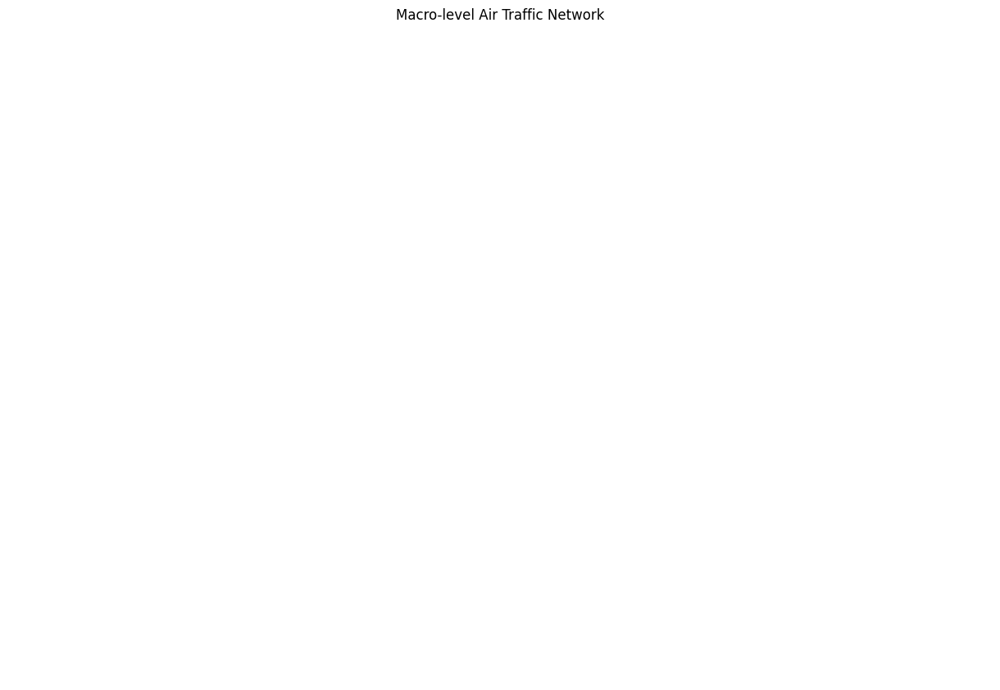

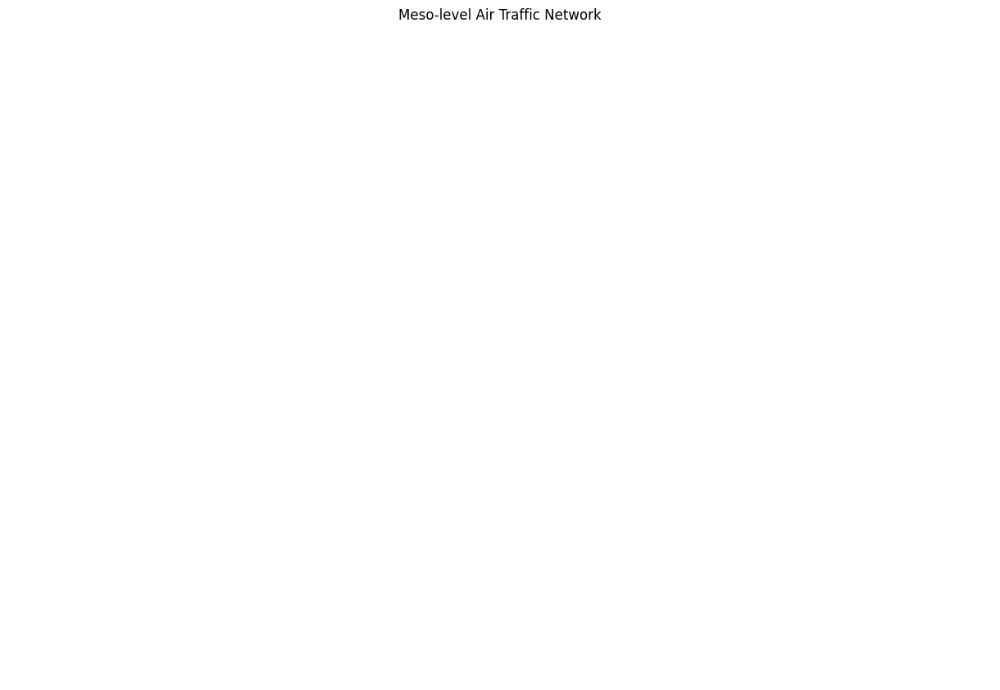

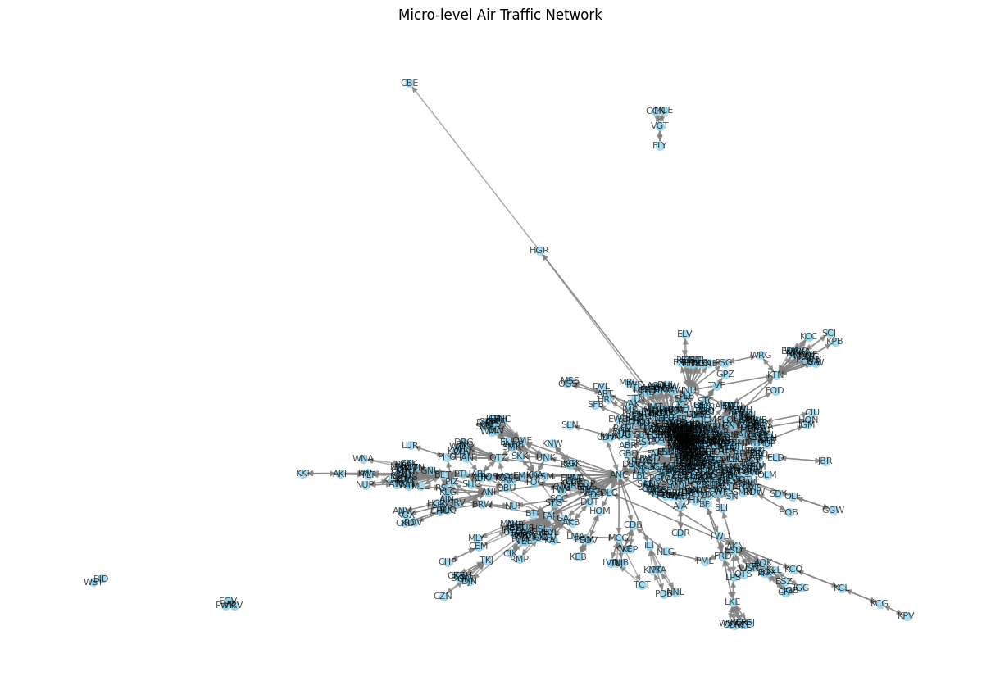

In [ ]:
import networkx as nx
import pandas as pd
import matplotlib.pyplot as plt

# Load USA_flights and USA_airports data
USA_flights = pd.read_excel('/content/drive/MyDrive/us_flights.xlsx')  # Update with your file path
USA_airports = pd.read_csv('/content/drive/MyDrive/us_airports.csv')  # Update with your file path

# Create a directed graph
G = nx.from_pandas_edgelist(USA_flights, 'Source', 'Target', edge_attr=True, create_using=nx.DiGraph())

# Define macro, meso, and micro levels
macro_nodes = ['United States', 'United Kingdom','China','Australia']  # List of countries at the macro level
meso_nodes = ['Source City', 'Regio', ...]  # List of regions at the meso level
micro_nodes = list(USA_airports['id'])  # List of airport IDs at the micro level

# Create subgraphs for each level
macro_graph = G.subgraph(macro_nodes)
meso_graph = G.subgraph(meso_nodes)
micro_graph = G.subgraph(micro_nodes)

# Plot macro-level graph
plt.figure(figsize=(12, 8))
pos_macro = nx.spring_layout(macro_graph)
nx.draw(macro_graph, pos=pos_macro, with_labels=True, node_size=50, font_size=8, font_color='black', node_color='skyblue', edge_color='gray', alpha=0.7, arrowsize=10)
plt.title('Macro-level Air Traffic Network')
plt.show()

# Plot meso-level graph
plt.figure(figsize=(12, 8))
pos_meso = nx.spring_layout(meso_graph)
nx.draw(meso_graph, pos=pos_meso, with_labels=True, node_size=50, font_size=8, font_color='black', node_color='skyblue', edge_color='gray', alpha=0.7, arrowsize=10)
plt.title('Meso-level Air Traffic Network')
plt.show()

# Plot micro-level graph
plt.figure(figsize=(12, 8))
pos_micro = nx.spring_layout(micro_graph)
nx.draw(micro_graph, pos=pos_micro, with_labels=True, node_size=50, font_size=8, font_color='black', node_color='skyblue', edge_color='gray', alpha=0.7, arrowsize=10)
plt.title('Micro-level Air Traffic Network')
plt.show()


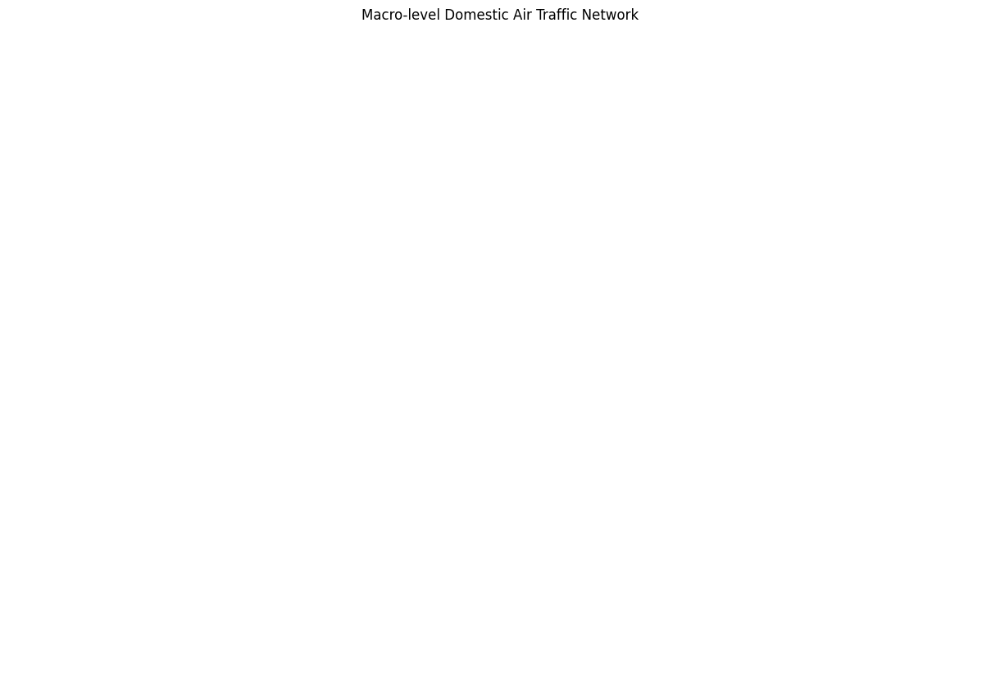

In [ ]:
import networkx as nx
import pandas as pd
import matplotlib.pyplot as plt

# Assuming 'domestic_flights' has 'Source', 'Target', and 'Weight' columns
# Assuming 'domestic_airports' has 'id', 'Lat', 'Lon', 'country', and 'Region' columns

# Load domestic_flights and domestic_airports data
domestic_flights = pd.read_csv('/content/drive/MyDrive/domestic_flights.csv')  # Update with your file path
domestic_airports = pd.read_csv('/content/drive/MyDrive/domestic_airports.csv')  # Update with your file path

# Create a directed graph
G = nx.from_pandas_edgelist(domestic_flights, 'Source', 'Target', edge_attr=True, create_using=nx.DiGraph())

# Define macro-level nodes (countries)
macro_nodes = ['USA', 'UK', 'China', 'Australia']

# Create a subgraph for the macro level
macro_graph = G.subgraph(macro_nodes)

# Plot the macro-level graph
plt.figure(figsize=(12, 8))
pos_macro = nx.spring_layout(macro_graph)
nx.draw(macro_graph, pos=pos_macro, with_labels=True, node_size=50, font_size=8, font_color='black', node_color='skyblue', edge_color='gray', alpha=0.7, arrowsize=10)
plt.title('Macro-level Domestic Air Traffic Network')
plt.show()



--- Analysis for Australia ---
Number of Nodes: 154
Number of Edges: 297
Density: 0.025210084033613446
Size of Largest Connected Component: 154
Average Degree: 3.857142857142857
Degree Centrality: {'CAZ': 0.013071895424836602, 'PUG': 0.006535947712418301, 'TRO': 0.013071895424836602, 'OKY': 0.013071895424836602, 'BMP': 0.006535947712418301, 'DPO': 0.006535947712418301, 'LNO': 0.0196078431372549, 'CTL': 0.0196078431372549, 'OKR': 0.0392156862745098, 'MQL': 0.0196078431372549, 'ADL': 0.13071895424836602, 'CBR': 0.05228758169934641, 'MYA': 0.013071895424836602, 'MNG': 0.026143790849673203, 'CNS': 0.1568627450980392, 'DBO': 0.026143790849673203, 'HBA': 0.013071895424836602, 'PKE': 0.006535947712418301, 'KTA': 0.013071895424836602, 'LHG': 0.006535947712418301, 'AYQ': 0.026143790849673203, 'BDD': 0.026143790849673203, 'DKI': 0.006535947712418301, 'THG': 0.006535947712418301, 'CNJ': 0.026143790849673203, 'GIC': 0.026143790849673203, 'ROK': 0.026143790849673203, 'ABM': 0.058823529411764705, '

<ipython-input-14-13287d4c4380>:61: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  nx.draw(country_subgraph, pos, node_color=list(partition.values()), with_labels=True, cmap=plt.cm.get_cmap('viridis'))


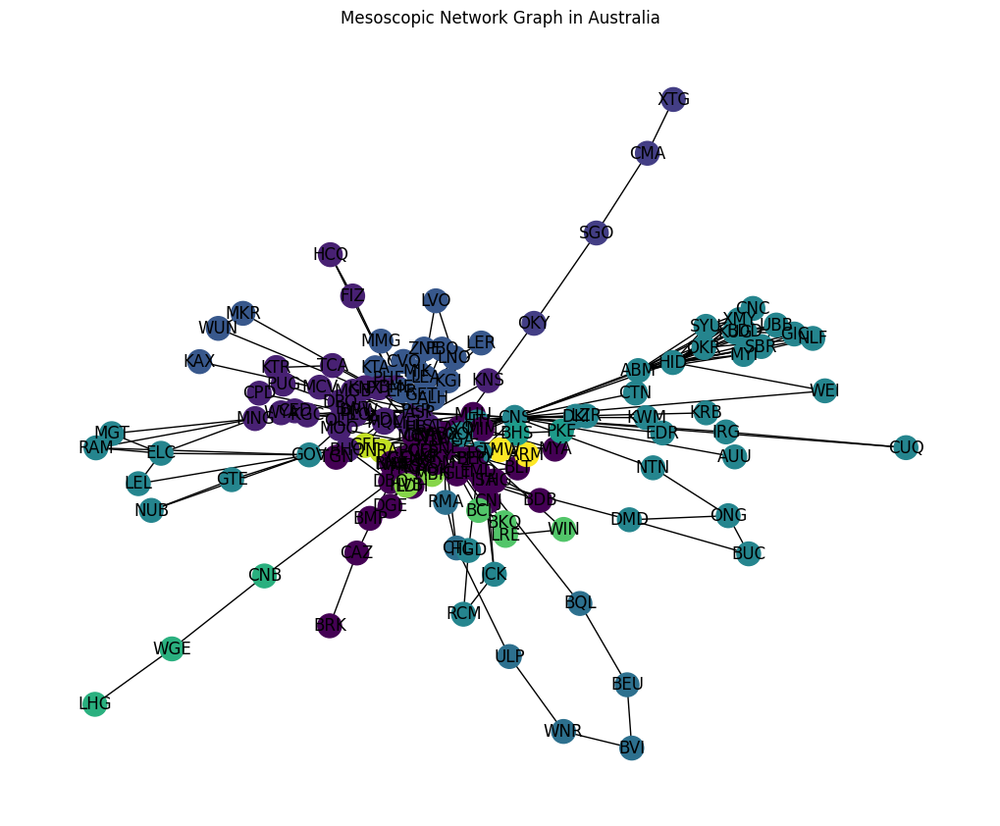


--- Analysis for China ---
Number of Nodes: 110
Number of Edges: 580
Density: 0.09674728940783987
Size of Largest Connected Component: 110
Average Degree: 10.545454545454545
Degree Centrality: {'DDG': 0.009174311926605505, 'ZGC': 0.009174311926605505, 'XMN': 0.30275229357798167, 'KRL': 0.01834862385321101, 'YNJ': 0.027522935779816515, 'YNT': 0.07339449541284404, 'WEF': 0.01834862385321101, 'CAN': 0.5321100917431193, 'NKG': 0.26605504587155965, 'GYS': 0.009174311926605505, 'CGO': 0.1834862385321101, 'HET': 0.045871559633027525, 'MXZ': 0.009174311926605505, 'NNY': 0.01834862385321101, 'TCG': 0.009174311926605505, 'BSD': 0.009174311926605505, 'WNZ': 0.2018348623853211, 'IQM': 0.009174311926605505, 'LYG': 0.027522935779816515, 'SHE': 0.2018348623853211, 'TSN': 0.14678899082568808, 'UYN': 0.009174311926605505, 'HFE': 0.12844036697247707, 'TXN': 0.06422018348623854, 'LHW': 0.14678899082568808, 'LZO': 0.027522935779816515, 'ZUH': 0.12844036697247707, 'NNG': 0.11009174311926606, 'BHY': 0.0366

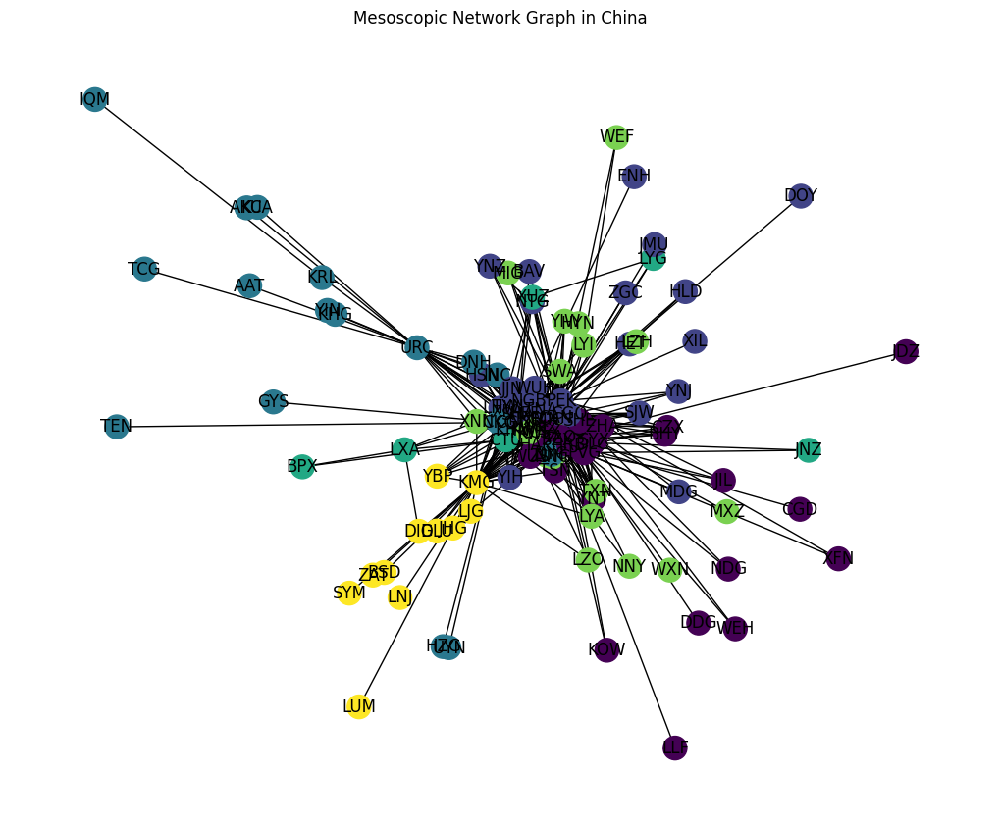


--- Analysis for United Kingdom ---
Number of Nodes: 58
Number of Edges: 180
Density: 0.1088929219600726
Size of Largest Connected Component: 53
Average Degree: 6.206896551724138
Degree Centrality: {'ABZ': 0.2982456140350877, 'EOI': 0.03508771929824561, 'LTN': 0.12280701754385964, 'EMA': 0.12280701754385964, 'NDY': 0.05263157894736842, 'BRS': 0.15789473684210525, 'PPW': 0.07017543859649122, 'HUY': 0.017543859649122806, 'SYY': 0.05263157894736842, 'BHD': 0.2631578947368421, 'LSI': 0.07017543859649122, 'LHR': 0.14035087719298245, 'BHX': 0.17543859649122806, 'NWI': 0.05263157894736842, 'NRL': 0.07017543859649122, 'WIC': 0.05263157894736842, 'SEN': 0.017543859649122806, 'BFS': 0.22807017543859648, 'SOY': 0.07017543859649122, 'LPL': 0.03508771929824561, 'CWL': 0.14035087719298245, 'FIE': 0.03508771929824561, 'SWS': 0.03508771929824561, 'CAL': 0.017543859649122806, 'NCL': 0.19298245614035087, 'BRR': 0.03508771929824561, 'LDY': 0.05263157894736842, 'TSO': 0.017543859649122806, 'EXT': 0.07017

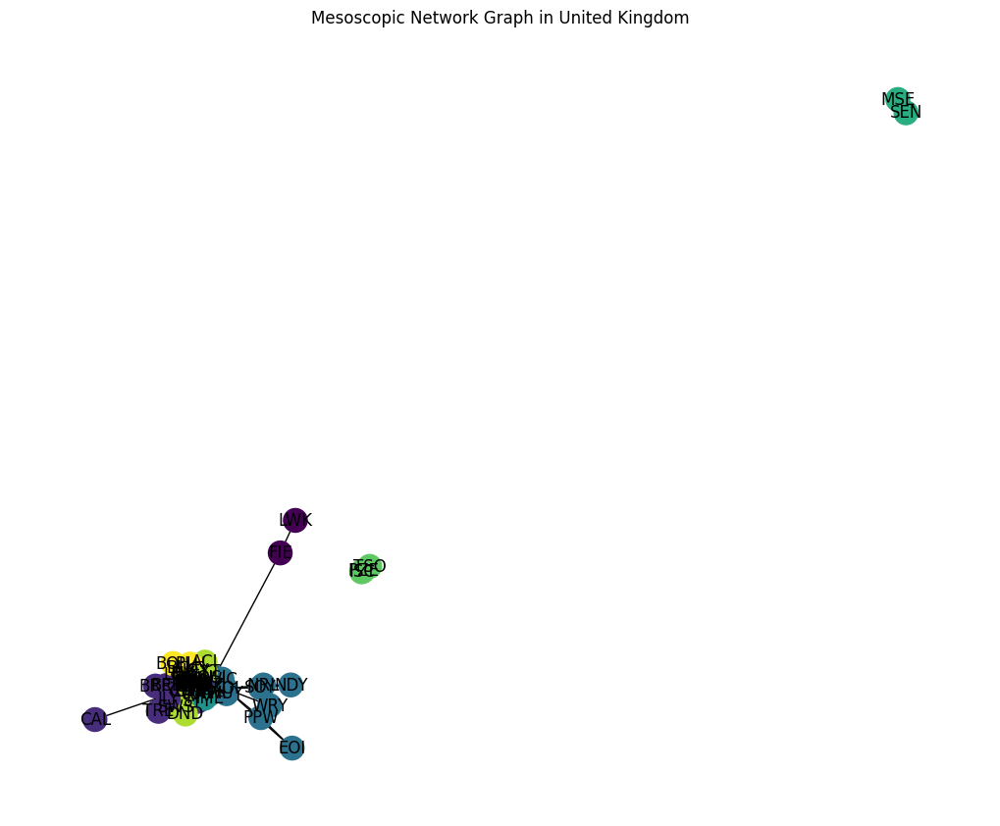


--- Analysis for United States ---
Number of Nodes: 647
Number of Edges: 2984
Density: 0.014278810035362067
Size of Largest Connected Component: 638
Average Degree: 9.224111282843895
Degree Centrality: {'SOV': 0.0046439628482972135, 'KEB': 0.0030959752321981426, 'HOM': 0.0046439628482972135, 'PGM': 0.0046439628482972135, 'AET': 0.007739938080495357, 'AKP': 0.0046439628482972135, 'ANC': 0.061919504643962855, 'GAL': 0.013931888544891642, 'ANI': 0.013931888544891642, 'SHX': 0.0030959752321981426, 'BTI': 0.0030959752321981426, 'FAI': 0.052631578947368425, 'SCC': 0.006191950464396285, 'RSH': 0.006191950464396285, 'HCR': 0.0046439628482972135, 'BET': 0.04798761609907121, 'AIN': 0.0046439628482972135, 'BRW': 0.007739938080495357, 'KLG': 0.006191950464396285, 'FYU': 0.007739938080495357, 'DLG': 0.018575851393188854, 'KYU': 0.0046439628482972135, 'NUI': 0.0030959752321981426, 'RBY': 0.007739938080495357, 'TAL': 0.009287925696594427, 'PIZ': 0.0046439628482972135, 'HSL': 0.007739938080495357, 'N

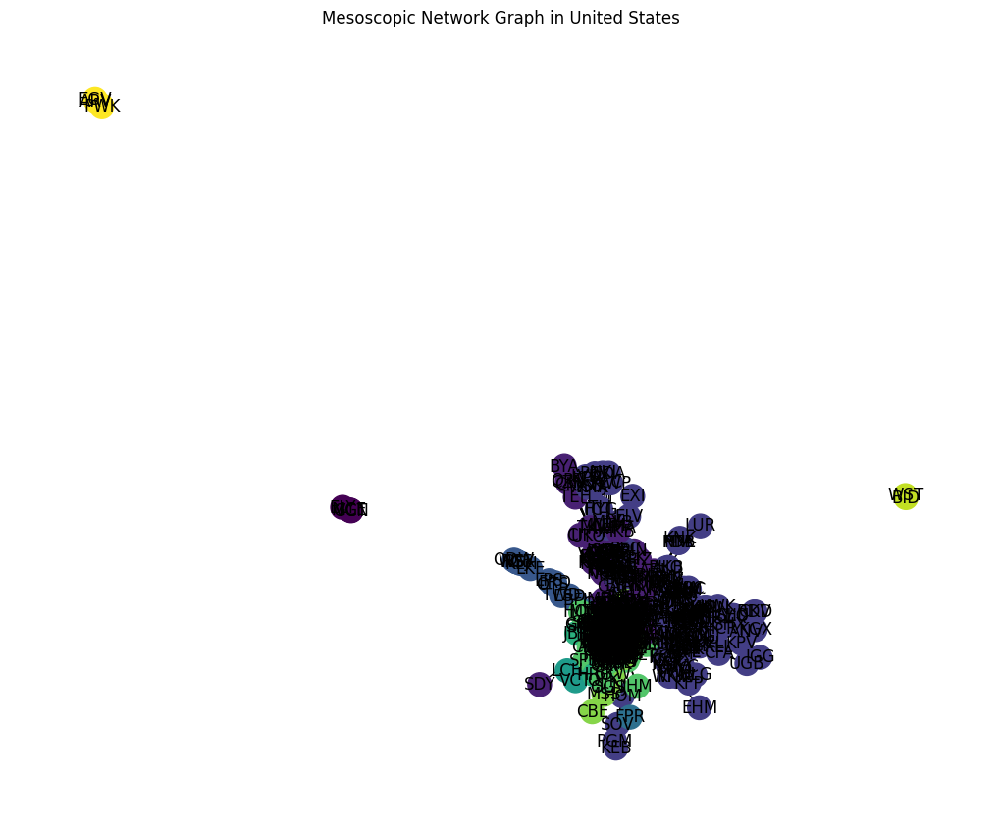

In [ ]:
import networkx as nx
import pandas as pd
import matplotlib.pyplot as plt
import community  # You may need to install this library using: pip install python-louvain
import community.community_louvain


# Load domestic flight data
domestic_flights = pd.read_csv('/content/drive/MyDrive/domestic_flights.csv')  # Update with your actual file path
domestic_airports = pd.read_csv('/content/drive/MyDrive/domestic_airports.csv')  # Update with your actual file path

# Create a directed graph
G = nx.Graph()

# Add edges with weights
for index, row in domestic_flights.iterrows():
    G.add_edge(row['Source'], row['Target'], weight=row['Weight'])

# Map airport IDs to countries
id_to_country = dict(zip(domestic_airports['id'], domestic_airports['country']))
nx.set_node_attributes(G, id_to_country, 'country')

# Analyze subgraphs for each country
countries = domestic_airports['country'].unique()

for country in countries:
    # Extract the subgraph for the specific country
    country_subgraph = G.subgraph([node for node, data in G.nodes(data=True) if data['country'] == country])

    # Macro-level statistical analysis
    print(f"\n--- Analysis for {country} ---")
    print(f"Number of Nodes: {country_subgraph.number_of_nodes()}")
    print(f"Number of Edges: {country_subgraph.number_of_edges()}")
    print(f"Density: {nx.density(country_subgraph)}")
    print(f"Size of Largest Connected Component: {len(max(nx.connected_components(country_subgraph), key=len))}")

    # Degree Distribution
    degrees = dict(country_subgraph.degree())
    print(f"Average Degree: {sum(degrees.values()) / len(degrees)}")

    # Centrality Measures
    degree_centrality = nx.degree_centrality(country_subgraph)
    betweenness_centrality = nx.betweenness_centrality(country_subgraph)
    eigenvector_centrality = nx.eigenvector_centrality(country_subgraph)

    print(f"Degree Centrality: {degree_centrality}")
    print(f"Betweenness Centrality: {betweenness_centrality}")
    print(f"Eigenvector Centrality: {eigenvector_centrality}")

    # Community Detection using Louvain
    # Community Detection using Louvain
    partition = community.community_louvain.best_partition(country_subgraph.to_undirected())
    print(f"Number of Communities (Louvain): {len(set(partition.values()))}")

    # Additional Analyses...
    # (You can add more analyses based on the specific measures you want to explore)

    # Plot mesoscopic network graph with community colors
    pos = nx.spring_layout(country_subgraph)
    plt.figure(figsize=(10, 8))
    nx.draw(country_subgraph, pos, node_color=list(partition.values()), with_labels=True, cmap=plt.cm.get_cmap('viridis'))
    plt.title(f'Mesoscopic Network Graph in {country}')
    plt.show()


In [ ]:
import networkx as nx
import pandas as pd
import matplotlib.pyplot as plt
import community.community_louvain

# Load domestic flight data
domestic_flights = pd.read_csv('/content/drive/MyDrive/domestic_flights.csv')  # Update with your actual file path
domestic_airports = pd.read_csv('/content/drive/MyDrive/domestic_airports.csv')  # Update with your actual file path

# Create a directed graph
G = nx.Graph()

# Add edges with weights
for index, row in domestic_flights.iterrows():
    G.add_edge(row['Source'], row['Target'], weight=row['Weight'])

# Map airport IDs to countries
id_to_country = dict(zip(domestic_airports['id'], domestic_airports['country']))
nx.set_node_attributes(G, id_to_country, 'country')

# Analyze subgraphs for each country
countries = domestic_airports['country'].unique()

for country in countries:
    # Extract the subgraph for the specific country
    country_subgraph = G.subgraph([node for node, data in G.nodes(data=True) if data['country'] == country])

    # Centrality Measures
    degree_centrality = nx.degree_centrality(country_subgraph)
    betweenness_centrality = nx.betweenness_centrality(country_subgraph)
    eigenvector_centrality = nx.eigenvector_centrality(country_subgraph)

    # Get the top 10 cities based on each centrality measure
    top_10_degree_centrality = sorted(degree_centrality.items(), key=lambda x: x[1], reverse=True)[:10]
    top_10_betweenness_centrality = sorted(betweenness_centrality.items(), key=lambda x: x[1], reverse=True)[:10]
    top_10_eigenvector_centrality = sorted(eigenvector_centrality.items(), key=lambda x: x[1], reverse=True)[:10]

    print(f"\n--- Top 10 Cities in {country} ---")
    print("Top 10 by Degree Centrality:")
    for city, centrality in top_10_degree_centrality:
        print(f"{city}: {centrality:.4f}")

    print("\nTop 10 by Betweenness Centrality:")
    for city, centrality in top_10_betweenness_centrality:
        print(f"{city}: {centrality:.4f}")

    print("\nTop 10 by Eigenvector Centrality:")
    for city, centrality in top_10_eigenvector_centrality:
        print(f"{city}: {centrality:.4f}")



--- Top 10 Cities in Australia ---
Top 10 by Degree Centrality:
SYD: 0.2745
BNE: 0.2353
PER: 0.1699
MEL: 0.1634
CNS: 0.1569
ADL: 0.1307
HID: 0.0915
DRW: 0.0784
ASP: 0.0654
ABM: 0.0588

Top 10 by Betweenness Centrality:
BNE: 0.3514
SYD: 0.3399
CNS: 0.3179
PER: 0.2244
MEL: 0.1211
ADL: 0.1187
DRW: 0.1068
HID: 0.0696
DBO: 0.0657
ISA: 0.0628

Top 10 by Eigenvector Centrality:
SYD: 0.4197
BNE: 0.3711
MEL: 0.3260
ADL: 0.2412
PER: 0.2306
CNS: 0.2303
ASP: 0.2126
DRW: 0.2045
OOL: 0.1647
CBR: 0.1622

--- Top 10 Cities in China ---
Top 10 by Degree Centrality:
PEK: 0.6514
CAN: 0.5321
SZX: 0.4312
KMG: 0.3670
CTU: 0.3578
SHA: 0.3578
CKG: 0.3486
XMN: 0.3028
XIY: 0.2936
CSX: 0.2844

Top 10 by Betweenness Centrality:
PEK: 0.3044
CAN: 0.1511
KMG: 0.1462
URC: 0.1436
SZX: 0.1094
CTU: 0.0640
CKG: 0.0621
XIY: 0.0496
SHA: 0.0436
PVG: 0.0435

Top 10 by Eigenvector Centrality:
PEK: 0.2743
CAN: 0.2501
SZX: 0.2241
CTU: 0.2120
CKG: 0.2098
XMN: 0.2081
XIY: 0.1940
KMG: 0.1937
CSX: 0.1928
SHA: 0.1893

--- Top 10 Ci

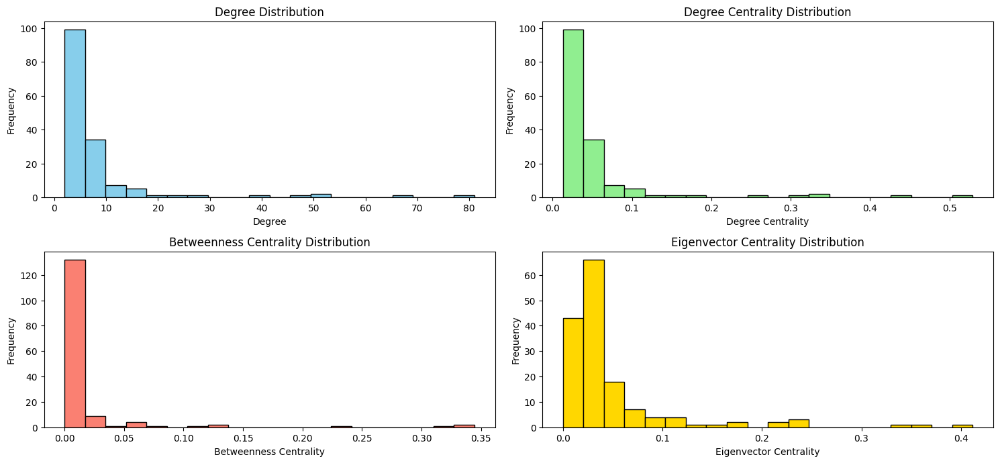

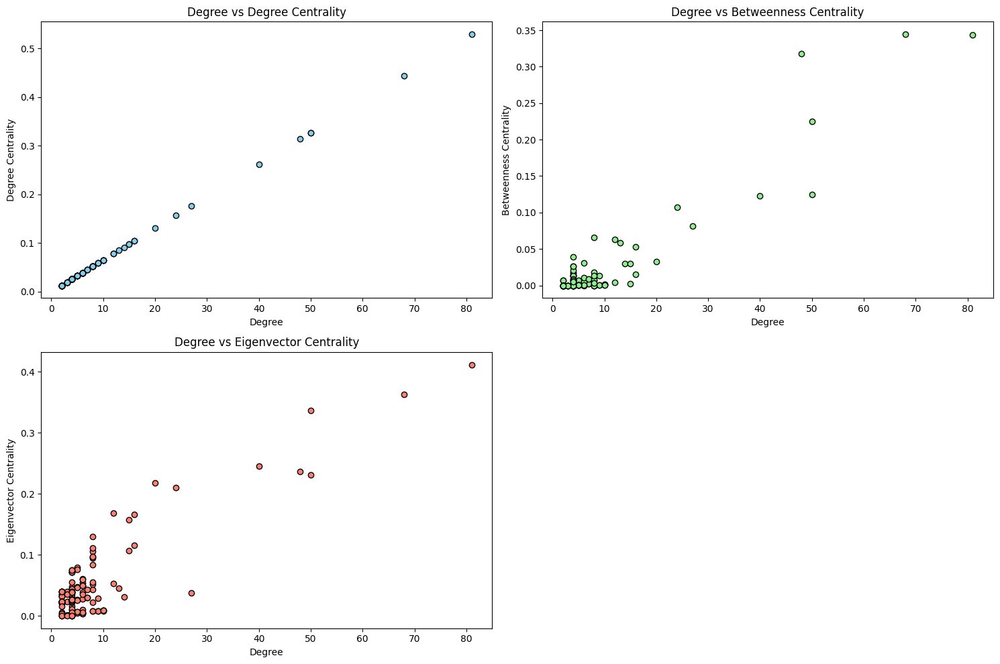

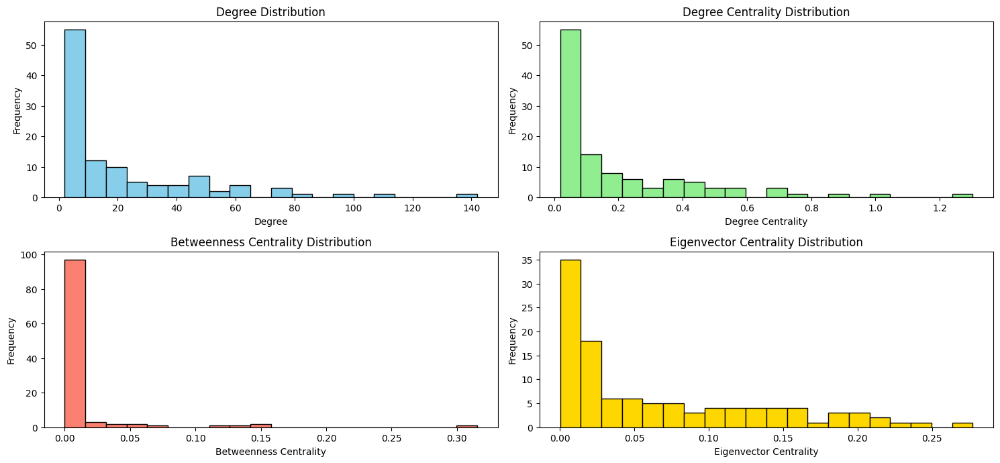

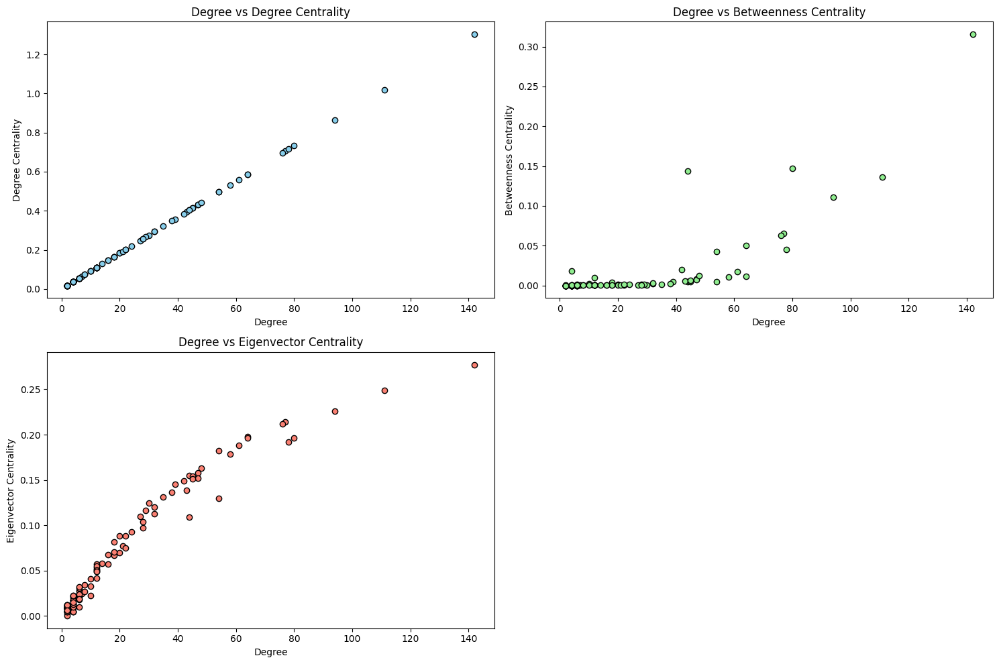

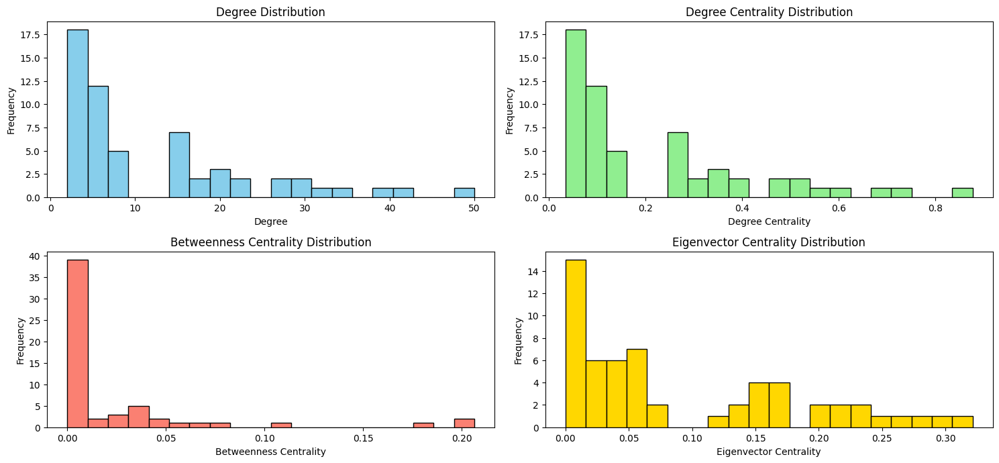

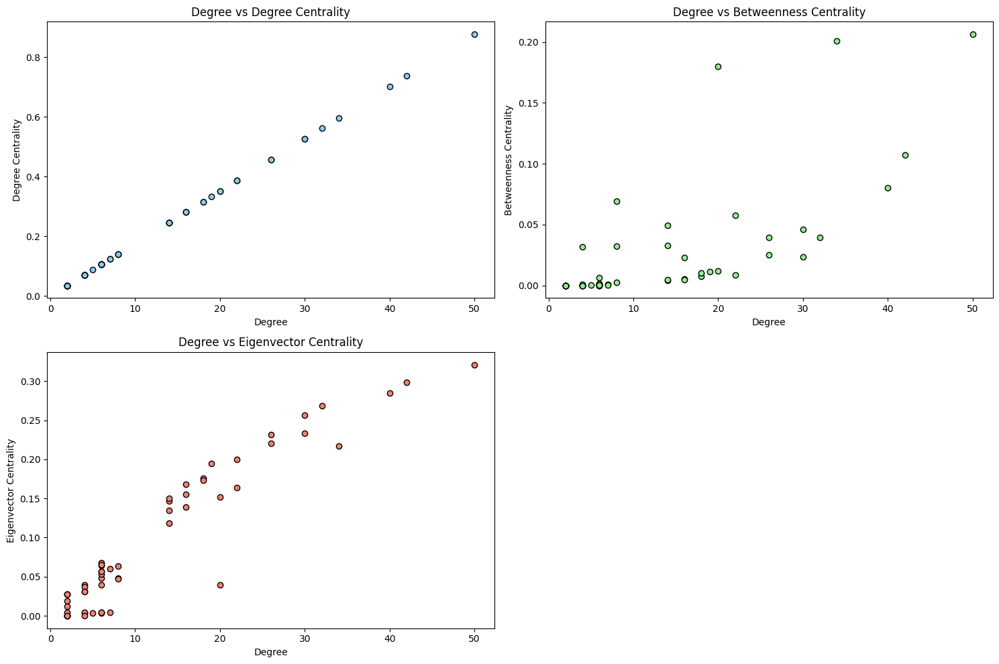

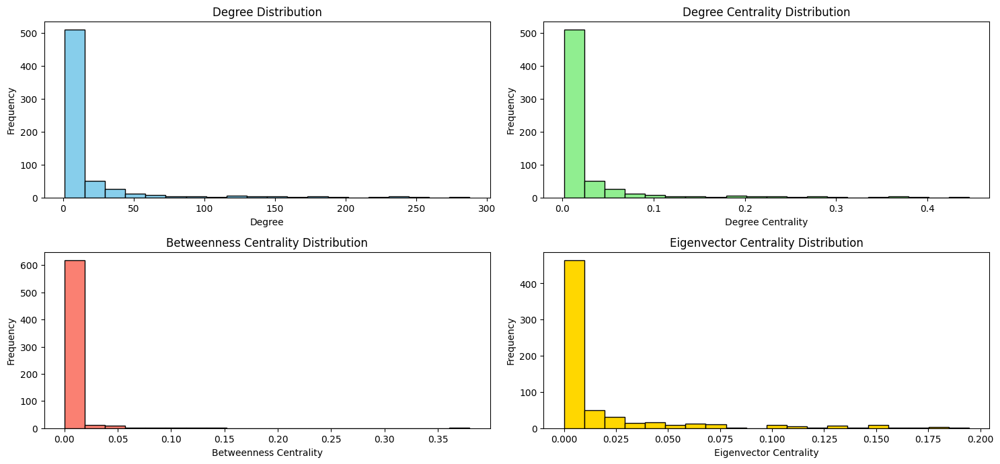

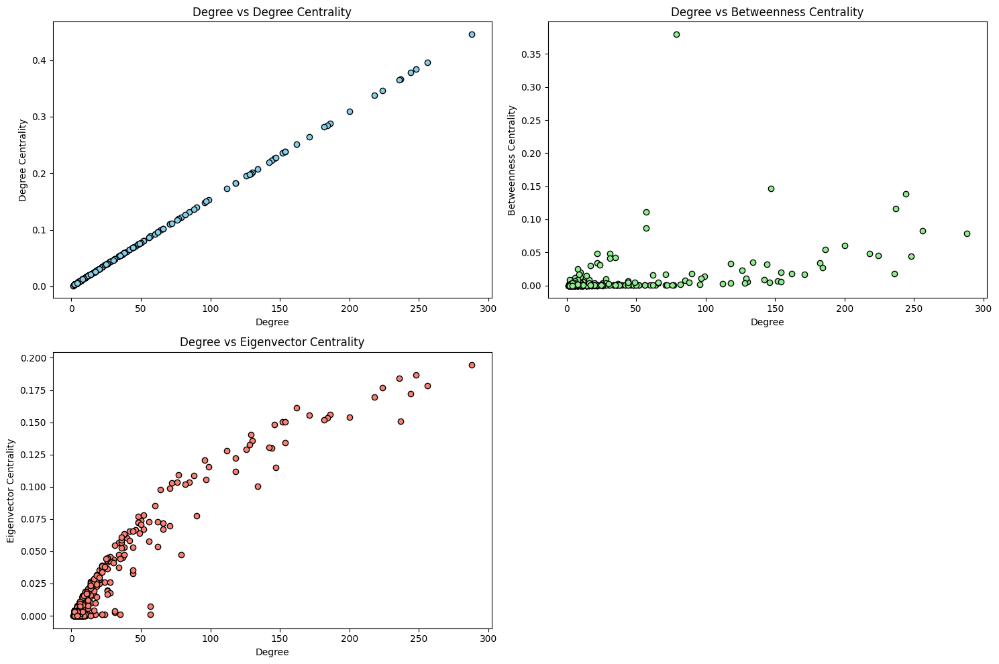

In [ ]:
import networkx as nx
import pandas as pd
import matplotlib.pyplot as plt
import community.community_louvain
import seaborn as sns

# Load domestic flight data
domestic_flights = pd.read_csv('/content/drive/MyDrive/domestic_flights.csv')  # Update with your actual file path
domestic_airports = pd.read_csv('domestic_airports.csv')  # Update with your actual file path

# Create a directed graph
G = nx.DiGraph()

# Add edges with weights
for index, row in domestic_flights.iterrows():
    G.add_edge(row['Source'], row['Target'], weight=row['Weight'])

# Map airport IDs to countries
id_to_country = dict(zip(domestic_airports['id'], domestic_airports['country']))
nx.set_node_attributes(G, id_to_country, 'Country')

# Analyze subgraphs for each country
countries = domestic_airports['country'].unique()

for country in countries:
    # Extract the subgraph for the specific country
    country_subgraph = G.subgraph([node for node, data in G.nodes(data=True) if data['Country'] == country])

    # Degree Distribution
    degrees = dict(country_subgraph.degree())
    degree_values = list(degrees.values())

    # Centrality Measures
    degree_centrality = nx.degree_centrality(country_subgraph)
    betweenness_centrality = nx.betweenness_centrality(country_subgraph)
    eigenvector_centrality = nx.eigenvector_centrality(country_subgraph)

    # Histograms
    plt.figure(figsize=(15, 10))

    plt.subplot(3, 2, 1)
    plt.hist(degree_values, bins=20, color='skyblue', edgecolor='black')
    plt.title('Degree Distribution')
    plt.xlabel('Degree')
    plt.ylabel('Frequency')

    plt.subplot(3, 2, 2)
    plt.hist(list(degree_centrality.values()), bins=20, color='lightgreen', edgecolor='black')
    plt.title('Degree Centrality Distribution')
    plt.xlabel('Degree Centrality')
    plt.ylabel('Frequency')

    plt.subplot(3, 2, 3)
    plt.hist(list(betweenness_centrality.values()), bins=20, color='salmon', edgecolor='black')
    plt.title('Betweenness Centrality Distribution')
    plt.xlabel('Betweenness Centrality')
    plt.ylabel('Frequency')

    plt.subplot(3, 2, 4)
    plt.hist(list(eigenvector_centrality.values()), bins=20, color='gold', edgecolor='black')
    plt.title('Eigenvector Centrality Distribution')
    plt.xlabel('Eigenvector Centrality')
    plt.ylabel('Frequency')

    plt.tight_layout()
    plt.show()

    # Scatter Plots
    plt.figure(figsize=(15, 10))

    plt.subplot(2, 2, 1)
    plt.scatter(degree_values, list(degree_centrality.values()), color='skyblue', edgecolor='black')
    plt.title('Degree vs Degree Centrality')
    plt.xlabel('Degree')
    plt.ylabel('Degree Centrality')

    plt.subplot(2, 2, 2)
    plt.scatter(degree_values, list(betweenness_centrality.values()), color='lightgreen', edgecolor='black')
    plt.title('Degree vs Betweenness Centrality')
    plt.xlabel('Degree')
    plt.ylabel('Betweenness Centrality')

    plt.subplot(2, 2, 3)
    plt.scatter(degree_values, list(eigenvector_centrality.values()), color='salmon', edgecolor='black')
    plt.title('Degree vs Eigenvector Centrality')
    plt.xlabel('Degree')
    plt.ylabel('Eigenvector Centrality')

    plt.tight_layout()
    plt.show()


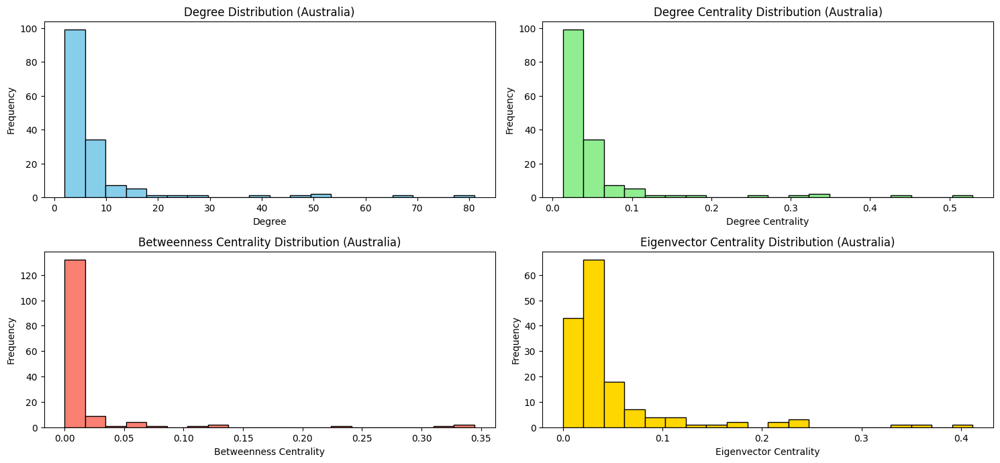

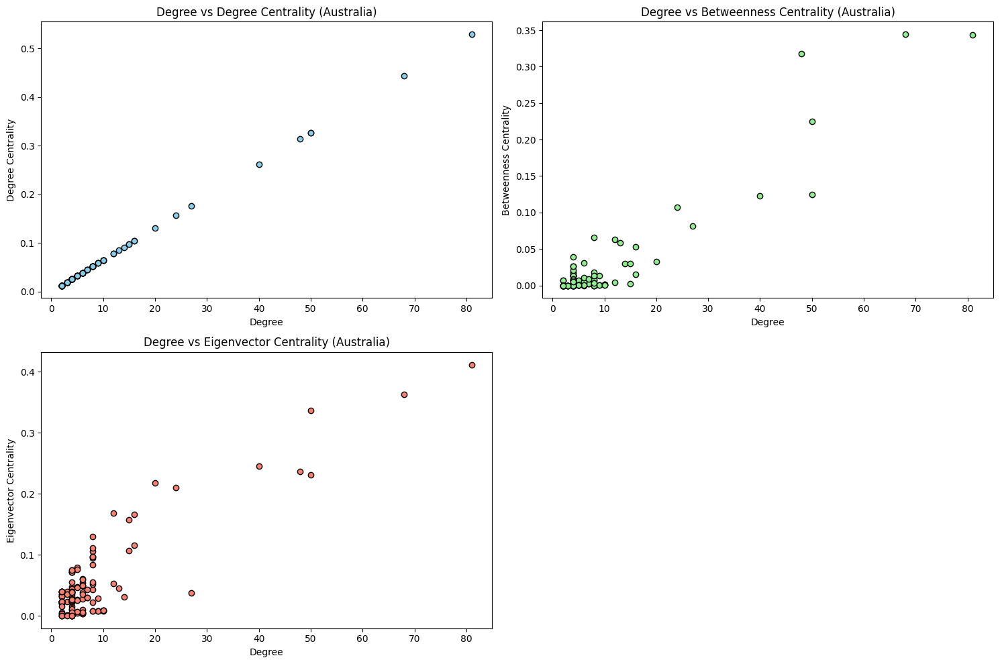

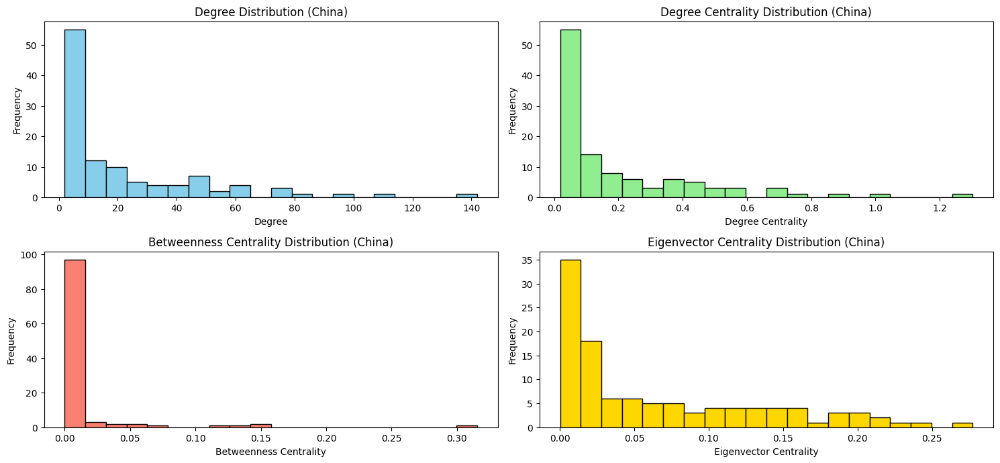

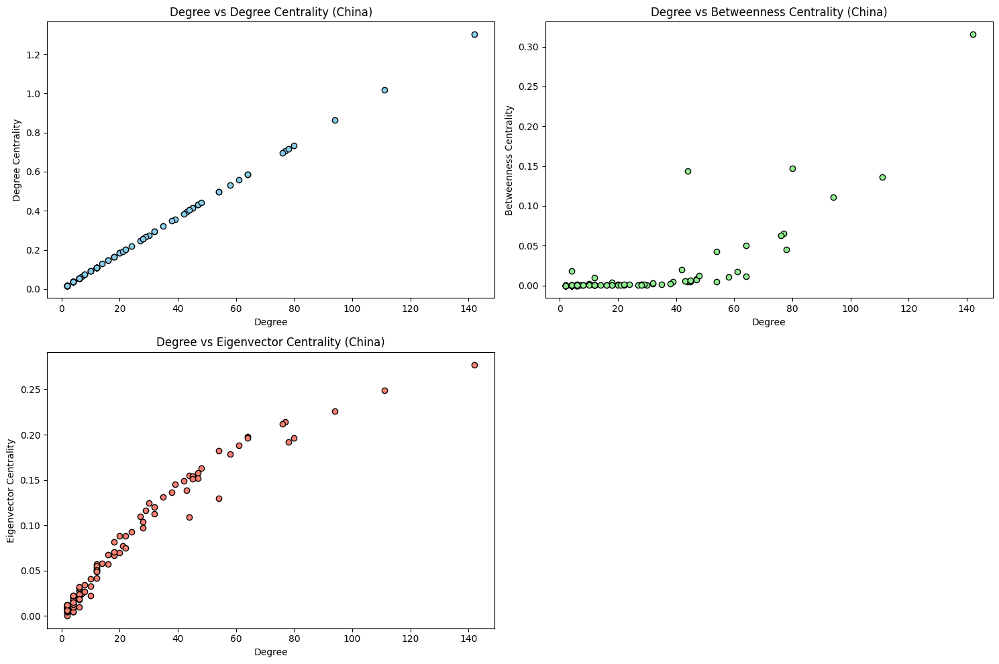

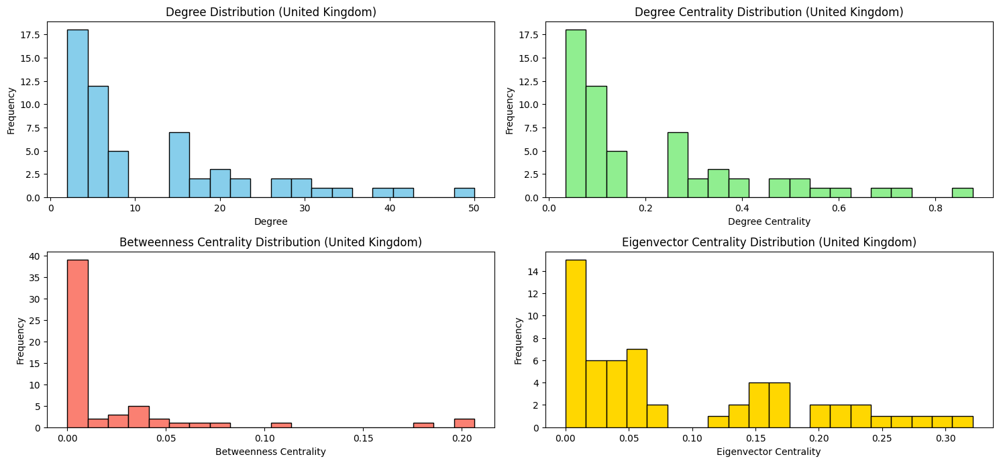

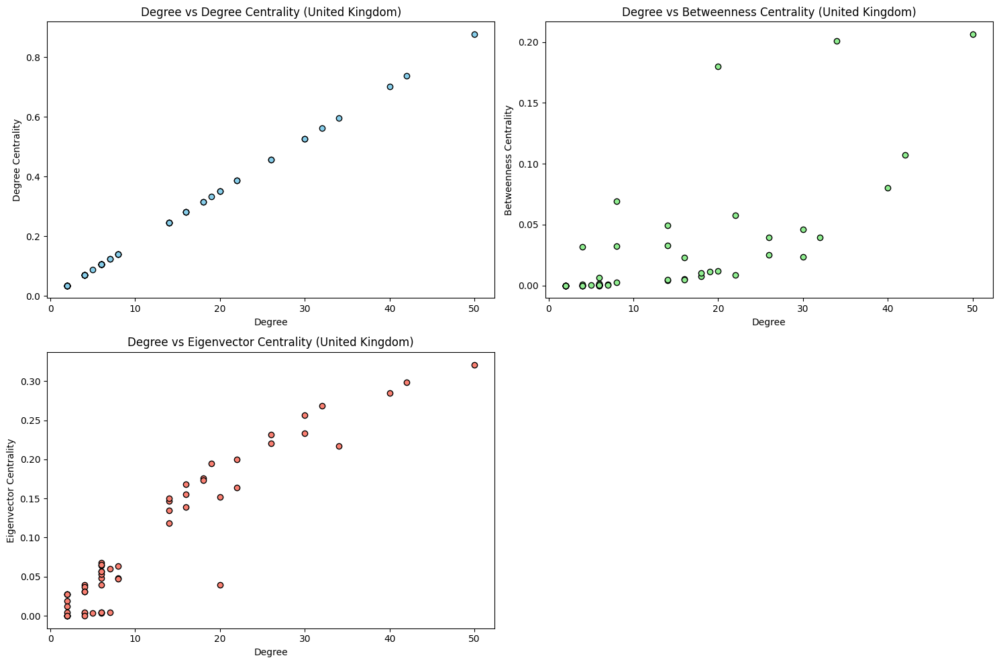

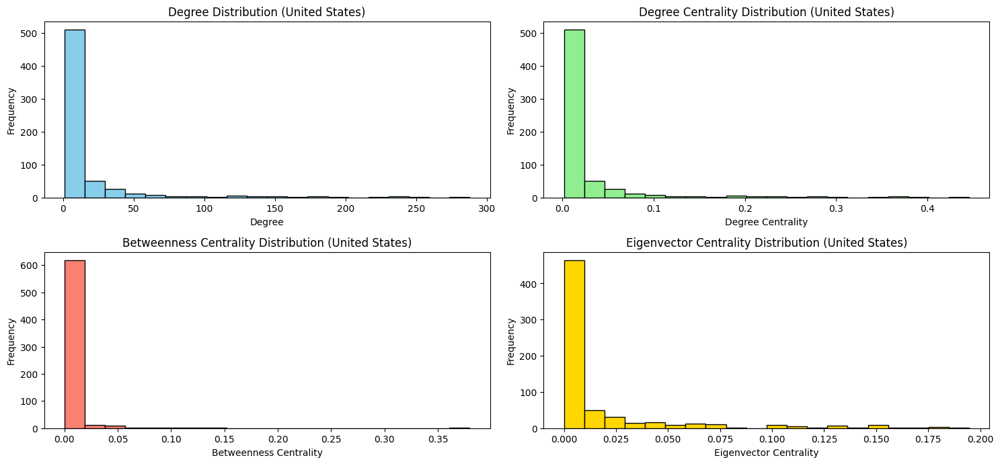

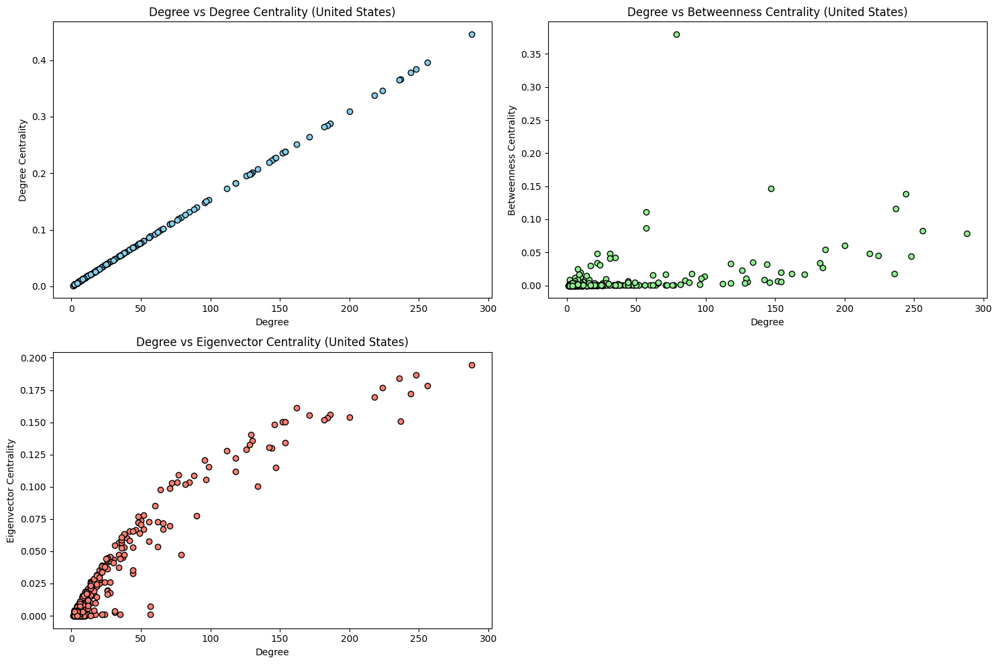

In [ ]:
import networkx as nx
import pandas as pd
import matplotlib.pyplot as plt
import community.community_louvain
import seaborn as sns

# Load domestic flight data
domestic_flights = pd.read_csv('/content/drive/MyDrive/domestic_flights.csv')  # Update with your actual file path
domestic_airports = pd.read_csv('/content/drive/MyDrive/domestic_airports.csv')  # Update with your actual file path

# Create a directed graph
G = nx.DiGraph()

# Add edges with weights
for index, row in domestic_flights.iterrows():
    G.add_edge(row['Source'], row['Target'], weight=row['Weight'])

# Map airport IDs to countries
id_to_country = dict(zip(domestic_airports['id'], domestic_airports['country']))
nx.set_node_attributes(G, id_to_country, 'Country')

# Analyze subgraphs for each country
countries = domestic_airports['country'].unique()

for country in countries:
    # Extract the subgraph for the specific country
    country_subgraph = G.subgraph([node for node, data in G.nodes(data=True) if data['Country'] == country])

    # Degree Distribution
    degrees = dict(country_subgraph.degree())
    degree_values = list(degrees.values())

    # Centrality Measures
    degree_centrality = nx.degree_centrality(country_subgraph)
    betweenness_centrality = nx.betweenness_centrality(country_subgraph)
    eigenvector_centrality = nx.eigenvector_centrality(country_subgraph)

    # Histograms
    plt.figure(figsize=(15, 10))

    plt.subplot(3, 2, 1)
    plt.hist(degree_values, bins=20, color='skyblue', edgecolor='black')
    plt.title(f'Degree Distribution ({country})')
    plt.xlabel('Degree')
    plt.ylabel('Frequency')

    plt.subplot(3, 2, 2)
    plt.hist(list(degree_centrality.values()), bins=20, color='lightgreen', edgecolor='black')
    plt.title(f'Degree Centrality Distribution ({country})')
    plt.xlabel('Degree Centrality')
    plt.ylabel('Frequency')

    plt.subplot(3, 2, 3)
    plt.hist(list(betweenness_centrality.values()), bins=20, color='salmon', edgecolor='black')
    plt.title(f'Betweenness Centrality Distribution ({country})')
    plt.xlabel('Betweenness Centrality')
    plt.ylabel('Frequency')

    plt.subplot(3, 2, 4)
    plt.hist(list(eigenvector_centrality.values()), bins=20, color='gold', edgecolor='black')
    plt.title(f'Eigenvector Centrality Distribution ({country})')
    plt.xlabel('Eigenvector Centrality')
    plt.ylabel('Frequency')

    plt.tight_layout()
    plt.show()

    # Scatter Plots
    plt.figure(figsize=(15, 10))

    plt.subplot(2, 2, 1)
    plt.scatter(degree_values, list(degree_centrality.values()), color='skyblue', edgecolor='black')
    plt.title(f'Degree vs Degree Centrality ({country})')
    plt.xlabel('Degree')
    plt.ylabel('Degree Centrality')

    plt.subplot(2, 2, 2)
    plt.scatter(degree_values, list(betweenness_centrality.values()), color='lightgreen', edgecolor='black')
    plt.title(f'Degree vs Betweenness Centrality ({country})')
    plt.xlabel('Degree')
    plt.ylabel('Betweenness Centrality')

    plt.subplot(2, 2, 3)
    plt.scatter(degree_values, list(eigenvector_centrality.values()), color='salmon', edgecolor='black')
    plt.title(f'Degree vs Eigenvector Centrality ({country})')
    plt.xlabel('Degree')
    plt.ylabel('Eigenvector Centrality')

    plt.tight_layout()
    plt.show()


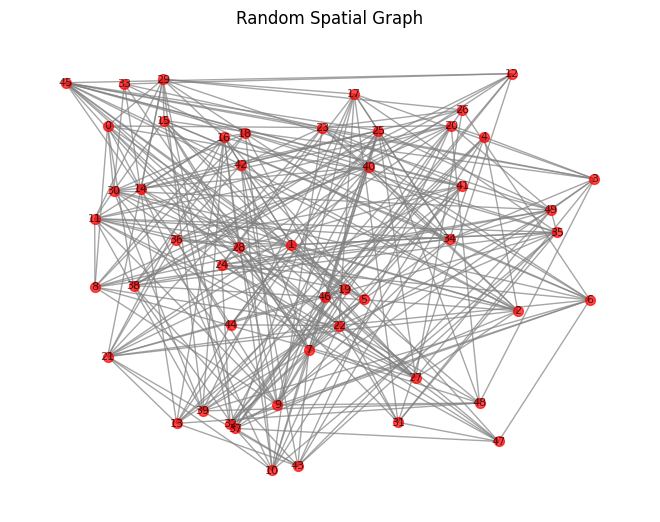

In [ ]:
import networkx as nx
import matplotlib.pyplot as plt
import random

# Function to generate a random spatial graph
def generate_random_spatial_graph(num_nodes, edge_prob, min_lon=-180, max_lon=180, min_lat=-90, max_lat=90):
    G = nx.Graph()

    # Add nodes with random spatial coordinates
    for i in range(num_nodes):
        lon = random.uniform(min_lon, max_lon)
        lat = random.uniform(min_lat, max_lat)
        G.add_node(i, pos=(lon, lat))

    # Add edges with probability edge_prob
    for i in range(num_nodes):
        for j in range(i + 1, num_nodes):
            if random.uniform(0, 1) < edge_prob:
                G.add_edge(i, j)

    return G

# Function to visualize the random spatial graph
def visualize_random_spatial_graph(G):
    pos = nx.get_node_attributes(G, 'pos')
    nx.draw(G, pos, with_labels=True, node_size=50, font_size=8, font_color='black', node_color='red', edge_color='gray', alpha=0.7, arrowsize=10)
    plt.title('Random Spatial Graph')
    plt.show()

# Example usage
num_nodes = 50
edge_probability = 0.2
random_graph = generate_random_spatial_graph(num_nodes, edge_probability)
visualize_random_spatial_graph(random_graph)


In [ ]:
pip install python-louvain


Core Community Size: 29


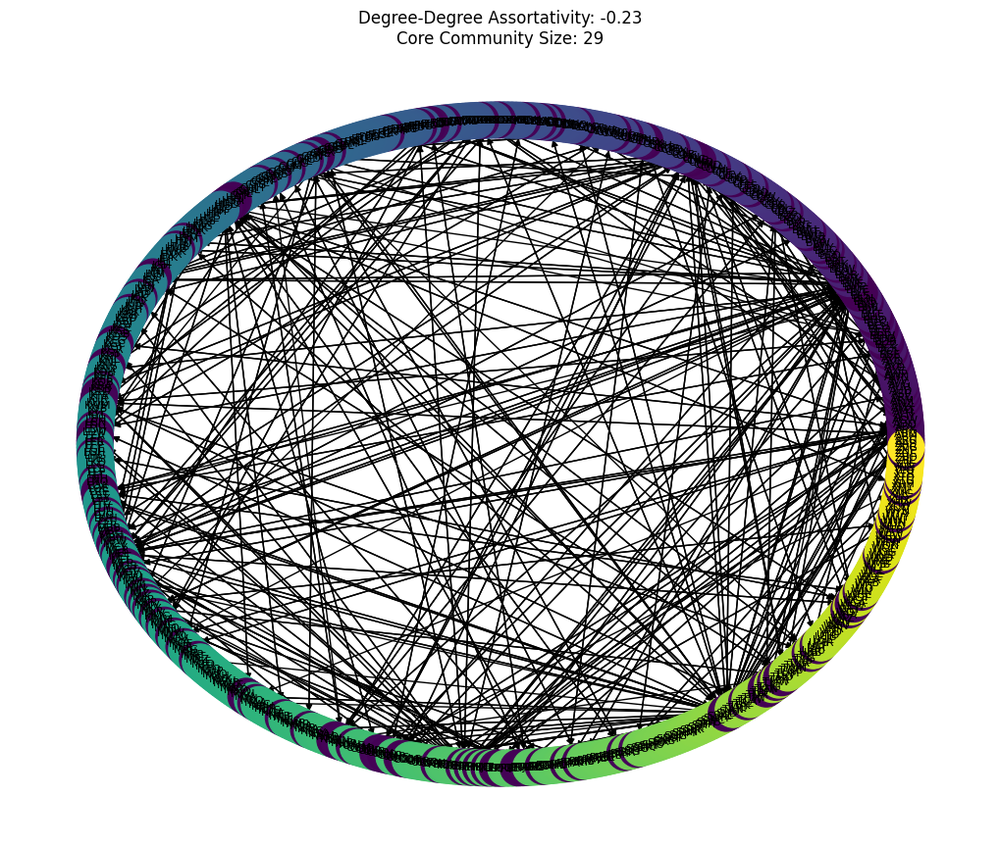

In [ ]:
import geopandas as gpd
import matplotlib.pyplot as plt
import networkx as nx
from networkx.algorithms.community import greedy_modularity_communities

# Create a directed graph
G5 = nx.DiGraph()

# Add nodes with spatial coordinates
for index, row in uk_airports.iterrows():
    G5.add_node(row['id'], pos=(row['Lon'], row['Lat ']))

# Add edges
for index, row in uk_flights.iterrows():
    G5.add_edge(row['Source'], row['Target'])

# Louvain-like community detection using greedy_modularity_communities
communities = list(greedy_modularity_communities(G5))

# Create a partition dictionary for node colors
partition = {node: i for i, comm in enumerate(communities) for node in comm}

# Find the core community
core_community = max(partition.values(), key=list(partition.values()).count)

# Calculate core community size
core_community_size = list(partition.values()).count(core_community)

# Calculate degree-degree assortativity
degree_assortativity = nx.degree_assortativity_coefficient(G5)

# Plot the network
plt.figure(figsize=(10, 8))
pos = nx.circular_layout(G5)
nx.draw(G5, pos=pos, with_labels=True, node_size=700, node_color=[partition[node] for node in G5.nodes], cmap='viridis', font_size=8)

# Display assortativity coefficient and core community size in the title
plt.title(f'Degree-Degree Assortativity: {degree_assortativity:.2f}\nCore Community Size: {core_community_size}')

# Print core community size
print(f'Core Community Size: {core_community_size}')

# Show the plot
plt.show()


In [ ]:
import networkx as nx
import pandas as pd

# Assuming 'USA_flights' has columns like 'Source', 'Target', 'Weight', 'Lat_source', 'Lon_source', 'Lat_target', 'Lon_target'
# Assuming 'USA_airports' has columns like 'id', 'Lat', 'Lon', 'country'

# Load data
USA_flights = pd.read_excel('/content/drive/MyDrive/us_flights.xlsx')  # Update with your actual file path
USA_airports = pd.read_csv('/content/drive/MyDrive/us_airports.csv')  # Update with your actual file path

# Create a directed graph
G = nx.Graph()

# Add edges with weights and distance penalty
for index, row in USA_flights.iterrows():
    source = row['Source']
    target = row['Target']
    weight = row['Weight']

    # Find coordinates for source and target airports
    source_coords = USA_airports.loc[USA_airports['id'] == source, ['Lat ', 'Lon']].values.flatten()
    target_coords = USA_airports.loc[USA_airports['id'] == target, ['Lat ', 'Lon']].values.flatten()

    # Calculate distance penalty based on a gravitational model
    distance_penalty = 1 / ((source_coords[0] - target_coords[0]) ** 2 + (source_coords[1] - target_coords[1]) ** 2 + 1)

    # Assign weighted edge with distance penalty
    G.add_edge(source, target, weight=weight * distance_penalty)

# Example: Calculate and print edge weights
for edge in G.edges(data=True):
    print(f"Edge: {edge[0]} - {edge[1]}, Weight: {edge[2]['weight']}")


Edge: SOV - KEB, Weight: 264.7337678663631
Edge: SOV - HOM, Weight: 789.4418680526093
Edge: SOV - PGM, Weight: 542.9189658740108
Edge: KEB - PGM, Weight: 1723.5519144053314
Edge: HOM - PGM, Weight: 123.3863443186509
Edge: HOM - ANC, Weight: 43.44889372248504
Edge: AET - AKP, Weight: 13.053004433005798
Edge: AET - FAI, Weight: 5.0565893823056465
Edge: AET - UTO, Weight: 18.6258472018836
Edge: AET - BTT, Weight: 56.72356229237326
Edge: AET - HUS, Weight: 51.33500181323717
Edge: AKP - FAI, Weight: 5.04612392672342
Edge: AKP - BTT, Weight: 53.814065755177765
Edge: ANC - GAL, Weight: 8.314596080978914
Edge: ANC - ANI, Weight: 3.514528039582376
Edge: ANC - DLG, Weight: 54.42641788722929
Edge: ANC - FAI, Weight: 395.7130200414958
Edge: ANC - BET, Weight: 54.337126632557144
Edge: ANC - ENA, Weight: 134.3991215283493
Edge: ANC - ADQ, Weight: 249.15783424910921
Edge: ANC - VDZ, Weight: 103.24136825406362
Edge: ANC - CDV, Weight: 107.84924185085049
Edge: ANC - ORD, Weight: 2.843174421817974
Edge:

In [ ]:
import networkx as nx
import pandas as pd


# Create a directed graph
G = nx.Graph()

# Add edges with weights and distance penalty
for index, row in USA_flights.iterrows():
    source = row['Source']
    target = row['Target']
    weight = row['Weight']

    # Find coordinates for source and target airports
    source_coords = USA_airports.loc[USA_airports['id'] == source, ['Lat ', 'Lon']].values.flatten()
    target_coords = USA_airports.loc[USA_airports['id'] == target, ['Lat ', 'Lon']].values.flatten()

    # Calculate distance penalty based on a gravitational model
    distance_penalty = 1 / ((source_coords[0] - target_coords[0]) ** 2 + (source_coords[1] - target_coords[1]) ** 2 + 1)

    # Assign weighted edge with distance penalty
    G.add_edge(source, target, weight=weight * distance_penalty)

# Sort edges by weight in descending order
sorted_edges = sorted(G.edges(data=True), key=lambda x: x[2]['weight'], reverse=True)

# Select the top 200 edges
top_200_edges = sorted_edges[:200]

# Create a DataFrame for the top 200 edges
top_200_df = pd.DataFrame(top_200_edges, columns=['Source', 'Target', 'Attributes'])

# Save the top 200 results to a CSV file
top_200_df.to_csv('top_200_results.csv', index=False)


In [ ]:
top_200_weights=pd.read_csv('/content/top_200_results.csv')

In [ ]:
top_200_weights

,Source,Target,Attributes
0,HNL,LIH,{'weight': 14913.757867735343}
1,DTW,MBS,{'weight': 6020.321358080404}
2,ORD,MKE,{'weight': 5442.424990259799}
3,HOU,DAL,{'weight': 5233.134494429073}
4,PHL,ABE,{'weight': 5162.264811109264}
...,...,...,...
195,CMH,MDW,{'weight': 707.9919328587418}
196,MCO,PIE,{'weight': 704.1424739265352}
197,CVG,TOL,{'weight': 704.0425944731193}
198,MSP,LSE,{'weight': 701.1758580994691}


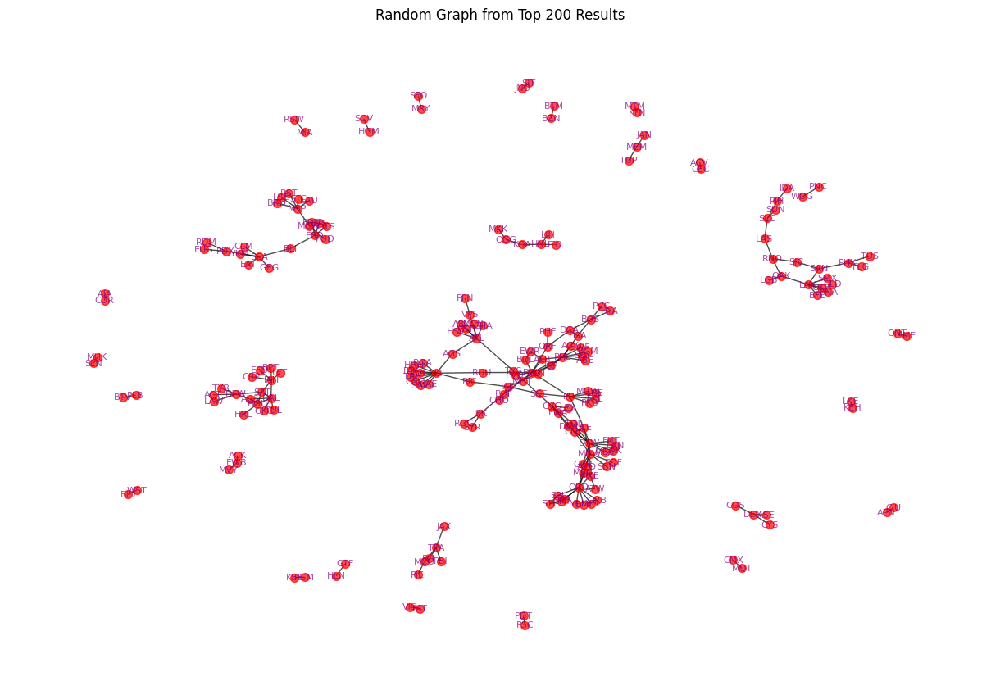

In [ ]:
import networkx as nx
import pandas as pd
import matplotlib.pyplot as plt

# Load the top 200 results data frame
#op_200_df = pd.read_csv('top_200_results.csv')

# Create a graph from the data frame
G = nx.from_pandas_edgelist(top_200_weights, 'Source', 'Target', ['Attributes'])

# Draw the graph
plt.figure(figsize=(12, 8))
pos = nx.spring_layout(G)
nx.draw(G, pos, with_labels=True, node_size=50, font_size=8, font_color='purple', node_color='red', edge_color='black', alpha=0.7, arrowsize=10)

plt.title('Random Graph from Top 200 Results')
plt.show()


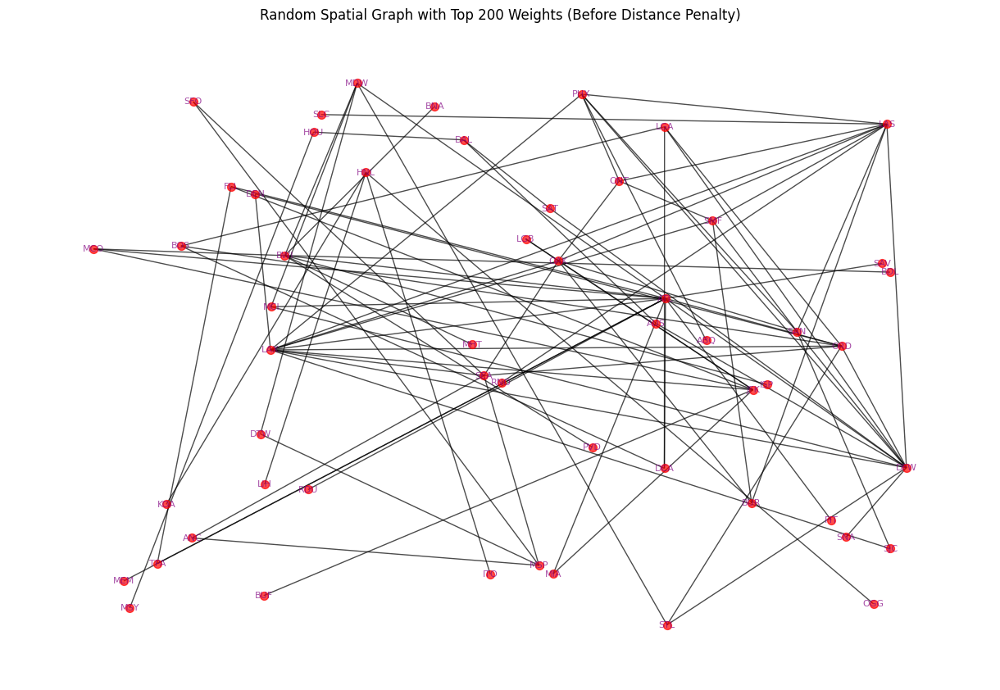

In [ ]:
import networkx as nx
import pandas as pd
import matplotlib.pyplot as plt
import random

# Assuming 'USA_flights' has columns like 'Source', 'Target', 'Weight', 'Lat_source', 'Lon_source', 'Lat_target', 'Lon_target'
# Assuming 'USA_airports' has columns like 'id', 'Lat', 'Lon', 'country'

# Load data
USA_airports = pd.read_csv('/content/drive/MyDrive/us_airports.csv')  # Update with your actual file path
USA_flights = pd.read_excel('/content/drive/MyDrive/us_flights.xlsx')  # Update with your actual file path

# Sort the flights data by weights in descending order and select top 200
top_200_weights = USA_flights.sort_values(by='Weight', ascending=False).head(200)

# Create a directed graph
G = nx.Graph()

# Add edges with weights (before distance penalty)
for index, row in top_200_weights.iterrows():
    source = row['Source']
    target = row['Target']
    weight = row['Weight']

    # Find coordinates for source and target airports
    source_coords = USA_airports.loc[USA_airports['id'] == source, ['Lat ', 'Lon']].values.flatten()
    target_coords = USA_airports.loc[USA_airports['id'] == target, ['Lat ', 'Lon']].values.flatten()

    # Assign weighted edge without distance penalty
    G.add_edge(source, target, weight=weight)

# Create random spatial layout for visualization
pos = {node: (random.uniform(-120, -70), random.uniform(25, 50)) for node in G.nodes()}

# Draw the random spatial graph
plt.figure(figsize=(12, 8))
nx.draw(G, pos, with_labels=True, node_size=50, font_size=8, font_color='purple', node_color='red', edge_color='black', alpha=0.7, arrowsize=10)

plt.title('Random Spatial Graph with Top 200 Weights (Before Distance Penalty)')
plt.show()


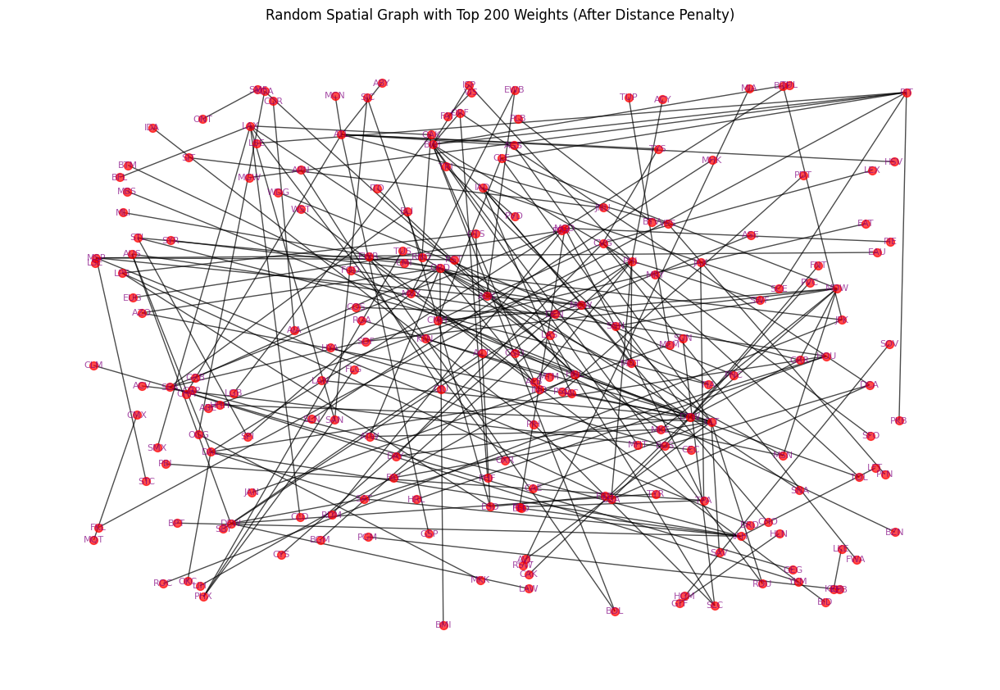

In [ ]:
import networkx as nx
import pandas as pd
import matplotlib.pyplot as plt
import random

# Load top 200 weights data
top_200_weights = pd.read_csv('/content/top_200_results.csv')  # Update with your actual file path

# Assuming 'USA_airports' has columns like 'id', 'Lat', 'Lon', 'country'
USA_airports = pd.read_csv('/content/drive/MyDrive/us_airports.csv')  # Update with your actual file path

# Create a directed graph
G = nx.Graph()

# Add edges with weights and distance penalty
for index, row in top_200_weights.iterrows():
    source = row['Source']
    target = row['Target']
    weight = row['Weights']

    # Find coordinates for source and target airports
    source_coords = USA_airports.loc[USA_airports['id'] == source, ['Lat ', 'Lon']].values.flatten().astype(float)
    target_coords = USA_airports.loc[USA_airports['id'] == target, ['Lat ', 'Lon']].values.flatten().astype(float)

    # Calculate distance penalty based on a gravitational model
    distance_penalty = 1 / ((source_coords[0] - target_coords[0]) ** 2 + (source_coords[1] - target_coords[1]) ** 2 + 1)

    # Assign weighted edge with distance penalty
    G.add_edge(source, target, weight=weight * distance_penalty)

# Create random spatial layout for visualization
pos = {node: (random.uniform(-120, -70), random.uniform(25, 50)) for node in G.nodes()}

# Draw the random spatial graph after distance penalty
plt.figure(figsize=(12, 8))
nx.draw(G, pos, with_labels=True, node_size=50, font_size=8, font_color='purple', node_color='red', edge_color='black', alpha=0.7, arrowsize=10)

plt.title('Random Spatial Graph with Top 200 Weights (After Distance Penalty)')
plt.show()


In [ ]:
top_200_df

,Source,Target,Weights
0,HNL,LIH,14913.757870
1,DTW,MBS,6020.321358
2,ORD,MKE,5442.424990
3,HOU,DAL,5233.134494
4,PHL,ABE,5162.264811
...,...,...,...
195,CMH,MDW,707.991933
196,MCO,PIE,704.142474
197,CVG,TOL,704.042594
198,MSP,LSE,701.175858


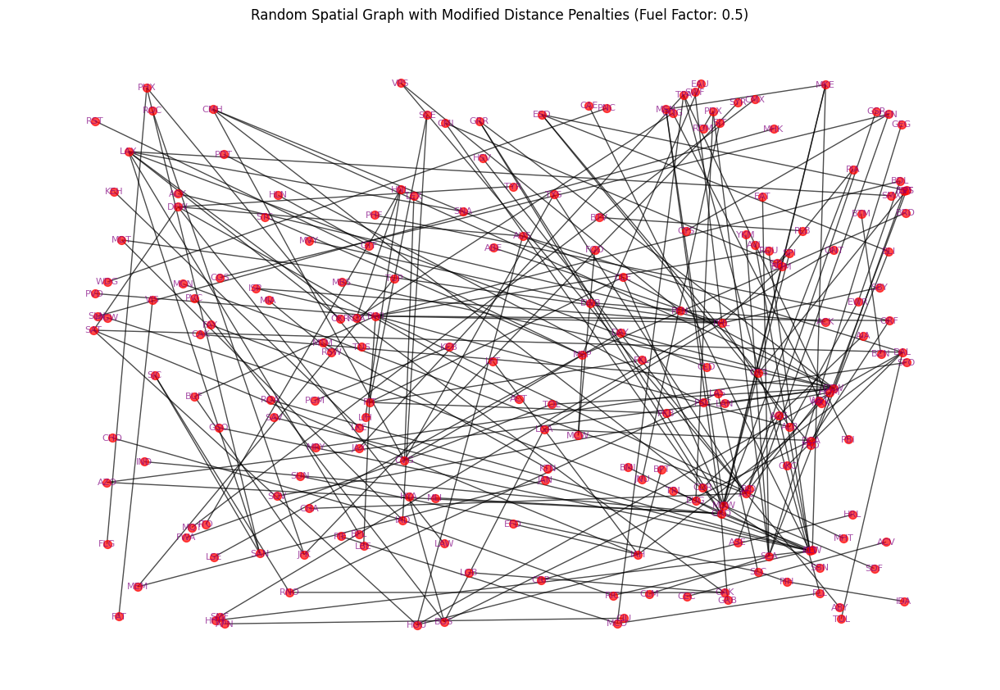

In [ ]:
import networkx as nx
import pandas as pd
import matplotlib.pyplot as plt
import random

# Load the top 200 weights after applying penalty
top_200_df = pd.read_csv('/content/drive/MyDrive/top_200_results_us.csv')  # Update with your actual file path

# Create a directed graph
G = nx.Graph()

# Add edges with original weights
for index, row in top_200_df.iterrows():
    source = row['Source']
    target = row['Target']
    original_weight = row['Weights']

    # Assign original weighted edge
    G.add_edge(source, target, weight=original_weight)

# Define the fuel cost factor
fuel_cost_factor = 0.5

# Apply distance penalty with modified fuel cost factor
for edge in G.edges(data=True):
    source = edge[0]
    target = edge[1]
    original_weight = edge[2]['weight']

    # Find coordinates for source and target airports (assuming USA_airports is loaded)
    source_coords = USA_airports.loc[USA_airports['id'] == source, ['Lat ', 'Lon']].values.flatten().astype(float)
    target_coords = USA_airports.loc[USA_airports['id'] == target, ['Lat ', 'Lon']].values.flatten().astype(float)

    # Calculate modified distance penalty based on the fuel cost factor
    modified_distance_penalty = fuel_cost_factor / ((source_coords[0] - target_coords[0]) ** 2 + (source_coords[1] - target_coords[1]) ** 2 + 1)

    # Assign weighted edge with modified distance penalty
    G[source][target]['weight'] = original_weight * modified_distance_penalty

# Create random spatial layout for visualization
pos = {node: (random.uniform(-120, -70), random.uniform(25, 50)) for node in G.nodes()}

# Draw the random spatial graph with modified distance penalties
plt.figure(figsize=(12, 8))
nx.draw(G, pos, with_labels=True, node_size=50, font_size=8, font_color='purple', node_color='red', edge_color='black', alpha=0.7, arrowsize=10)

plt.title(f'Random Spatial Graph with Modified Distance Penalties (Fuel Factor: {fuel_cost_factor})')
plt.show()


In [ ]:
import networkx as nx
import pandas as pd
import matplotlib.pyplot as plt
import random

# Load the top 200 weights after applying penalty
top_200_df = pd.read_csv('/content/drive/MyDrive/top_200_results_us.csv')  # Update with your actual file path

# Create a directed graph
G = nx.Graph()

# Add edges with original weights
for index, row in top_200_df.iterrows():
    source = row['Source']
    target = row['Target']
    original_weight = row['Weights']

    # Assign original weighted edge
    G.add_edge(source, target, weight=original_weight)

# Define the fuel cost factor
fuel_cost_factor = 0.5

# Apply distance penalty with modified fuel cost factor and store results in a new column
top_200_df['Fuel_Impact'] = 0.0  # Initialize the new column

for index, row in top_200_df.iterrows():
    source = row['Source']
    target = row['Target']
    original_weight = row['Weights']

    # Find coordinates for source and target airports (assuming USA_airports is loaded)
    source_coords = USA_airports.loc[USA_airports['id'] == source, ['Lat ', 'Lon']].values.flatten().astype(float)
    target_coords = USA_airports.loc[USA_airports['id'] == target, ['Lat ', 'Lon']].values.flatten().astype(float)

    # Calculate modified distance penalty based on the fuel cost factor
    modified_distance_penalty = fuel_cost_factor / ((source_coords[0] - target_coords[0]) ** 2 + (source_coords[1] - target_coords[1]) ** 2 + 1)

    # Assign weighted edge with modified distance penalty
    top_200_df.at[index, 'Fuel_Impact'] = original_weight * modified_distance_penalty

# Save the DataFrame to a new CSV file
top_200_df.to_csv('/content/drive/MyDrive/top_200_weights_with_fuel_impact.csv', index=False)  # Update with your desired file path

# Print a sample of the updated DataFrame
print(top_200_df.head())



  Source Target       Weights  Fuel_Impact
0    HNL    LIH  14913.757870  1991.513321
1    DTW    MBS   6020.321358  1069.783626
2    ORD    MKE   5442.424990  1400.075145
3    HOU    DAL   5233.134494   190.231291
4    PHL    ABE   5162.264811  1565.744887


In [ ]:
top_200_df.head(10)

,Source,Target,Weights,Fuel_Impact
0,HNL,LIH,14913.757870,1991.513321
1,DTW,MBS,6020.321358,1069.783626
2,ORD,MKE,5442.424990,1400.075145
3,HOU,DAL,5233.134494,190.231291
4,PHL,ABE,5162.264811,1565.744887
5,LAX,SAN,4575.770150,577.750344
6,BWI,ORF,4240.938477,331.518823
7,LAX,SNA,4217.067566,1602.131429
8,FLL,TPA,4035.151732,196.122106
9,BOS,LGA,3844.899433,163.386955
